<a href="https://colab.research.google.com/github/simon-mellergaard/RL/blob/main/Project01_solution.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Instructions

This notebook contains the first project assignment. You work on the project in groups. You should already have formed a group. If not, do it on Brightspace under *My Courses > Groups*. To get started, do the following steps:

1) One student in the group makes a copy of this notebook.
2) Share it with your group using *Share* top-right. Here, add group members under people with access.
3) Moreover, under *Share > General access*, choose *Anyone with the link > Commenter*. Copy this link and paste it below.
4) Work with the notebook and solve the tasks.
5) Hand in the notebook by downloading it: File > Download > Download .ipynb. Next, on BS under *Project*, upload the file (I need that for the exam). Moreover, add the shared link of your Colab notebook as a link when you handin too.
6) After hand-in do peer grading (see BS under *Project*)

Sharing link: [add your link]

**Deadlines**

* Group signup 29/09/25
* Hand-in solution 5/10/25
* Peer grading 10/10/25


# Notebook pre steps

In [ ]:
#@title Installations

# ALWAYS SAVE YOUR OWN COPY OF THIS NOTEBOOK: File > Save a copy in Drive
# IF DANISH MENU DO: Hjælp > Engelsk version

# To clear output do: Edit > Clear all outputs

## Useful shortscuts
# Run current cell: Cmd+Enter
# Run current cell and goto next: Shift+Enter
# Run selection: Cmd+Shift+Enter

# install missing packages
# !pip install pymdptoolbox
!pip install dfply
import numpy as np
from pprint import pprint
import pandas as pd
from plotnine import *
import joblib
import gzip
import gdown
import warnings
from scipy.stats import norm
from dfply import *
import itertools
from IPython.display import Markdown

In [ ]:
#@title MDP class

import random
from collections import defaultdict
import numpy as np
import pandas as pd

class MDP:
    """
    A class representing a Markov Decision Process (MDP) using defaultdict structures.

    This implementation includes state management, action specification, transition
    probabilities, rewards, policies, and iterative algorithms for policy and value iteration.
    """

    def __init__(self):
        """
        Initializes an empty MDP with model and state values.
        """
        self.model = defaultdict(lambda: {"pi": None, "actions": defaultdict(dict)})
        self.v = defaultdict(float)

    def add_state_space(self, states):
        """
        Adds states to the MDP.

        Args:
            states (list): List of state identifiers (strings or convertible to strings).
        """
        for state in states:
            _ = self.model[str(state)]
        self.set_state_value()

    def add_action_space(self, state_str, actions):
        """
        Adds actions to a given state. Note you have to update the action
        afterwards using `add_action`.

        Args:
            state_str (str): The state identifier.
            actions (list): List of action identifiers.
        """
        if not isinstance(state_str, str):
            raise ValueError("State is not a sting!")
        if isinstance(actions, str):
            # If it's a string, put it in a list to treat it as a single item
            actions = [actions]
        for action in actions:
            # Initialize the action dictionary with 'pr' and 'r' keys
            self.model[state_str]["actions"][str(action)] = {"pr": {}, "r": None}

    def add_action(self, state_str, action_str, reward, pr):
        """
        Adds a transition action with reward and transition probabilities.

        Args:
            state_str (str): State from which the action is taken.
            action_str (str): Action identifier.
            reward (float): Expected reward for taking the action.
            pr (dict): Transition probabilities as {next_state: probability}.
        """
        ## remove keys with zero trans pr
        keys_to_remove = [key for key, value in pr.items() if value == 0]
        for key in keys_to_remove:
            del pr[key]
        self.model[state_str]["actions"][action_str] = {"r": reward, "pr": pr}

    def check(self, delta = 10*np.spacing(np.float64(1))):
        """
        Performs checks on the built MDP model.

        Verifies that transition probabilities sum to approximately 1.0 for each
        state-action pair and checks for rewards less than the high_neg_reward.
        Prints warnings if any issues are found.

        Args:
            delta (float, optional): Tolerance for the sum of transition probabilities. Defaults to 1e-10.
        """
        ok = True
        # Check if transition pr of an action sum to one
        for state_label, state_content in self.model.items():
            for action_label, action_content in state_content["actions"].items():
                pr = action_content["pr"]
                pr_sum = np.sum(list(pr.values()))
                absdiff = np.abs(1-pr_sum)
                if absdiff >= delta:
                    print(f"Warning: Transition probabilities for action '{action_label}' in state '{state_label}' do not sum to 1.0. Diff is: {absdiff}")
                    ok = False

        # Check if there are states with no actions
        for state_label, state_content in self.model.items():
            if len(state_content["actions"]) == 0:
                print(f"Warning: State '{state_label}' has no actions.")
                ok = False

        # Check if all action transitions are to a state
        states = list(self.model.keys())
        for state_label, state_content in self.model.items():
            for action_label, action_content in state_content["actions"].items():
                if not all(key in self.model for key in action_content['pr'].keys()):
                    print(f"Warning: Action '{action_label}' in state '{state_label}' has a transition to a non-existing state.")
                    ok = False
        if ok:
            print("All checks passed!")


    def normalize(self):
        """
        Normalizes the transition probabilities for each state-action pair.
        """
        for state_label, state_content in self.model.items():
            for action_label, action_content in state_content["actions"].items():
                pr = action_content["pr"]
                pr_sum = np.sum(list(pr.values()))
                for next_state_label, prob in pr.items():
                    pr[next_state_label] = prob / pr_sum
                action_content["pr"] = pr

    def set_state_value(self, states=None, value=0):
        """
        Initializes or updates the value of states.

        Args:
            states (list, optional): List of state identifiers. Defaults to all states.
            value (float, optional): Value to assign. Defaults to 0.
        """
        states = states or list(self.model.keys())
        for state in states:
            self.v[state] = value

    def set_random_deterministic_policy(self):
        """
        Sets a random deterministic policy for each state.
        """
        for state in self.model:
            actions = list(self.model[state]["actions"].keys())
            if actions:
                chosen_action = random.choice(actions)
                self.model[state]["pi"] = {chosen_action: 1}

    def set_deterministic_policy(self, state_actions):
        """
        Sets a deterministic policy from a state-action mapping.

        Args:
            state_actions (dict): Mapping {state: action}.
        """
        for state, action in state_actions.items():
            self.model[state]["pi"] = {action: 1}

    def set_policy(self, states, pi):
        """
        Sets a stochastic or deterministic policy for a list of states.

        Args:
            states (list): List of states to assign the policy.
            pi (dict): Policy as {action: probability}.
        """
        for state in states:
            self.model[state]["pi"] = pi.copy()

    def get_state_keys(self):
        """
        Returns the list of state identifiers.

        Returns:
            list: List of state keys.
        """
        return list(self.model.keys())

    def get_action_keys(self, state):
        """
        Returns the action identifiers for a given state.

        Args:
            state (str): State identifier.

        Returns:
            list: List of action keys.
        """
        return list(self.model[state]["actions"].keys())

    def get_action_info(self, state):
        """
        Gets reward and transition probabilities for each action in a state.

        Args:
            state (str): State identifier.

        Returns:
            dict: Action information.
        """
        return dict(self.model[state]["actions"])

    def get_reward(self, state, action):
        """
        Returns the reward for a given state-action pair.

        Args:
            state (str): State identifier.
            action (str): Action identifier.

        Returns:
            float: Reward value.
        """
        return self.model[state]["actions"][action]["r"]

    def get_mdp_info(self):
        """
        Returns information about the MDP.

        Returns:
            dict: The info.
        """
        res = {}
        res["states"] = len(self.model)
        res["actions"] = sum([len(self.model[k]["actions"]) for k in self.model.keys()])
        return res

    def get_policy(self, add_state_values = False):
        """
        Retrieves the current policy.

        Returns:
            pd.DataFrame: Table of state, action, and probability.
        """
        policy = []
        for state in self.get_state_keys():
            for action, prob in self.model[state]["pi"].items():
                if not add_state_values:
                    policy.append({"state": state, "action": action, "pr": prob})
                else:
                    policy.append({"state": state, "action": action, "pr": prob, "v": self.v[state]})
        df = pd.DataFrame(policy)
        df.set_index("state")
        return df

    def get_state_values(self, states=None):
        """
        Returns the current value of each state.

        Args:
            states (list, optional): Subset of states. Defaults to all.

        Returns:
            pd.DataFrame: Table of state values.
        """
        states = states or list(self.v.keys())
        return pd.DataFrame([{"state": s, "v": self.v[s]} for s in states])

    def get_mdp_matrices(self, high_neg_reward = -100000):
        """
        Returns transition probability and reward matrices.

        Returns:
            tuple: A tuple containing:
                p_mat (list): List of transition probability matrices.
                r_mat (ndarray): Reward matrix.
                states (list): List of state identifiers.
                actions (list): List of action identifiers.
        """
        states = self.get_state_keys()
        actions = set(
            action for state in states for action in self.get_action_keys(state)
        )
        actions = list(actions)
        actions.sort()
        p_mat = [pd.DataFrame(0.0, index=states, columns=states) for _ in actions]
        for df in p_mat:
            np.fill_diagonal(df.values, 1) # set default to transition to same state (so illigal actions work)
        r_mat = pd.DataFrame(high_neg_reward, index=states, columns=actions)
        for state in states:
            for action in self.get_action_keys(state):
                p_mat[actions.index(action)].at[state, state] = 0  # reset to 0 again (since action is not illigal)
                pr = self.model[state]["actions"][action]["pr"]
                r = self.model[state]["actions"][action]["r"]
                r_mat.at[state, action] = r
                for next_state, prob in pr.items():
                    p_mat[actions.index(action)].at[state, next_state] = prob
        p_mat = [m.to_numpy() for m in p_mat]  # convert to matrices
        r_mat = r_mat.to_numpy()
        return p_mat, r_mat, states, actions

    def bellman_calc(self, gamma, state, action):
        """
        Computes Bellman update for a given state-action pair.

        Args:
            gamma (float): Discount factor.
            state (str): State identifier.
            action (str): Action identifier.

        Returns:
            float: Updated value.
        """
        pr = self.model[state]["actions"][action]["pr"]
        reward = self.model[state]["actions"][action]["r"]
        return reward + gamma * sum(pr[s] * self.v[s] for s in pr)

    def policy_eval(self, gamma, theta=1e-5, max_iter=10000, reset=True):
        """
        Iteratively evaluates the current policy.

        Args:
            gamma (float): Discount factor.
            theta (float): Convergence threshold.
            max_iter (int): Max iterations.
            reset (bool): Whether to reset state values to 0.
        """
        if reset:
            self.set_state_value()
        for _ in range(max_iter):
            delta = 0
            for state in self.model:
                v_old = self.v[state]
                pi = self.model[state]["pi"]
                value = sum(pi[a] * self.bellman_calc(gamma, state, a) for a in pi)
                self.v[state] = value
                delta = max(delta, abs(v_old - value))
            if delta < theta:
                break
        else:
            print(f"Policy evaluation stopped at max iterations: {max_iter}")

    def policy_iteration(self, gamma, theta=1e-5, max_iter_eval=10000, max_iter_policy=100):
        """
        Performs policy iteration with evaluation and improvement steps.

        Args:
            gamma (float): Discount factor.
            theta (float): Convergence threshold.
            max_iter_eval (int): Max iterations during policy evaluation.
            max_iter_policy (int): Max policy improvement steps.
        """
        self.set_random_deterministic_policy()
        for i in range(max_iter_policy):
            self.policy_eval(gamma, theta, max_iter_eval, reset=False)
            stable = True
            for state in self.model:
                old_action = next(iter(self.model[state]["pi"]))
                best_val, best_action = float("-inf"), None
                for action in self.get_action_keys(state):
                    val = self.bellman_calc(gamma, state, action)
                    if val > best_val:
                        best_val = val
                        best_action = action
                self.model[state]["pi"] = {best_action: 1}
                if best_action != old_action:
                    stable = False
            if stable:
                break
        else:
            print(f"Policy iteration stopped at max iterations: {max_iter_policy}")
        print(f"Policy iteration finished in {i + 1} iterations.")

    def value_iteration(self, gamma, theta=1e-5, max_iter=10000, reset=True):
        """
        Performs value iteration algorithm.

        Args:
            gamma (float): Discount factor.
            theta (float): Convergence threshold.
            max_iter (int): Max number of iterations.
            reset (bool): Whether to reinitialize state values.
        """
        self.set_random_deterministic_policy()
        if reset:
            self.set_state_value()
        for i in range(max_iter):
            delta = 0
            for state in self.model:
                v_old = self.v[state]
                best_val, best_action = float("-inf"), None
                for action in self.get_action_keys(state):
                    val = self.bellman_calc(gamma, state, action)
                    if val > best_val:
                        best_val = val
                        best_action = action
                self.v[state] = best_val
                self.model[state]["pi"] = {best_action: 1}
                delta = max(delta, abs(v_old - best_val))
            if delta < theta:
                break
        else:
            print(f"Value iteration stopped at max iterations: {max_iter}")
        print(f"Value iteration finished in {i + 1} iterations.")

    def get_steady_state_pr(self, as_dataframe = True, tol=1e-8):
        """
        Calculates the steady-state probabilities for the MDP under the optimal policy.

        Args:
            as_dataframe (bool): Whether to return the result as a DataFrame, or otherwise as an array.

        Returns:
            if as_dataframe:
                pd.DataFrame: A DataFrame with states and their steady-state probabilities.
            else:
                ndarray: An array of steady-state probabilities.
        """
        state_labels_to_index = {label: index for index, label in enumerate(self.get_state_keys())}
        num_states = len(state_labels_to_index)
        transition_matrix = np.zeros((num_states, num_states))
        policy = self.get_policy()
        policy['s_idx'] = policy['state'].map(state_labels_to_index)
        policy = policy.set_index(['s_idx', 'action'])
        # calc transition matrix
        for s_label in self.get_state_keys():
            s_idx = state_labels_to_index[s_label]
            action_rows = policy.loc[s_idx]
            for action, row in action_rows.iterrows():
                pi = row['pr']
                a = self.model[s_label]['actions'][action]
                for s_next_label, prob in a['pr'].items():
                    s_next_idx = state_labels_to_index[s_next_label]
                    transition_matrix[s_idx, s_next_idx] += prob * pi

        transition_matrix.sum(axis=1)

        ## calc steady state pr
        # # alternative 1
        # eigenvalues, left_eigenvectors = np.linalg.eig(transition_matrix.T)
        # # Find the eigenvalue closest to 1
        # closest_eigenvalue_index = np.abs(eigenvalues - 1).argmin()
        # # Extract the corresponding left eigenvector
        # steady_state_vector = left_eigenvectors[:, closest_eigenvalue_index]
        # # Ensure the eigenvector contains real values and take the real part
        # steady_state_vector = np.real(steady_state_vector)
        # # Normalize the vector to sum to 1
        # steady_state_vector = steady_state_vector / np.sum(steady_state_vector)
        # # Handle potential negative values due to numerical precision by taking absolute value
        # steady_state_vector = np.abs(steady_state_vector)
        # steady_state_vector = steady_state_vector / np.sum(steady_state_vector)
        # # Verify that the sum of the steady-state probabilities is approximately 1
        # print("Sum of steady-state probabilities:", np.sum(steady_state_vector))
        # # Verify that all probabilities are non-negative
        # print("Minimum steady-state probability:", np.min(steady_state_vector))
        # steady = steady_state_vector

        # Alternative 2
        eigvals, eigvecs = np.linalg.eig(transition_matrix.T)
        steady = np.real(eigvecs[:, np.isclose(eigvals, 1)])
        steady = steady[:,0]
        sum(steady)
        steady = steady/steady.sum()

        # # Alternative 3 (slow)
        # # Solve (P^T - I) d^T = 0 with sum(d)=1 by replacing one equation with the normalization
        # A = transition_matrix.T - np.eye(num_states)
        # b = np.zeros(num_states)
        # A[-1, :] = 1.0
        # b[-1] = 1.0
        # # Least-squares for robustness
        # d, *_ = np.linalg.lstsq(A, b, rcond=None)
        # # Clean numerical noise
        # d = np.maximum(d, 0)
        # d = d / d.sum()

        # abs(steady - steady_state_vector) < 0.00000001
        # abs(d - steady_state_vector) < 0.00000001
        # abs(steady - d) < 0.00000001

        if abs(sum(steady) - 1) > tol:
            raise ValueError("Steady state probabilities do not sum to 1.")

        if as_dataframe:
            policy.reset_index(inplace=True)
            policy['steady_pr'] = [steady[s_idx] for s_idx in policy['s_idx']]
            return policy
        else:
            return steady

# self = mdp
# mdp.get_mdp_info()

# Hour-to-hour electricity market problem

We consider an energy producer operating on an hour-to-hour electricity
market (external power grid), which has a wind power plant and a battery available.

The producer can every hour.

- generate energy from the wind power plant or the battery
- store energy by charging the battery.

Given the current hour, the producer has to fulfil a given commitment on a production level to the external grid. Since the generated power from wind is uncertain the producer may not be able to meet the commitment by wind production. Thus, it may be a good idea to have some level of energy stored on the battery. If the producer does not manage to meet the commitment, it is faced
with a penalty cost which may depend on the level of deviation to commitment. Deviation might occur if wind speed is less than expected or if there is a shortage of required energy in the battery.

Although the circumstances on the market might make it favourable the deviate from the commitments, we will assume that this is not allowed. Consequently, the producer has to utilize its available energy sources to meet commitments as close as possible.

The producer also has to choose a commitment level for the forthcomming hour. The producers choice of commitment level depends on the level of energy storaged on the battery, the level of possible wind energy production from the plant and the electricity spot prices.

The sequential decision problem is to find a plan for choosing commitment levels that maximizes the expected profit.

## Problem parameters and relations

Let us assume the following parameters:

- $b^\max$ Maximum capacity of the battery (MWh).
- $p^{\max}$ Maximum power of the wind turbine (MW).
- $c^+$ Imbalance unit penalty cost when the electricity price is positive (EUR/MWh).
- $c^-$ Imbalance unit penalty cost when the electricity price is negative (EUR/MWh).
- Given wind speed $x$ the energy produced within a time period is $E(x)$  (MWh).

## State and action space

We can model the sequential decision problem as an MDP. First, let us define the state space for a given period $t$. Let

- $s^l_t$ be the level of energy storaged on the battery at period $t$ (MWh).
- $s^c_t$ be the commitment level for period $t$ (MWh). Note if negative we buy energy from the grid.
- $s^w_t$ is the expected wind speed (m/s),
- $s^p_t$ is the electricity spot prices in period $t$ (EUR). Note may be negative.

<!-- Then the state space of the MDP is $S = L \times C \times W \times P$. -->
Note that

- $s^l_t$ and $s^c_t$ are endogenous variables. That is, the transition over time depends on the actions of the producer.
- $s^w_t$ and $s^p_t$ are exogenous variables, i.e. they are governed by dynamics that do not depend on the endogenous variables.

Next, consider the set of possible actions. Let

- $a^c_t$ be the chosen commitment level for period $t+1$ (MWh).
- $a^b_t$ is chosen level of energy discharged from the battery in period $t$ to the grid (MWh). Note if negative we choose to charge the battery.
- $a^w_t$ is the chosen amount of generated wind energy from the wind power plant (MWh).

<!-- Then $A=C \times B \times W$ is the action space. -->

<!-- Assume that every variable and action is a real number taking only values on a bounded interval of the real line. -->

### State transitions

The dynamics of the stochastic processes are assumed to be known (the transitions probabilities). First, since $s^c_t$ is the current commitment level then for the next period, we have $$s^c_{t+1}=a^c_t.$$

Next, the level of the battery is $$s^l_{t+1}=s^l_t - a^b_t.$$

Finally, the exogenous variables are goverend by two stochastic functions

$$s^w_{t+1}=W(s^w_t),$$

$$s^p_{t+1}=G(s^p_t).$$

<!-- That is the the level of wind in period $t+1$ only depends on the level of wind in period $t$, and the dynamics behave according to a Markovian transition kernel.  -->

### Predetermined actions

We assume that the producer has to utilise its available energy sources to meet commitments as closely as possible. Hence, the producer must follow the rules:

1. First, fulfil commitment as much as possible from wind.
2. Next, if any excess energy from wind charge the battery.
3. Otherwise, try to filfil the remaining commitment by discharging the battery.

For simplicity, let us assume no efficiency loss when energy is transfered.

Hence, after observing the state variables $s^l_t,s^c_t,s^w_t$ and $s^p_t$, the actions $a^w_t$ and $a^b_t$ are given immediately from the state. That is, both actions are found given the state and should not be optimized. However, the optimal commitment level $a^c_t$ should be optimized. Below we give descriptions of $a^w_t$ and $a^b_t$.

**If commitment is positive**

Then we send energy to the grid and may use the battery.

- If the commitment is greater than or equal to the possible energy from wind, then use all the wind

  $$a^w_t = E(s^w_t) \text{ if } s^c_t \geq 0, s^c_t \geq E(s^w_t).$$

  Moreover, we discharge the battery, either fully or with the remaining energy needed ($s^c_t-E(s^w_t)$)

$$a^b_t = \min\{s^l_t, s^c_t-E(s^w_t) \} \text{ if } s^c_t \geq 0, s^c_t \geq E(s^w_t).$$

- If the commitment is less than the possible energy from wind. Then we charge the battery, which can receive either remaining energy $E(s^w_t)-s^c_t$, or the energy needed to fully charge the battery $b^\max-s^l_t$. That is,

  $$a^b_t = - \min\{b^\max-s^l_t, E(s^w_t)-s^c_t\}, \text{ if } s^c_t \geq 0, s^c_t < E(s^w_t),$$

  and the amount of wind used is

  $$a^w_t = s^c_t - a^b_t, \text{ if } s^c_t \geq 0, s^c_t < E(s^w_t).$$

**If commitment is negative**

Then we transfer from the grid and we charge the battery with energy from the grid (as much as possible) and use wind to add more energy to the battery if possible. That is, we assume that we first use energy from the grid (so do not to get a penalty) and then wind.

$$a^b_t = - \min\{b^\max-s^l_t, - s^c_t + E(s^w_t)\} \text{ if } s^c_t < 0$$

$$a^w_t = \max\{0, - a^b_t + s^c_t\} \text{ if } s^c_t < 0$$

## Reward

The the amount of electricity delivered to the grid from the producer in period $t$ is $e_t = a^b_t + a^w_t$. The reward by being in state $s = (s^l_t,s^c_t,s^w_t,s^p_t)$ and chosing action $a = (a^c_t, a^b_t, a^w_t)$ is then

\begin{align}
    R(s,a) &= R(s^l_t,s^c_t,s^w_t,s^p_t, a^b_t, a^b_t, a^w_t) \\
    &= R(s^c_t, s^p_t, e_t) \\
    &= \begin{cases}
        s^c_ts^p_t - c^+ |s^c_t-e_t| &\text{if }s^p_t \geq 0\\
        s^c_ts^p_t - c^- |s^c_t-e_t| &\text{if }s^p_t<0
       \end{cases}
\end{align}

where $c^+$ and $c^-$ are imbalance prices, i.e. a penalty price if the producer does not meet its commitments to the market.

For each period $t$, the producer first observes the state variables $(s^l_t,s^c_t,s^w_t,s^p_t)$ and then decides on a commitment level for the next period $a^c_t$ and an amount of energy actually to deliver to the market $e_t$. Finally, the reward $R(s^c_t,s^p_t,e_t)$ is received.

## Transition probabilities

The transition probabilities can be split since the stochastic processes are independent:

\begin{align}
    p(s_{t+1} | s_t, a_t) &= p( s^l_{t+1},s^c_{t+1},s^w_{t+1},s^p_{t+1} | s^l_t,s^c_t,s^w_t,s^p_t, a^c_t, a^b_t, a^w_t) \\
        &= p(s^w_{t+1} | s^w_t)
           p(s^p_{t+1} | s^p_t)
           p( s^l_{t+1} | s^l_t, a^c_t, a^b_t, a^w_t)
           p( s^c_{t+1} | s^c_t, a^c_t, a^b_t, a^w_t) \\
        &= p(s^w_{t+1} | s^w_t)
           p(s^p_{t+1} | s^p_t)
           p( s^l_{t+1} | s^l_t, a^b_t)
           p( s^c_{t+1} | a^c_t) \\
\end{align}

Here $p(s^w_{t+1} | s^w_t)$ and $p(s^p_{t+1} | s^p_t)$ are calculated using the distributions for $W$ and $G$, respectively. Transitions for $s^l_{t}$ and $s^c_{t}$ are deterministic. That is, $p( s^l_{t+1} | s^l_t, a^b_t) = 1$ if $s^l_{t+1} = s^l_t - a^b_t$ and zero otherwise. Similar $p( s^c_{t+1} | a^c_t) = 1$ if $s^c_{t+1} = a^c_t$ and zero otherwise. Note that, no probabilities depend on $a^w_t$ and hence not needed to calculate the transition probabilities. Hence

\begin{align}
    p(s_{t+1} | s_t, a_t) = p(s^w_{t+1} | s^w_t)
           p(s^p_{t+1} | s^p_t)
\end{align}

if $s^l_{t+1} = s^l_t - a^b_t$ and $s^c_{t+1} = a^c_t$ and zero otherwise.

## Function $E(x)$

To calculate the energy used during af tieme period, first recall that the unit megawatt (MW) is a measure of power, not energy. Power refers to the rate at which energy is produced or consumed, while energy is the total amount of power used or generated over time. Here we measure power in MW and energy in MWh.
Given the expected wind speed (m/s), the expected maximal amount of power (MW) that the wind power plant can generate:

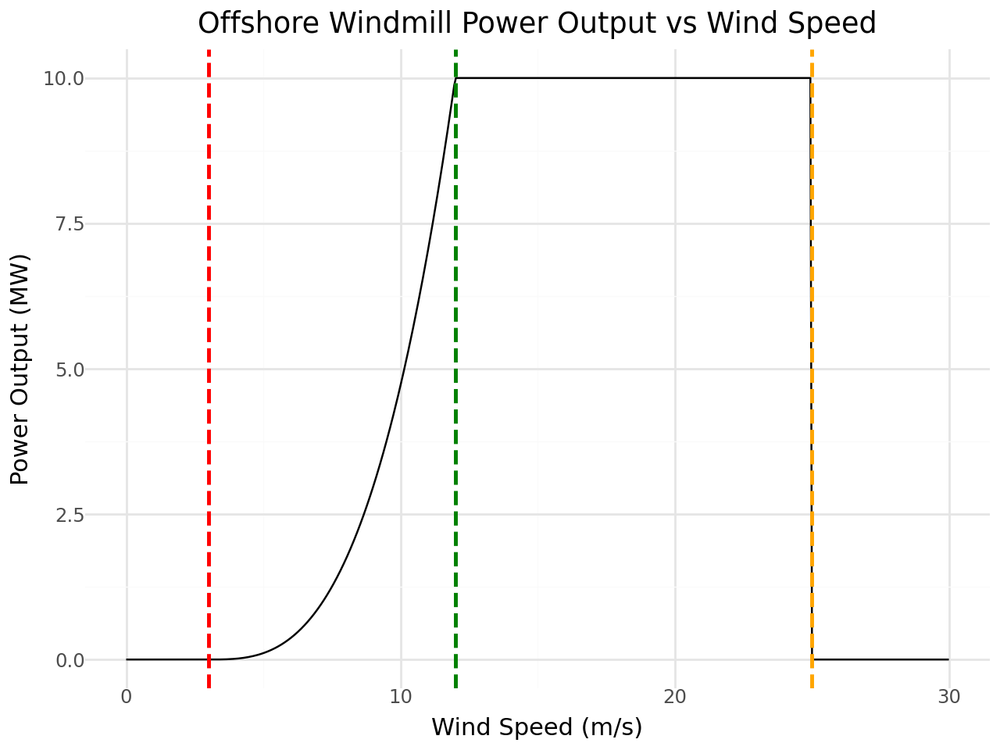

In [ ]:
def power(wind_speed, p_max=10, w_cut_in=3, w_rated=12, w_cut_out=25):
    """
    The power output of a wind turbine given a wind speed.

    Parameters:
    - wind_speed (float): The wind speed (in meters per second, m/s).
    - p_max (float, optional): The rated power of the wind turbine (in megawatts, MW). Default is 10 MW.
    - w_cut_in (float, optional): The cut-in wind speed (in meters per second, m/s). Default is 3 m/s.
    - w_rated (float, optional): The rated wind speed (in meters per second, m/s). Default is 12 m/s.
    - w_cut_out (float, optional): The cut-out wind speed (in meters per second, m/s). Default is 25 m/s.

    Returns:
    - float: The estimated power output (in megawatts, MW) based on the given wind speed.
    """
    if wind_speed < w_cut_in:
        return 0
    elif w_cut_in <= wind_speed <= w_rated:
        return p_max * ((wind_speed - w_cut_in) / (w_rated - w_cut_in)) ** 3
    elif w_rated < wind_speed <= w_cut_out:
        return p_max
    else:
        return 0

# Create a range of wind speeds for plotting
wind_speeds = np.linspace(0, 30, 500)

# Calculate the corresponding power outputs for the offshore windmill
power_outputs_offshore = [power(ws) for ws in wind_speeds]

# Create a DataFrame for plotnine
df = pd.DataFrame({
    'wind_speed': wind_speeds,
    'power_output': power_outputs_offshore
})

# Generate the plot using plotnine
w_cut_in_offshore = 3
w_rated_offshore = 12
w_cut_out_offshore = 25
p_max_offshore = 10
plot = (ggplot(df, aes(x='wind_speed', y='power_output'))
        + geom_line()
        + geom_vline(xintercept=w_cut_in_offshore, color='red', linetype='dashed', size=1, show_legend=True)
        + geom_vline(xintercept=w_rated_offshore, color='green', linetype='dashed', size=1, show_legend=True)
        + geom_vline(xintercept=w_cut_out_offshore, color='orange', linetype='dashed', size=1, show_legend=True)
        + labs(title='Offshore Windmill Power Output vs Wind Speed',
               x='Wind Speed (m/s)',
               y='Power Output (MW)')
        + theme_minimal()
        + scale_x_continuous(limits=(0, 30))
        + scale_y_continuous(limits=(0, p_max_offshore))
)
plot.show()

The power curve of a wind turbine describes how its power output varies with wind speed. Here's how it's created:

   * Cut-in Wind Speed: The minimum wind speed at which the turbine starts generating power.
   * Rated Wind Speed: The wind speed at which the turbine generates its maximum rated power.
   * Cut-out Wind Speed: The wind speed at which the turbine stops generating power for safety reasons (shut down).
   * Rated Power: The maximum power the turbine can produce when operating at the rated wind speed.

The calculation is as follows:

   * Below Cut-in Speed: If the wind speed is below the cut-in speed, the turbine produces no power (0 kW).
   * Between Cut-in and Rated Speed: As the wind speed increases, the turbine's power output increases non-linearly. This relationship is often modeled using a cubic function to simulate real-world turbine behavior.
   * At Rated Speed: When the wind speed reaches the rated speed, the turbine produces its maximum power and stays at this constant value for higher wind speeds.
   * Above Cut-out Speed: If the wind speed exceeds the cut-out speed, the turbine shuts down to prevent damage and produces no power.

Note that if the period we consider is one hour, the energy produced is equal to the power times one, i.e. MW equals MWh.



In [ ]:
from scipy.optimize import root_scalar

def energy(w, time_period_length = 1, p_max=10, w_cut_in=3, w_rated=12, w_cut_out=25):
    """
    The energy output of a wind turbine over one hour given a wind speed (MWh).

    Args:
    - w (float): The wind speed (in meters per second, m/s).
    - time_period_length (float, optional): The length of the time period (in hours). Default is 1 hour.

    returns:
    - (float) The energy produced.
    """
    return power(w, p_max, w_cut_in, w_rated, w_cut_out) * time_period_length

def energy_inverse(energy_target, time_period_length = 1, p_max=10, w_cut_in=3, w_rated=12, w_cut_out=25):
    """
    Find the wind speed that produces a given amount of energy, assuming wind is between w_cut_in and w_rated.

    Args:
        energy_target (float): The amount of energy to produce.

    Returns:
        float: The wind speed that produces the specified amount of energy.
    """
    if energy_target < 0 or energy_target > p_max:
        return None
    # if energy_target <= w_cut_in or energy_target >= w_cut_out:
    #     return 0
    # if energy_target >= w_rated:
    #     return p_max
    # Define a function representing the equation energy(w) - target_energy = 0
    def find_wind_speed(w):
        return energy(w, time_period_length, p_max, w_cut_in, w_rated, w_cut_out) - energy_target

    # Use fsolve to find the root (the wind speed)
    # Provide an initial guess for the wind speed (e.g., 10 m/s)

    sol = root_scalar(find_wind_speed, bracket=[w_cut_in, w_rated], method='brentq')
    return sol.root if sol.converged else None

    # initial_guess = 5
    # wind_speed_at_target_energy = fsolve(find_wind_speed, initial_guess)
    # if wind_speed_at_target_energy[0] < w_cut_in:
    #     return w_cut_in
    # if wind_speed_at_target_energy[0] > w_rated:
    #     return w_rated
    # return wind_speed_at_target_energy[0]

# Testing and verify the result
target = 8 # MWh
wind = energy_inverse(target)
display(Markdown(f"""
The wind speed required to produce {target} MWh of energy is approximately: {wind:.2f} m/s.\n
Energy produced at {wind:.2f} m/s: {energy(wind):.2f} MWh
"""))


The wind speed required to produce 8 MWh of energy is approximately: 11.35 m/s.

Energy produced at 11.35 m/s: 8.00 MWh


## Functions G and W

The functions for the endogeneous variables, are based on historical data and estimated using forecasting models.

### Price function $G(p)$

The model is fitted using an AR(1) model and can be loaded using:

In [ ]:
# Google Drive direct download URL (using the 'uc?id=' format)
url = 'https://drive.google.com/uc?id=1cGhte06iiWZnaRLPyj5D8ZzWX7gqPsIR'

# Output filename for the downloaded file
output_filename = 'prices_ar1.pkl.gz'

# Download the file from Google Drive
gdown.download(url, output_filename, quiet=True)

# Load the model from the downloaded file
with gzip.open(output_filename, "rb") as f:
    model_price = joblib.load(f)

display(Markdown(f"Model loaded successfully from {output_filename}"))

Model loaded successfully from prices_ar1.pkl.gz

We can now predict the price given hour, day and month:

In [ ]:
# Example
price = 100
phi = model_price.params.iloc[1]      # lag coefficient
intercept = model_price.params.iloc[0]    # intercept
price_next = intercept + phi * price
display(Markdown(f"""
Latest price: {price:.2f} EUR.\n
Predicted (mean) next hour price: {price_next:.2f} EUR
"""))


Latest price: 100.00 EUR.

Predicted (mean) next hour price: 98.21 EUR


 Moreover, the probability that the price falls within a given interval given current price is within an interval:

In [ ]:
import numpy as np
from scipy.stats import norm
from scipy.integrate import quad

def get_price_pr_inv(model, a, b, c, d):
    """
    Compute the conditional probability that P_{t+1} ∈ [a, b] given P_t ∈ [c, d]
    for a stationary AR(1) process with intercept.

    AR(1) Model:
        P_{t+1} = alpha + phi * P_t + epsilon_t
        where epsilon_t ~ N(0, sigma^2)

    Stationarity:
        The AR(1) process is considered stationary if the autoregressive coefficient satisfies:
            |phi| < 1

        Under stationarity:
            - The mean of W_t is constant over time: E[W_t] = mu = alpha / (1 - phi)
            - The variance of W_t is constant: Var(W_t) = sigma^2 / (1 - phi^2)
            - The process fluctuates around a stable long-term mean rather than trending or diverging

    Parameters:
        phi (float): AR(1) coefficient (must satisfy |phi| < 1 for stationarity)
        alpha (float): Intercept term in the AR(1) model
        sigma (float): Standard deviation of the noise term epsilon_t
        a (float): Lower bound of target interval for W_{t+1}
        b (float): Upper bound of target interval for W_{t+1}
        c (float): Lower bound of conditioning interval for W_t
        d (float): Upper bound of conditioning interval for W_t

    Returns:
        float: Conditional probability P(a ≤ W_{t+1} ≤ b | c ≤ W_t ≤ d)
    """
    phi = model.params.iloc[1]      # lag coefficient
    alpha = model.params.iloc[0]    # intercept
    sigma = model.resid.std()   # residual standard deviation

    # Long-run mean and stationary variance
    mu = alpha / (1 - phi)
    sigma_w = sigma / np.sqrt(1 - phi**2)

    def marginal_pdf_w(w):
        """PDF of stationary W_t ~ N(mu, sigma_w^2)."""
        return norm.pdf(w, loc=mu, scale=sigma_w)

    def integrand(w):
        """Integrand: conditional probability * marginal density."""
        mean_t1 = alpha + phi * w
        p = norm.cdf(b, loc=mean_t1, scale=sigma) - norm.cdf(a, loc=mean_t1, scale=sigma)
        return p * marginal_pdf_w(w)

    # Marginal probability P(c ≤ W_t ≤ d)
    p_wt_interval = norm.cdf(d, loc=mu, scale=sigma_w) - norm.cdf(c, loc=mu, scale=sigma_w)

    # Numerical integration over W_t in [c, d]
    integral_result, _ = quad(integrand, c, d)

    return integral_result / p_wt_interval

display(Markdown(f"""
Prob. of P_t+1 ∈ [0, 8] given P_t ∈ [3, 4]:
{get_price_pr_inv(model_price, 0, 8, 3, 4):.4f}
"""))


Prob. of P_t+1 ∈ [0, 8] given P_t ∈ [3, 4]:
0.1567


### Wind function $W(x)$

The model is fitted using AR(1) on log(wind speed) (since cannot be negative) and can be loaded using:

In [ ]:
# Google Drive direct download URL (using the 'uc?id=' format)
url = 'https://drive.google.com/uc?id=1TJ1ACzev40QbeUlXBbDicYU3kEyiH1nB'

# Output filename for the downloaded file
output_filename = 'wind_log_ar1.pkl.gz'

# Download the file from Google Drive
gdown.download(url, output_filename, quiet=True)

# Load the model from the downloaded file
with gzip.open(output_filename, "rb") as f:
    model_wind = joblib.load(f)

print(f"Model loaded successfully from {output_filename}")

Model loaded successfully from wind_log_ar1.pkl.gz


We can now predict the price given hour, day and month:

In [ ]:
# Example input: current price and time features
# Replace with actual values
wind = 0.03
log_wind = np.log(wind)
phi = model_wind.params['wind.L1'] # Access params from wind_result
intercept = model_wind.params['const'] # Access params from wind_result
log_wind_next = intercept + phi * log_wind
wind_next = np.exp(log_wind_next)

display(Markdown(f"""
Latest wind speed: {wind:.2f} m/s.\n
Predicted (mean) next hour wind speed: {wind_next:.2f} m/s
"""))


Latest wind speed: 0.03 m/s.

Predicted (mean) next hour wind speed: 0.97 m/s


 Moreover, the probability that the price falls within a given interval given current price is within an interval can be found:

In [ ]:
import numpy as np
from scipy.stats import norm, lognorm
from scipy.integrate import quad


def get_wind_pr_inv(model, a, b, c, d):
    """
    Compute the conditional probability:
        P(a ≤ W_{t+1} ≤ b | c ≤ W_t ≤ d)
    under a log-normal AR(1) model with intercept:
        log(W_{t+1}) = alpha + phi * log(W_t) + epsilon_t,
        where epsilon_t ~ N(0, sigma^2)

    This transformation ensures W_t > 0 and W_{t+1} > 0.

    Parameters:
        model: Fitted AutoRegResults object (log-AR(1) model)
        a (float): Lower bound of target interval for W_{t+1} (must be > 0)
        b (float): Upper bound of target interval for W_{t+1} (must be > a)
        c (float): Lower bound of conditioning interval for W_t (must be > 0)
        d (float): Upper bound of conditioning interval for W_t

    Returns:
        float: Conditional probability P(a ≤ W_{t+1} ≤ b | c ≤ W_t ≤ d)
    """
    # if a <= 0 or b <= 0 or c <= 0 or d <= 0:
    #     raise ValueError("All bounds must be strictly positive for log-normal model.")
    eps = 0.0001
    if a == 0: a = eps
    if b == 0: b = eps
    if c == 0: c = eps
    if d == 0: d = eps
    if a > b or c > d:
        raise ValueError("Invalid interval bounds.")

    # Extract model parameters
    phi = model.params.iloc[1]      # lag coefficient
    alpha = model.params.iloc[0]    # intercept
    sigma = model.resid.std()   # residual standard deviation

    # PDF of W_t under stationary distribution (assumed log-normal)
    # Approximate log(W_t) ~ N(mu, sigma_w^2) where mu = alpha / (1 - phi)
    mu_log = alpha / (1 - phi)
    sigma_log = sigma / np.sqrt(1 - phi**2)

    def marginal_pdf_w(w):
        """PDF of W_t under stationary log-normal assumption."""
        return lognorm.pdf(w, s=sigma_log, scale=np.exp(mu_log))

    def conditional_prob(w):
        """P(a ≤ W_{t+1} ≤ b | W_t = w) × f(W_t)"""
        if w <= 0:
            return 0.0
        mu = alpha + phi * np.log(w)
        p = lognorm.cdf(b, s=sigma, scale=np.exp(mu)) - lognorm.cdf(a, s=sigma, scale=np.exp(mu))
        return p * marginal_pdf_w(w)

    # Normalize over W_t ∈ [c, d]
    norm_const, _ = quad(marginal_pdf_w, c, d)
    integral_val, _ = quad(conditional_prob, c, d)

    return integral_val / norm_const

display(Markdown(f"""
Prob. of W_t+1 ∈ [0, 8] given W_t ∈ [3, 4]:
{get_wind_pr_inv(model_wind, 0, 8, 3, 4):.4f}
"""))


Prob. of W_t+1 ∈ [0, 8] given W_t ∈ [3, 4]:
0.5344


# Implementation

To solve the problem we need the following steps:

1) Discretizing the state and actions space
2) A function that find all states
3) A function that find all actions given a state
4) A reward function
5) A transition probability function
6) Build the MDP using the above
7) Solving the MDP and analysing the results.

We will go through these steps one at a time.



## Discretizing the MDP

To solve the MDP we need to discreatize the states and actions. This can be done by assuming that:

- The battery only can be charged/discharged in units of $\delta$, e.g. $\delta = 0.25$ MWh. That is, $a^b_t \in \{-b^{\max}, \ldots, -\delta, 0, \delta, ..., b^{\max} \}$

- Hence the battery level is $s^l_t \in \{ 0, \delta, 2\delta, ..., b^{\max} \}$.

- The same units are used for the wind energy production $a^w_t \in \{ 0, \delta, 2\delta, ..., p^{\max} \}$.

- As a result, the commitment levels are $s^c_t \in \{ -b^\max, \ldots, -\delta, 0, \delta, \ldots, b^{\max} + p^{\max}\}$ since we can alt most buy energy for an empty battery and we can at most sell max wind production plus a full battery. The same intervals are used for $a^c_t$.

- The wind speed is split into intervals $s^w_t \in \{ I^w_1, I^w_2, \ldots, I^w_n \}$ of length $\gamma^w$ such that
    - $I^w_1 = [0, w^\text{cut_in}]$, i.e. from no wind to the cut-in wind speed.
    - The speed from $w^\text{cut_in}$ to $w^\text{rated}$ is split into lenghts of $\gamma$. That is $$I^w_j = ]a, b], \gamma = b-a.$$
    - A speed from $w^\text{rated}$ to $w^\text{cut_out}$ generates the same power, i.e $$I^w_{n-1} = ]w^\text{rated}, w^\text{cut_out}].$$
    - Finally over cut out speed no power is generated, i.e. $$I^w_n = ]w^{\text{cutout}}, \infty[.$$

- The price is split into intervals so $s^p_t \in \{ I^p_1, I^p_2, \ldots, I^p_n \}$ of length $\gamma^p$ such that $I^p_j = ]b, c]$ and $\gamma^p = c-b$. Special cases are $I^p_1 = (-\infty, a]$ (price below $a$) and $I^p_n = [d, \infty)$ (price above $d$).

Note $\delta$ must satisfy that $b^{\max}/\delta$ and $p^{\max}/\delta$ are integer. Moreover, when calculating $E(x)$, its value must be rounded down so contained in the set defined for $a^w_t$.

Instead of storing intervals, we may represent e.g. $I^w_i = ]a,b]$ as a number $c = (b-a)/2$ (the middle). Given $c$ we can always find $a = c - (b-a)/2$ and $b = c + (b-a)/2$.

Let us try to implement some functions for discreatization:

In [ ]:
def generate_discrete_set(min_val, max_val, step):
  """
  Generates a set of discrete values from min_val to max_val with step size.

  Args:
    min_val (float): The minimum value in the set.
    max_val (float): The maximum value in the set.
    step (float): The step size between consecutive values.

  Returns:
    set: A set of discrete values {min_val,…,−𝛿,0,𝛿,...,max_val}.
  """
  # Ensure step is a divisor of min_val
  if not np.isclose(min_val % step, 0):
      raise ValueError("min_val argument must be divisible by step.")
  if not np.isclose(max_val % step, 0):
      raise ValueError("max_val argument must be divisible by step.")

  return np.arange(min_val, max_val + step, step)


def generate_intervals(min_val, max_val, length, add_inf = False, add_neg_inf = False):
    """
    Splits a given interval into n evenly spaced subintervals of type ]a,b] and returns midpoints and their corresponding bounds.

    Args:
        min_val (float): The minimum bound value of the first interval.
        max_val (float): The maximum bound value of the last interval.
        length (float): The interval length.
        add_inf (bool): Add infinity interval too (midpoint is calculated based on the last interval).
        add_neg_inf (bool): Add negative infinity interval too (midpoint is calculated based on the first interval).

    Returns:
        dict: A dictionary containing:
            - midpoints (list): Sorted list of midpoints in the intervals.
            - intervals_dict (dict): Mapping of midpoints to a dictionary containing 'ab' (bounds) and 'length'.
            - lower_inf (bool): Indicates if a negative infinity interval was added.
            - upper_inf (bool): Indicates if an infinity interval was added.
    """
    if not np.isclose((max_val - min_val) % length, 0):
        raise ValueError("(max_val - min_val) must be divisible by length.")

    bounds = np.arange(min_val, max_val + length, length)
    midpoints = np.arange(min_val + length/2, max_val + length/2, length)
    midpoints = midpoints.tolist()
    bounds = bounds.tolist()

    intervals_dict = {}
    for i in range(len(midpoints)):
        intervals_dict[midpoints[i]] = {'ab': [bounds[i], bounds[i+1]], 'length': length}

    if add_neg_inf:
        neg_inf_midpoint = bounds[0] - 1  # Calculate midpoint for the negative infinity interval
        intervals_dict[neg_inf_midpoint] = {'ab': [-np.inf, bounds[0]], 'length': np.inf}
        midpoints.insert(0, neg_inf_midpoint)

    if add_inf:
        inf_midpoint = bounds[-1] + 1  # Calculate midpoint for the infinity interval
        intervals_dict[inf_midpoint] = {'ab': [bounds[-1], np.inf], 'length': np.inf}
        midpoints.append(inf_midpoint)

    return {"midpoints": midpoints, 'intervals_dict': intervals_dict, "lower_inf": add_neg_inf, "upper_inf": add_inf}


def get_interval(point, intervals, as_string = False):
    """
    Return interval bounds given a point and interval.

    Args:
        midpoint (float): The midpoint of the interval.
        intervals (dict): A dictionary
        as_string (bool): If true return the interval as a string.
    """
    midpoints = intervals['midpoints']
    intervals_dict = intervals['intervals_dict']
    lower_inf = intervals['lower_inf']
    upper_inf = intervals['upper_inf']

    # Check negative infinity interval
    if lower_inf and point < intervals_dict[midpoints[0]]['ab'][1]:
        if as_string:
            return str(intervals_dict[midpoints[0]]['ab'])
        else:
            return intervals_dict[midpoints[0]]['ab']

    # Check positive infinity interval
    if upper_inf and point >= intervals_dict[midpoints[-1]]['ab'][0]:
        if as_string:
            return str(intervals_dict[midpoints[-1]]['ab'])
        else:
            return intervals_dict[midpoints[-1]]['ab']

    # Check regular intervals
    for midpoint in midpoints:
        lower_bound, upper_bound = intervals_dict[midpoint]['ab']
        if lower_bound <= point < upper_bound:
            if as_string:
                return str(intervals_dict[midpoint]['ab'])
            else:
                return intervals_dict[midpoint]['ab']

    return None # Point is not in any defined interval


def get_midpoint(point, intervals, interior = False):
    """
    Return interval midpoint given a point and interval.

    Args:
        midpoint (float): The midpoint of the interval.
        intervals (dict): A dictionary
        interior (bool): If true only return the midpoint if the point is in the interior of an interval.
    """
    midpoints = intervals['midpoints']
    intervals_dict = intervals['intervals_dict']
    lower_inf = intervals['lower_inf']
    upper_inf = intervals['upper_inf']

    # Check negative infinity interval
    if lower_inf and point < intervals_dict[midpoints[0]]['ab'][1]:
        return midpoints[0]

    # Check positive infinity interval
    if not interior:
        if upper_inf and point >= intervals_dict[midpoints[-1]]['ab'][0]:
             return midpoints[-1]
    else:
        if upper_inf and point > intervals_dict[midpoints[-1]]['ab'][0]:
             return midpoints[-1]

    # Check regular intervals
    if not interior:
        for midpoint in midpoints:
            lower_bound, upper_bound = intervals_dict[midpoint]['ab']
            if lower_bound <= point < upper_bound:
                return midpoint
    else:
        for midpoint in midpoints:
            lower_bound, upper_bound = intervals_dict[midpoint]['ab']
            if lower_bound < point < upper_bound:
                return midpoint

    return None # Point is not in any defined interval


def add_interval(a, b, intervals):
    """
    Add an interval to a list of intervals.
    This function assumes intervals sorted by midpoint.

    Args:
        a (float): The lower bound of the interval to add.
        b (float): The upper bound of the interval to add.
        intervals (dict): The existing dictionary of intervals.
    """
    if a >= b:
        raise ValueError("Lower bound must be smaller than upper bound.")
    if get_midpoint(a, intervals, interior = True) is not None or get_midpoint(b, intervals, interior = True) is not None:
        raise ValueError("Upper or lower bound is already in an interval.")
    for midpoint in intervals['midpoints']:
        if a <= midpoint <= b:
            raise ValueError("Upper or lower bound is already in an interval.")
    if a == np.inf:
        raise ValueError("Lower bound cannot be infinity.")
    if b == -np.inf:
        raise ValueError("Upper bound cannot be -infinity.")

    if a == -np.inf:
        intervals['lower_inf'] = True
        midpoint = b - 1
        length = np.inf
    if b == np.inf:
        intervals['upper_inf'] = True
        midpoint = a + 1
        length = np.inf
    if not a == -np.inf and not b == np.inf:
        midpoint = a + (b - a) / 2
        length = b - a
    new_interval_info = {'ab': [a, b], 'length': length}

    # Find the correct insertion point for the midpoint
    insert_index = 0
    for i, existing_midpoint in enumerate(intervals['midpoints']):
        if midpoint > existing_midpoint:
            insert_index = i + 1
        else:
            break

    intervals['midpoints'].insert(insert_index, midpoint)
    intervals['intervals_dict'][midpoint] = new_interval_info


def remove_interval(point, intervals):
    """
    Remove an interval from the dictionary based on a point.

    Args:
        point (float): A point of the interval to remove.
        intervals (dict): The dictionary of intervals.

    Returns:
        bool: True if the interval was found and removed, False otherwise.
    """
    midpoint = get_midpoint(point, intervals)
    if not midpoint:
        return False

    if intervals['intervals_dict'][midpoint]['ab'][0] == -np.inf:
        intervals['lower_inf'] = False
    if intervals['intervals_dict'][midpoint]['ab'][1] == np.inf:
        intervals['upper_inf'] = False

    # Remove from midpoints list
    intervals['midpoints'].remove(midpoint)

    # Remove from intervals_dict
    del intervals['intervals_dict'][midpoint]

    return True


def join_intervals(a, b, intervals):
    """
    Join two intervals if they are adjacent.

    Args:
        a (float): The lower bound of the first interval.
        b (float): The upper bound of the second interval.
        intervals (dict): The dictionary of intervals.

    Returns:
        bool: True if the intervals were joined, False otherwise.
    """
    a = get_midpoint(a, intervals)
    b = get_midpoint(b, intervals)
    if not a or not b:
        raise ValueError("At least one of the points is not in an interval.")
    if a == b:
        raise ValueError("Points are in the same interval")
        return False
    if (a > b):
        a, b = b, a
    a_idx = intervals['midpoints'].index(a)
    b_idx = intervals['midpoints'].index(b)
    if (a_idx != b_idx - 1):
        return False
    a_ab = intervals['intervals_dict'][a]['ab']
    b_ab = intervals['intervals_dict'][b]['ab']
    new_ab = [a_ab[0], b_ab[1]]
    if a_ab[0] == -np.inf:
        new_midpoint = b_ab[1] - 1
        new_length = np.inf
    if b_ab[1] == np.inf:
        new_midpoint = a_ab[0] + 1
        new_length = np.inf
    if not a_ab[0] == -np.inf and not b_ab[1] == np.inf:
        new_length = b_ab[1] - a_ab[0]
        new_midpoint = a_ab[0] + new_length/2
    new_interval = {'ab': new_ab, 'length': new_length}
    intervals['intervals_dict'][new_midpoint] = new_interval
    del intervals['intervals_dict'][a]
    del intervals['intervals_dict'][b]
    intervals['midpoints'][a_idx] = new_midpoint
    intervals['midpoints'].remove(b)
    return True


def closest(lst, a):
    """
    Given a number finds the closest number in a list (if ties choose the smallest).

    Args:
        lst (list): The list of numbers to search within.
        a (float or int): The target number to find the closest value to.

    Returns:
        float or int: The number from the list that is closest to a.
    """
    idx = min(range(len(lst)), key=lambda i: abs(lst[i]-a))
    return lst[idx]


def get_left_or_right(sorted_list, a, return_left = True):
    """
    Given a sorted list and a number 'a', finds the left and right numbers
    in the list that 'a' is between.

    Args:
        sorted_list (list): A list of numbers sorted in ascending order.
        a (float or int): The number to find the bounds for.
        return_left (bool): If True, returns the left bound. If False, returns the right bound.

    Returns:
        list: If 'a' is equal to a number in the list, returns a.
              If 'a' is less than the smallest number, returns right.
              If 'a' is greater than the largest number, returns left.
              If 'a' is between two numbers in the list, returns left or right depending on `return_left`.
    """
    # Handle edge cases: a is less than the smallest or greater than the largest
    if a < sorted_list[0]:
        return sorted_list[0]
    if a > sorted_list[-1]:
        return sorted_list[-1]

    # Iterate through the sorted list to find the bounds
    for i in range(len(sorted_list) - 1):
        left = sorted_list[i]
        right = sorted_list[i+1]

        if left <= a <= right:
            # If a is exactly in the list or between two numbers
            if a == left or a == right:
                return a
            elif return_left:
                return left
            else:
                return right

    # This part should ideally not be reached if edge cases are handled and the list is sorted
    return None

Now let us see them in action:

In [ ]:
## Testing
dis = generate_discrete_set(0, 10, 2)
print("Point discreatization:", dis)
print("Find left point near 1.8:", get_left_or_right(dis, 1.8))
print("Find right point near 1.8:", get_left_or_right(dis, 1.8, False))

inv = generate_intervals(0, 2, 0.5, add_inf = True, add_neg_inf = False)
print("Intervals (w inf):")
pprint(inv)
print("Add interval:")
add_interval(-4, -3, inv)
add_interval(-np.inf, -4, inv)
pprint(inv)
print("Join intervals:")
get_midpoint(1.25, inv)
get_midpoint(1.75, inv)
join_intervals(1.25, 1.75, inv)
pprint(inv)
print("Find midpoint closest to -2.5:", closest(inv['midpoints'], -2.5))
print("Get intervals:")
print(get_interval(0, inv))
print(get_interval(0.5, inv))
print(get_interval(1.51, inv))
print(get_interval(2, inv))
print(get_interval(-3, inv))
print(get_interval(-4, inv))
print(get_interval(-7, inv))

Point discreatization: [ 0  2  4  6  8 10]
Find left point near 1.8: 0
Find right point near 1.8: 2
Intervals (w inf):
{'intervals_dict': {0.25: {'ab': [0.0, 0.5], 'length': 0.5},
                    0.75: {'ab': [0.5, 1.0], 'length': 0.5},
                    1.25: {'ab': [1.0, 1.5], 'length': 0.5},
                    1.75: {'ab': [1.5, 2.0], 'length': 0.5},
                    3.0: {'ab': [2.0, inf], 'length': inf}},
 'lower_inf': False,
 'midpoints': [0.25, 0.75, 1.25, 1.75, 3.0],
 'upper_inf': True}
Add interval:
{'intervals_dict': {-5: {'ab': [-inf, -4], 'length': inf},
                    -3.5: {'ab': [-4, -3], 'length': 1},
                    0.25: {'ab': [0.0, 0.5], 'length': 0.5},
                    0.75: {'ab': [0.5, 1.0], 'length': 0.5},
                    1.25: {'ab': [1.0, 1.5], 'length': 0.5},
                    1.75: {'ab': [1.5, 2.0], 'length': 0.5},
                    3.0: {'ab': [2.0, inf], 'length': inf}},
 'lower_inf': True,
 'midpoints': [-5, -3.5, 0.25, 0.75

We want to discretize as stated in

Assume the following parameter values are stored in a dictionary:

In [ ]:
settings = {
    ## Problem parameters
    'b_max': 10,  # battery capacity (MWh)
    'p_max': 10,  # max power output wind (MW)
    'c_max': 10 + 10,  # max commitment (MWh) # b_max + p_max
    'w_cut_in': 3,  # cut in wind speed (m/s)
    'w_rated': 12,  # rated wind speed (m/s)
    'w_cut_out': 25,  # cut out wind speed (m/s)
    'c_plus': 50,  # EUR/MWh
    'c_minus': 50, # EUR/MWh
}

### Q1

Using the implemented functions and the settings dict, create sets and intervals that discretise the state and action variables.

In [ ]:
#@title Solution

## Input parameters
step_mwh = 2  # step_mwh (float): Step size for energy resolution.
length_ms = 3  # length_ms (float): Length of intervals for wind speed.
length_p = 50  # length_p (float): Length of intervals for price.
min_p = -50  # min_p (float): Minimum price.
max_p = 250  # max_p (float): Maximum price.

## extract settings
b_max = settings['b_max']
p_max = settings['p_max']
c_max = settings['c_max']
w_cut_in = settings['w_cut_in']
w_rated = settings['w_rated']
w_cut_out = settings['w_cut_out']

## States variables
s_l_set = generate_discrete_set(0, b_max, step_mwh)
s_c_set = generate_discrete_set(-b_max, c_max, step_mwh)

# s_w
s_w_inv = generate_intervals(w_cut_in, w_rated, length_ms)
add_interval(0, w_cut_in, s_w_inv)
add_interval(w_rated, w_cut_out, s_w_inv)
add_interval(w_cut_out, np.inf, s_w_inv)

# s_p
s_p_inv = generate_intervals(min_p, max_p, length_p, add_inf = True, add_neg_inf = True)

## Action variables
a_b_set = generate_discrete_set(-b_max, b_max, step_mwh)
a_w_set = generate_discrete_set(0, p_max, step_mwh)
a_c_set = generate_discrete_set(-b_max, c_max, step_mwh)

# View results
print("s_l:", s_l_set)
print("s_c:", s_c_set)
print("s_w:")
pprint(s_w_inv)
print("s_p:")
pprint(s_p_inv)
print("a_b:", a_b_set)
print("a_w:", a_w_set)
print("a_c:", a_c_set)

# Output:


s_l: [ 0  2  4  6  8 10]
s_c: [-10  -8  -6  -4  -2   0   2   4   6   8  10  12  14  16  18  20]
s_w:
{'intervals_dict': {1.5: {'ab': [0, 3], 'length': 3},
                    4.5: {'ab': [3, 6], 'length': 3},
                    7.5: {'ab': [6, 9], 'length': 3},
                    10.5: {'ab': [9, 12], 'length': 3},
                    18.5: {'ab': [12, 25], 'length': 13},
                    26: {'ab': [25, inf], 'length': inf}},
 'lower_inf': False,
 'midpoints': [1.5, 4.5, 7.5, 10.5, 18.5, 26],
 'upper_inf': True}
s_p:
{'intervals_dict': {-51: {'ab': [-inf, -50], 'length': inf},
                    -25.0: {'ab': [-50, 0], 'length': 50},
                    25.0: {'ab': [0, 50], 'length': 50},
                    75.0: {'ab': [50, 100], 'length': 50},
                    125.0: {'ab': [100, 150], 'length': 50},
                    175.0: {'ab': [150, 200], 'length': 50},
                    225.0: {'ab': [200, 250], 'length': 50},
                    251: {'ab': [250, inf], 'length'

## States

Note that a state in the MDP is a combination of the state variables, and the state space consists of combinations of the state variables. In the `MDP` class states are stored as strings. As we will see later, it is useful to store a state as a string that can be converted to a directory. Let us define all states as strings that can easily be converted to a dict and see how it works:

In [ ]:
import ast

def state_variables_to_str(s_l, s_c, s_w, s_p):
    """
    String representaion of a state.
    """
    return "{'s_l': " + str(s_l) + ", 's_c': " + str(s_c) + ", 's_w': " + str(s_w) + ", 's_p': " + str(s_p) + "}"

def action_variables_to_str(a_b, a_w, a_c):
    """
    String representaion of an action.
    """
    return "{'a_b': " + str(a_b) + ", 'a_w': " + str(a_w) + ", 'a_c': " + str(a_c) + "}"

def str_to_dict(str):
    """
    Convert a string representation of a dictionary to a dictionary.

    Args:
        str (str): String representation of a dictionary.

    Returns:
        dict: Converted dictionary.
    """
    return ast.literal_eval(str)

# Testing
s = state_variables_to_str(1, 2, 3, 4)
print("State:", s)
s_dict = str_to_dict(s)
print("State as dict:", s_dict)
print("Access s_c:", s_dict['s_c'])

State: {'s_l': 1, 's_c': 2, 's_w': 3, 's_p': 4}
State as dict: {'s_l': 1, 's_c': 2, 's_w': 3, 's_p': 4}
Access s_c: 2


### Q2

Use the functions to store all states in a list. Hint: for state variables corresponding to intervals, use the midpoints. How many states are there?


In [ ]:
#@title Solution

# Find all combinations
state_labels = [state_variables_to_str(s_l, s_c, s_w, s_p) for s_l in s_l_set for s_c in s_c_set for s_w in s_w_inv['midpoints'] for s_p in s_p_inv['midpoints']]
display(Markdown(f"There are {len(state_labels)} states."))
state_labels[2]

There are 4608 states.

"{'s_l': 0, 's_c': -10, 's_w': 1.5, 's_p': 25.0}"

## Actions

Given a state, a set of actions is possible

### Q3

Create a function that takes a state (as a dict) and returns a list of possible actions (as dict).

In [ ]:
#@title Solution

def get_actions(s: dict, settings) -> list:
    """
    Get all possible actions for a given state.

    Args:
        s (dict): State containing 's_l', 's_c', 's_w', 's_p'.

    Returns:
        list: List of possible actions (as dict).
    """
    b_max = settings['b_max']
    # Determine a_b and a_w
    e_max = get_left_or_right(a_w_set, energy(s['s_w'])) # max energy we can sell/produce (e.g. if energy(s['s_w']) = 1.25 but a_w_set is [0,1,2,...] then can only sell 1)
    if s['s_c'] >= 0:
        if s['s_c'] >= e_max:
            a_b = min(s['s_l'], s['s_c'] - e_max)
            a_w = e_max
        if s['s_c'] < e_max:
            a_b = -min(b_max - s['s_l'], e_max - s['s_c'])
            a_w = s['s_c'] - a_b
    if s['s_c'] < 0:
        a_b = -min(b_max - s['s_l'], - s['s_c'] + e_max)
        a_w = max(0, - a_b + s['s_c'])

    actions = [action_variables_to_str(a_b, a_w, a_c) for a_c in a_c_set]
    actions = [str_to_dict(a) for a in actions]
    return actions

# Test
s_lab = state_labels[300]
print("State:", s_lab)
print("Actions:")
pprint(get_actions(str_to_dict(s_lab), settings))

State: {'s_l': 0, 's_c': 2, 's_w': 4.5, 's_p': 125.0}
Actions:
[{'a_b': 0, 'a_c': -10, 'a_w': 0},
 {'a_b': 0, 'a_c': -8, 'a_w': 0},
 {'a_b': 0, 'a_c': -6, 'a_w': 0},
 {'a_b': 0, 'a_c': -4, 'a_w': 0},
 {'a_b': 0, 'a_c': -2, 'a_w': 0},
 {'a_b': 0, 'a_c': 0, 'a_w': 0},
 {'a_b': 0, 'a_c': 2, 'a_w': 0},
 {'a_b': 0, 'a_c': 4, 'a_w': 0},
 {'a_b': 0, 'a_c': 6, 'a_w': 0},
 {'a_b': 0, 'a_c': 8, 'a_w': 0},
 {'a_b': 0, 'a_c': 10, 'a_w': 0},
 {'a_b': 0, 'a_c': 12, 'a_w': 0},
 {'a_b': 0, 'a_c': 14, 'a_w': 0},
 {'a_b': 0, 'a_c': 16, 'a_w': 0},
 {'a_b': 0, 'a_c': 18, 'a_w': 0},
 {'a_b': 0, 'a_c': 20, 'a_w': 0}]


## Reward function

The expected reward can be calculated given a state and action.

### Q4

Create a function that calculates the reward given the state and action.

In [ ]:
#@title Solution

# def get_reward(s, a, c_plus, c_minus):
#     """
#     Calculate the reward for a given state-action pair.

#     Args:
#         s (dict): State containing 's_c' and 's_p'.
#         a (dict): Action containing 'a_b' and 'a_w'.
#         c_plus (float): Penalty cost of energy above zero.
#         c_minus (float): Penalty cost of energy below zero.

#     Returns:
#         float: Reward value.

#     Raises:
#         ValueError: If the reward cannot be calculated.
#     """
#     e = a['a_b'] + a['a_w']
#     if s['s_p'] >= 0:
#         return s['s_c'] * s['s_p'] - c_plus * abs(s['s_c'] - e)
#     if s['s_p'] < 0:
#         return s['s_c'] * s['s_p'] - c_minus * abs(s['s_c'] - e)
#     raise ValueError("Reward can not be calculated.")


def get_reward2(s_p, s_c, a_b, a_w, c_plus, c_minus):
    """
    Calculate the reward for given state-action values.

    Args:
        s_p (float): Price.
        s_c (float): Commitment.
        a_b (float): Energy transferred to the battery.
        a_w (float): Energy produced by the wind turbine.
        c_plus (float): Penalty cost of energy above zero.
        c_minus (float): Penalty cost of energy below zero.

    Returns:
        float: Reward value.

    Raises:
        ValueError: If the reward cannot be calculated.
    """
    e = a_b + a_w
    if s_p >= 0:
        return s_c * s_p - c_plus * abs(s_c - e)
    if s_p < 0:
        return s_c * s_p - c_minus * abs(s_c - e)
    raise ValueError("Reward can not be calculated.")

Note that in the above reward function, the price is fixed. Since we know that the price state variable defines an interval, we need to calculate the expected reward over the interval:

In [ ]:
import numpy as np
from scipy import integrate

def mean_value(f, a, b, *params):
    """
    Compute the mean value of a function f(x, *params) over interval [a,b].

    Parameters
    ----------
    f : callable
        Function f(x, *params) where x is the variable of integration.
    a, b : float
        Interval [a, b] over which to compute the mean.
    *params : extra arguments
        Constants passed to f.

    Returns
    -------
    float
        Mean value of f over [a, b].
    """
    I, _ = integrate.quad(f, a, b, args=params)  # definite integral
    return I / (b - a)


def get_mean_reward(s_p, s_c, a_b, a_w, c_plus, c_minus, s_p_inv, lower_limit = -60, upper_limit = 260):
    """
    Calculate the mean reward for given state-action values when s_p is within a given interval.

    Args:
        s_p (float): Price midpoint.
        s_c (float): Commitment.
        a_b (float): Energy transferred to the battery.
        a_w (float): Energy produced by the wind turbine.
        c_plus (float): Penalty cost of energy above zero.
        c_minus (float): Penalty cost of energy below zero.
        s_p_inv (dict): Price state intervals.
        lower_limit (float, optional): Lower limit used if the lower limit of the interval is -inf. Defaults to -60.
        upper_limit (float, optional): Upper limit used if the upper limit of the interval is inf. Defaults to 260.

    Returns:
        float: Mean reward
    """
    ab = s_p_inv['intervals_dict'][s_p]['ab']
    if np.isinf(ab[1]):
        return mean_value(get_reward2, ab[0], upper_limit, s_c, a_b, a_w, c_plus, c_minus)

    if np.isinf(ab[0]):
        return mean_value(get_reward2, lower_limit, ab[1], s_c, a_b, a_w, c_plus, c_minus)

    return mean_value(get_reward2, ab[0], ab[1], s_c, a_b, a_w, c_plus, c_minus)

# np.isinf(-np.inf)
# s_p_inv
# get_reward2(25, 10, 4, 2, 500, 500)
# get_mean_reward(25, 10, 4, 2, 500, 500, s_p_inv)
# get_reward2(101, 10, 4, 2, 500, 500)
# get_mean_reward(101, 10, 4, 2, 500, 500, s_p_inv)
# get_reward2(-51, 10, 4, 2, 500, 500)
# get_mean_reward(-51, 10, 4, 2, 500, 500, s_p_inv)
# join_intervals(-51, -25, s_p_inv)
# get_mean_reward(-1, 10, 4, 2, 500, 500, s_p_inv)

To verify the reward function, we want to plot it. First, we generate a data frame with the reward:

In [ ]:
def generate_rewards(c_plus = 500, c_minus = 500):
    s_c = s_c_set
    s_p = s_p_inv['midpoints']
    a_b = a_b_set
    a_w = a_w_set
    # s_c = np.linspace(-10, 20, 16)
    # s_p = np.linspace(-50, 250, 11)
    # a_b = np.linspace(-10, 10, 11)
    # a_w = np.linspace(0, 10, 6)
    all_combinations = list(itertools.product(s_c, s_p, a_b, a_w))  # get all combinations of the variables
    df = pd.DataFrame(all_combinations, columns=['s_c', 's_p', 'a_b', 'a_w'])
    df = (df
        >> mutate(e = X.a_b + X.a_w)
        >> mutate(imbalance = abs(X.s_c - X.e))
        >> mutate(state = [state_variables_to_str(0, s_c, 0, s_p) for s_c, s_p in zip(df['s_c'], df['s_p'])])
        >> mutate(action = [action_variables_to_str(a_b, a_w, 0) for a_b, a_w in zip(df['a_b'], df['a_w'])])
    )
    df['reward'] = df.apply(lambda x: get_reward2(x['s_p'], x['s_c'], x['a_b'], x['a_w'], c_plus, c_minus), axis = 1)
    df['mean_reward'] = df.apply(lambda x: get_mean_reward(x['s_p'], x['s_c'], x['a_b'], x['a_w'], c_plus, c_minus, s_p_inv), axis = 1)
    df = df >> mask(~((X.s_c > 0) & (X.e < 0))) >> mask(~((X.s_c < 0) & (X.e > 0)))  # remove rows which are not possible
    return df



df = generate_rewards(500, 0)
display(df)

,s_c,s_p,a_b,a_w,e,imbalance,state,action,reward,mean_reward
0,-10,-51.0,-10,0,-10,0,"{'s_l': 0, 's_c': -10, 's_w': 0, 's_p': -51.0}","{'a_b': -10, 'a_w': 0, 'a_c': 0}",510.0,550.0
1,-10,-51.0,-10,2,-8,2,"{'s_l': 0, 's_c': -10, 's_w': 0, 's_p': -51.0}","{'a_b': -10, 'a_w': 2, 'a_c': 0}",510.0,550.0
2,-10,-51.0,-10,4,-6,4,"{'s_l': 0, 's_c': -10, 's_w': 0, 's_p': -51.0}","{'a_b': -10, 'a_w': 4, 'a_c': 0}",510.0,550.0
3,-10,-51.0,-10,6,-4,6,"{'s_l': 0, 's_c': -10, 's_w': 0, 's_p': -51.0}","{'a_b': -10, 'a_w': 6, 'a_c': 0}",510.0,550.0
4,-10,-51.0,-10,8,-2,8,"{'s_l': 0, 's_c': -10, 's_w': 0, 's_p': -51.0}","{'a_b': -10, 'a_w': 8, 'a_c': 0}",510.0,550.0
...,...,...,...,...,...,...,...,...,...,...
8443,20,251.0,10,2,12,8,"{'s_l': 0, 's_c': 20, 's_w': 0, 's_p': 251.0}","{'a_b': 10, 'a_w': 2, 'a_c': 0}",1020.0,1100.0
8444,20,251.0,10,4,14,6,"{'s_l': 0, 's_c': 20, 's_w': 0, 's_p': 251.0}","{'a_b': 10, 'a_w': 4, 'a_c': 0}",2020.0,2100.0
8445,20,251.0,10,6,16,4,"{'s_l': 0, 's_c': 20, 's_w': 0, 's_p': 251.0}","{'a_b': 10, 'a_w': 6, 'a_c': 0}",3020.0,3100.0
8446,20,251.0,10,8,18,2,"{'s_l': 0, 's_c': 20, 's_w': 0, 's_p': 251.0}","{'a_b': 10, 'a_w': 8, 'a_c': 0}",4020.0,4100.0


### Q5

Plot the reward using the data frame by:

- Having `s_p` and `reward` on the x-axis and y-axis, respectively.
- Use lines and points to plot the reward.
- Use different colors for `s_c`.
- Make a subplot (facet) for each `imbalance`.
- Try different values of `[c_plus, c_minus]`, e.g. [50, 25], [25, 50] and [0, 0].

Hint: You may use `theme(figure_size=(16,10))` to make the plot big. Make `s_c` categorical (discrete) using `pd.Categorical(df['s_c'])`.

Verify that the rewards satisfy   

- The reward increases for increasing prices if commitment is positive for price, either below or above zero.
- The reward decreases for increasing prices if commitment is negative, for price, either below or above zero.
- For a fixed positive price, the reward increases with the commitment.
- For a fixed negative price, the reward decreases with the commitment.
- For increasing imbalance, the reward decreases.



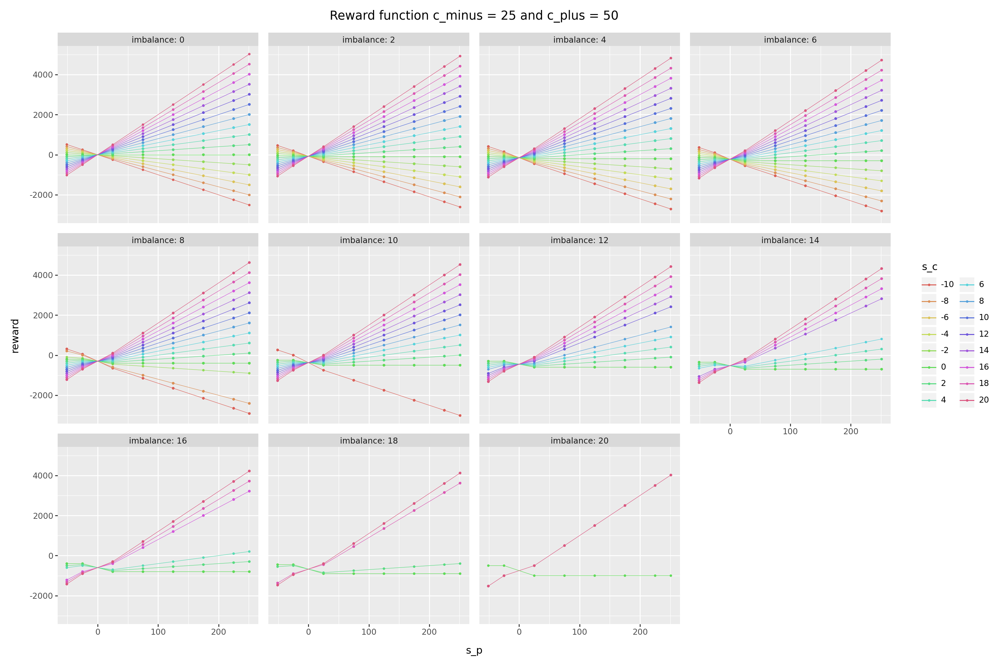

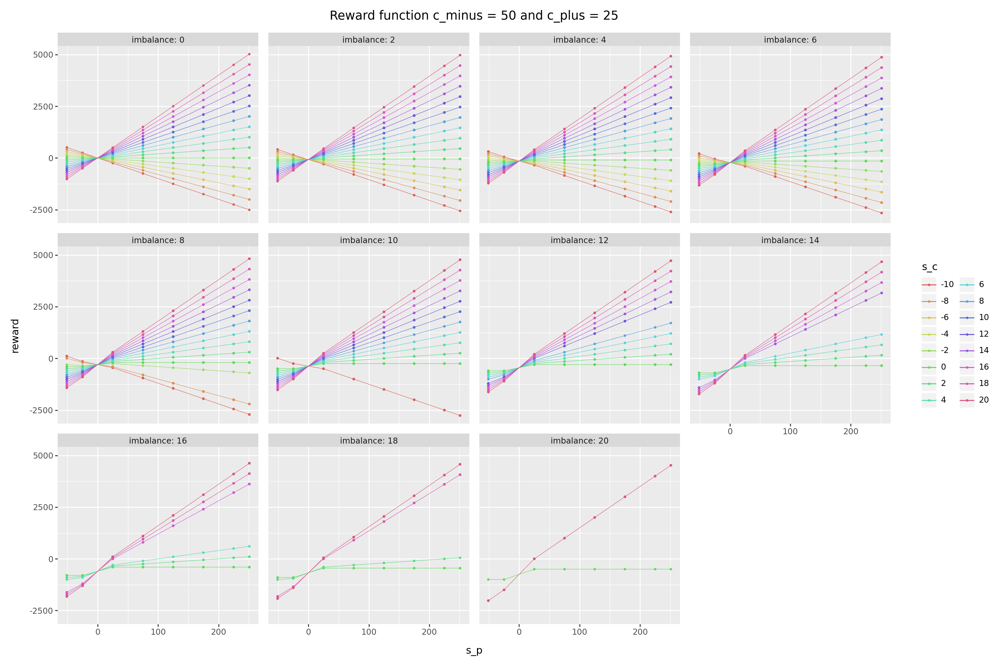

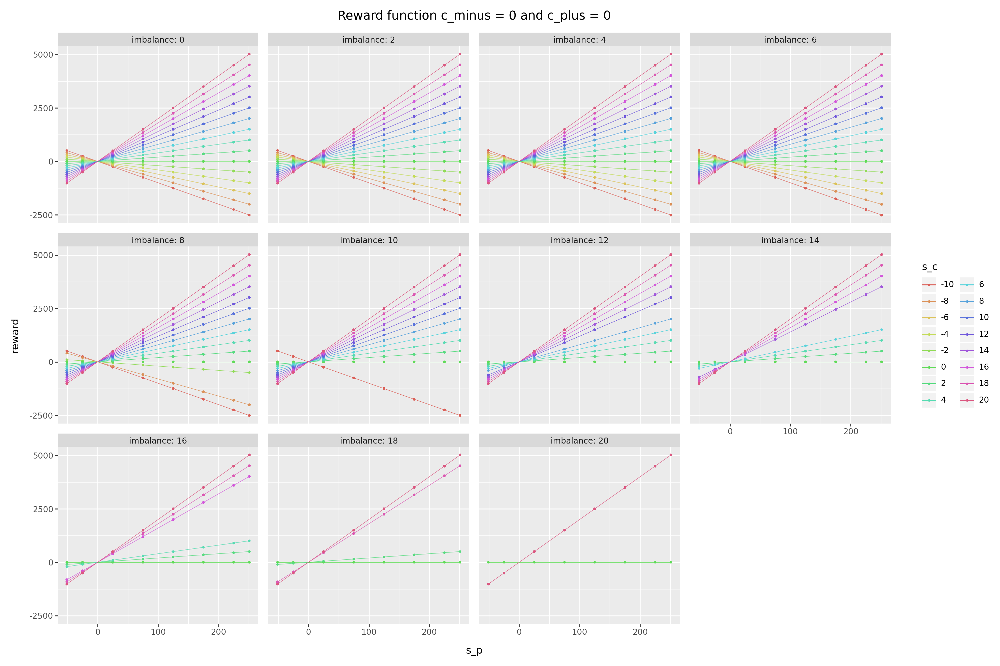

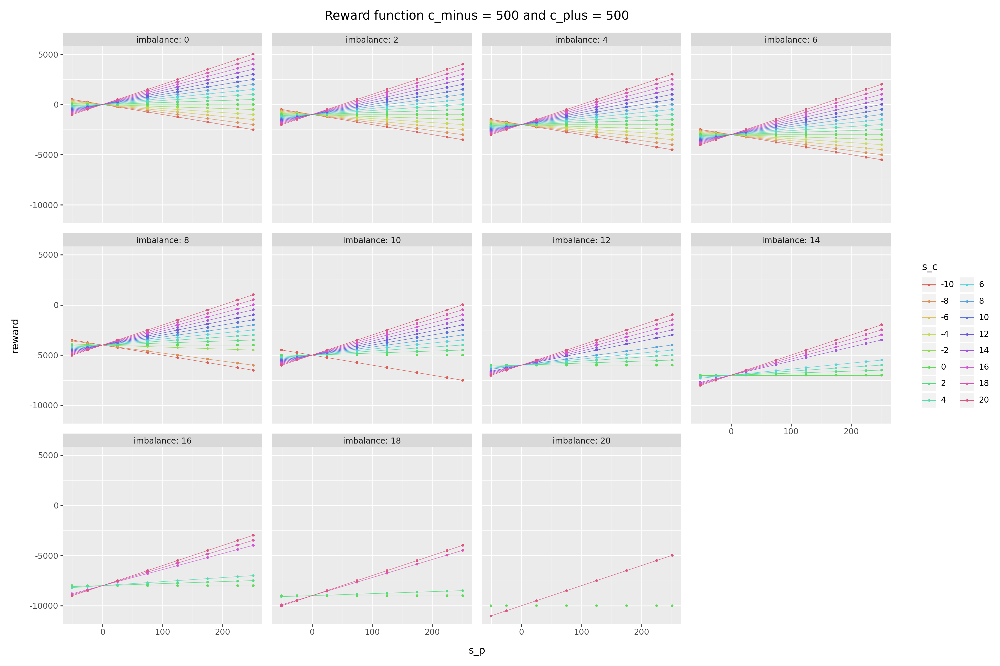


Note that some lines are not plotted since they are not possible. This is due to the fact that the imbalance is $| s^c-e |$. For instance, if the imbalance equals 20, then $| s^c-e | = 20$ and hence only $s^c = 0$ or 20 is possible.   


In [ ]:
#@title Solution
# You may also plot the reward instead of the expected reward.

def plot_reward(c_plus, c_minus):
    dat = generate_rewards(c_plus, c_minus)
    dat['s_c'] = pd.Categorical(dat['s_c'])
    pt = (
        ggplot(dat, aes("s_p", "reward", color = "s_c"))
        + facet_wrap(facets="imbalance", labeller="label_both") #, scales="free"
        + geom_line(size = 0.25)
        + geom_point(size = 0.5)
        + labs(title = f"Reward function c_minus = {c_minus} and c_plus = {c_plus}")
        + theme(figure_size=(15,10))
    )
    pt.show()

plot_reward(50, 25)
plot_reward(25, 50)
plot_reward(0, 0)
plot_reward(500, 500)

dat = generate_rewards(0, 0)
dat
dat >> mask(X.imbalance == 8)

display(Markdown("""
Note that some lines are not plotted since they are not possible. This is due to the fact that the imbalance is $| s^c-e |$. For instance, if the imbalance equals 20, then $| s^c-e | = 20$ and hence only $s^c = 0$ or 20 is possible.
"""))

## Transition probability funciton

Given the discretization we need to be able to calculate probabilities:

\begin{align}
    p(s^w_{t+1} | s^w_t) &= p(s^w_{t+1} \in I_{t+1} | s^w_t \in I_t) \\
    p(s^p_{t+1} | s^p_t) &= p(s^p_{t+1} \in I_{t+1} | s^p_t \in I_t) \\
\end{align}

Let us implement these functions:

In [ ]:
def get_trans_pr_w(s_w, s_w_next, s_w_inv):
    """
    Calculate the transition probability for wind states.

    Args:
        s_w (float): Current wind speed.
        s_w_next (float): Next wind speed.
        s_w_inv (dict): wind state intervals.

    Returns:
        float: Transition probability between the current and next wind state interval.
    """
    a, b = get_interval(s_w_next, s_w_inv)
    c, d = get_interval(s_w, s_w_inv)
    pr_w = get_wind_pr_inv(model_wind, a, b, c, d)
    return pr_w

def get_trans_pr_p(s_p, s_p_next, s_p_inv):
    """
    Calculate the transition probability for price states.

    Args:
        s_p (float): Current price.
        s_p_next (float): Next price.

    Returns:
        float: Transition probability between the current and next price state.
    """
    a, b = get_interval(s_p_next, s_p_inv)
    c, d = get_interval(s_p, s_p_inv)
    pr_p = get_price_pr_inv(model_price, a, b, c, d)
    return pr_p

# Test
print("Pr w:", get_trans_pr_w(0, 0.5, s_w_inv))
print("Pr p:", get_trans_pr_p(0, 1.25, s_p_inv))

Pr w: 0.44389269361168826
Pr p: 0.6846000409970724


Given the above functions we may store all values in two matrices:

In [ ]:
# Save all combinations in a matrix pr_w_mat[s_w, s_w_next]
pr_w_mat = np.zeros((len(s_w_inv['midpoints']), len(s_w_inv['midpoints'])))
for r in range(pr_w_mat.shape[0]):
    for c in range(pr_w_mat.shape[1]):
        pr_w_mat[r, c] = get_trans_pr_w(
            s_w_inv['midpoints'][r],
            s_w_inv['midpoints'][c],
            s_w_inv
        )
if any(abs(pr_w_mat.sum(axis = 1) - 1) > 0.000001):
    raise ValueError("Error don't sum to one!")
# normalize small diffs
pr_w_mat = pr_w_mat / pr_w_mat.sum(axis = 1, keepdims = True)

# Save all combinations in a matrix pr_p_mat[s_p, s_p_next]
pr_p_mat = np.zeros((len(s_p_inv['midpoints']), len(s_p_inv['midpoints'])))
for r in range(pr_p_mat.shape[0]):
    for c in range(pr_p_mat.shape[1]):
        pr_p_mat[r, c] = get_trans_pr_p(
            s_p_inv['midpoints'][r],
            s_p_inv['midpoints'][c],
            s_p_inv
        )
if any(abs(pr_p_mat.sum(axis = 1) - 1) > 0.000001):
    raise ValueError("Error don't sum to one!")
# normalize small diffs
pr_p_mat = pr_p_mat / pr_p_mat.sum(axis = 1, keepdims = True)

### Q6

These can be used to calculate the transition probabilities. Finish the function below

In [ ]:
#@title Solution

def get_trans_pr(s, a_c, a_b, pr_w_mat, pr_p_mat, s_w_inv, s_p_inv):
    """
    Compute the transition probabilities for a given state and actions. Assume
    the states and actions are discretised values.

    Args:
        s (dict): Current state, containing 's_l', 's_c', 's_w', 's_p'.
        a_c (float): Commitment.
        a_b (float): Energy transferred to the battery.
        pr_w_mat (np.ndarray): Transition probability matrix for wind states.
        pr_p_mat (np.ndarray): Transition probability matrix for price states.
        s_w_inv (dict): wind state intervals.
        s_p_inv (dict): price state intervals.

    Returns:
        dict: Dictionary of transition probabilities to the next states.
    """
    res = {}
    s_l_next = s['s_l'] - a_b
    s_c_next = a_c
    s_w_idx = s_w_inv['midpoints'].index(s['s_w'])
    s_p_idx = s_p_inv['midpoints'].index(s['s_p'])

    for s_w_next_idx, s_w_next in enumerate(s_w_inv['midpoints']):
        for s_p_next_idx, s_p_next in enumerate(s_p_inv['midpoints']):
            s_next = state_variables_to_str(s_l_next, s_c_next, s_w_next, s_p_next)
            pr_w = pr_w_mat[s_w_idx, s_w_next_idx]
            pr_p = pr_p_mat[s_p_idx, s_p_next_idx]
            p = pr_w * pr_p
            if p > 0:
                res[s_next] = p
    return res

# Test
s = state_labels[4]
s = str_to_dict(s)
print("State:", s)
pr = get_trans_pr(s, 10, 4, pr_w_mat, pr_p_mat, s_w_inv, s_p_inv)
print("Pr:", pr)
print("Sum:",sum(pr.values()))

State: {'s_l': 0, 's_c': -10, 's_w': 1.5, 's_p': 125.0}
Pr: {"{'s_l': -4, 's_c': 10, 's_w': 1.5, 's_p': -51}": np.float64(8.289661604399484e-16), "{'s_l': -4, 's_c': 10, 's_w': 1.5, 's_p': -25.0}": np.float64(1.4278653265137482e-08), "{'s_l': -4, 's_c': 10, 's_w': 1.5, 's_p': 25.0}": np.float64(0.0005767732234725386), "{'s_l': -4, 's_c': 10, 's_w': 1.5, 's_p': 75.0}": np.float64(0.09913601064336064), "{'s_l': -4, 's_c': 10, 's_w': 1.5, 's_p': 125.0}": np.float64(0.3039502429610364), "{'s_l': -4, 's_c': 10, 's_w': 1.5, 's_p': 175.0}": np.float64(0.04013784881024668), "{'s_l': -4, 's_c': 10, 's_w': 1.5, 's_p': 225.0}": np.float64(9.181012388706364e-05), "{'s_l': -4, 's_c': 10, 's_w': 1.5, 's_p': 251}": np.float64(8.972239480460904e-10), "{'s_l': -4, 's_c': 10, 's_w': 4.5, 's_p': -51}": np.float64(2.7242144833123657e-16), "{'s_l': -4, 's_c': 10, 's_w': 4.5, 's_p': -25.0}": np.float64(4.6923645238352006e-09), "{'s_l': -4, 's_c': 10, 's_w': 4.5, 's_p': 25.0}": np.float64(0.00018954380093594

## Building the MDP

We are now ready to build the MDP.

### Q7

Create a function that, given the settings, builds the MDP using the MDP class and returns it.

In [ ]:
#@title Solution

def build_mdp(settings, s_l_set, s_c_set, s_w_inv, s_p_inv, a_b_set, a_w_set, a_c_set, pr_w_mat, pr_p_mat):
    mdp = MDP()  # Create MDP

    # Add states
    state_labels = [state_variables_to_str(s_l, s_c, s_w, s_p) for s_l in s_l_set for s_c in s_c_set for s_w in s_w_inv['midpoints'] for s_p in s_p_inv['midpoints']]
    mdp.add_state_space(state_labels)

    # Add actions
    for s_label in mdp.get_state_keys():
        s = str_to_dict(s_label)  # Convert state string to dict
        for a in get_actions(s, settings):
        # Add possible actions
            pr = get_trans_pr(s, a['a_c'], a['a_b'], pr_w_mat, pr_p_mat, s_w_inv, s_p_inv)
            if abs(sum(pr.values())-1) > 0.000001:
                print("Sum of pr:", sum(pr.values()))
                raise SystemExit("Error don't sum to one!")
            action_label = str(a)
            rew = get_mean_reward(s['s_p'], s['s_c'], a['a_b'], a['a_w'], settings['c_plus'], settings['c_minus'], s_p_inv)
            mdp.add_action(s_label, action_label, rew, pr)

    print("MDP info:", mdp.get_mdp_info())
    return mdp

mdp = build_mdp(settings, s_l_set, s_c_set, s_w_inv, s_p_inv, a_b_set, a_w_set, a_c_set, pr_w_mat, pr_p_mat)
mdp.check(delta=0.0001)  # check if diff below 0.0001 (assume ok)
mdp.normalize()  # normalize pr so sum to one

MDP info: {'states': 4608, 'actions': 73728}
All checks passed!


## Solving the MDP and reviewing results

### Q8

Find the optimal policy given a discount rate of 0.5.



In [ ]:
#@title Solution

gamma = 0.5
mdp.policy_iteration(gamma)

Policy iteration finished in 3 iterations.


To verify the model, we need to transform the policy into a dataframe:

In [ ]:
policy = mdp.get_policy(add_state_values = True)

# Apply the parsing functions to create new columns with state variables
df_result = policy
# df_result.info()
df_result = df_result.join(df_result['state'].apply(str_to_dict).apply(pd.Series))
df_result = df_result.join(df_result['action'].apply(str_to_dict).apply(pd.Series))
df_result = (
    df_result
        >> mutate(e = X.a_b + X.a_w)
        >> mutate(imbalance = (X.e != X.s_c),
                  E = [energy(s_w) for s_w in df_result['s_w']],
                  reward = [mdp.get_reward(s, a) for s, a in zip(df_result['state'], df_result['action'])]
        )
)

# Add interval index and labels
df_result = df_result >> mutate(s_w_idx = [np.argmax(df_result['s_w'].unique() == v) for v in df_result['s_w']],
                                s_w_str = [get_interval(s_w, s_w_inv, as_string=True) for s_w in df_result['s_w']])
df_result = df_result >> mutate(s_p_idx = [np.argmax(df_result['s_p'].unique() == v) for v in df_result['s_p']],
                                s_p_str = [get_interval(s_p, s_p_inv, as_string=True) for s_p in df_result['s_p']])

# Get steady state pr and join
pr = mdp.get_steady_state_pr(tol=0.00001).drop(columns = 'pr')
pr.set_index(['state', 'action'], inplace=True)
df_result.set_index(['state', 'action'], inplace=True)
df_result = df_result.join(pr)

display(df_result)

,,pr,v,s_l,s_c,s_w,s_p,a_b,a_w,a_c,e,imbalance,E,reward,s_w_idx,s_w_str,s_p_idx,s_p_str,s_idx,steady_pr
state,action,,,,,,,,,,,,,,,,,,,
"{'s_l': 0, 's_c': -10, 's_w': 1.5, 's_p': -51}","{'a_b': -10, 'a_w': 0, 'a_c': 0}",1,570.769638,0.0,-10.0,1.5,-51.0,-10,0,0,-10,False,0.0,550.0,0,"[0, 3]",0,"[-inf, -50]",0,2.503717e-04
"{'s_l': 0, 's_c': -10, 's_w': 1.5, 's_p': -25.0}","{'a_b': -10, 'a_w': 0, 'a_c': 0}",1,319.939106,0.0,-10.0,1.5,-25.0,-10,0,0,-10,False,0.0,250.0,0,"[0, 3]",1,"[-50, 0]",1,3.006839e-03
"{'s_l': 0, 's_c': -10, 's_w': 1.5, 's_p': 25.0}","{'a_b': -10, 'a_w': 0, 'a_c': 10}",1,41.147079,0.0,-10.0,1.5,25.0,-10,0,10,-10,False,0.0,-250.0,0,"[0, 3]",2,"[0, 50]",2,1.493263e-03
"{'s_l': 0, 's_c': -10, 's_w': 1.5, 's_p': 75.0}","{'a_b': -10, 'a_w': 0, 'a_c': 20}",1,111.151957,0.0,-10.0,1.5,75.0,-10,0,20,-10,False,0.0,-750.0,0,"[0, 3]",3,"[50, 100]",3,1.358678e-05
"{'s_l': 0, 's_c': -10, 's_w': 1.5, 's_p': 125.0}","{'a_b': -10, 'a_w': 0, 'a_c': 20}",1,342.536856,0.0,-10.0,1.5,125.0,-10,0,20,-10,False,0.0,-1250.0,0,"[0, 3]",4,"[100, 150]",4,5.338801e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"{'s_l': 10, 's_c': 20, 's_w': 26, 's_p': 75.0}","{'a_b': 10, 'a_w': 0, 'a_c': 20}",1,1621.994520,10.0,20.0,26.0,75.0,10,0,20,10,True,0.0,1000.0,5,"[25, inf]",3,"[50, 100]",4603,1.981924e-03
"{'s_l': 10, 's_c': 20, 's_w': 26, 's_p': 125.0}","{'a_b': 10, 'a_w': 0, 'a_c': 20}",1,3353.575339,10.0,20.0,26.0,125.0,10,0,20,10,True,0.0,2000.0,5,"[25, inf]",4,"[100, 150]",4604,4.264689e-04
"{'s_l': 10, 's_c': 20, 's_w': 26, 's_p': 175.0}","{'a_b': 10, 'a_w': 0, 'a_c': 20}",1,5113.168655,10.0,20.0,26.0,175.0,10,0,20,10,True,0.0,3000.0,5,"[25, inf]",5,"[150, 200]",4605,2.975106e-06


Note that the we calculate the steady state probabilities. The steady state distribution is a probability distribution over states that remains unchanged as time goes to infinity.  

If $\pi$ is the optimal policy and $P^\pi$ is its transition matrix, the steady-state distribution $\mu$ satisfies:
$$
\mu P^\pi = \mu, \quad \sum_{i} \mu_i = 1.
$$
It tells you what fraction of time (in the long run) the system spends in each state under policy $\pi$.

### Q9

Verify the model (is the model implemented correctly?) by checking

1. If commit to the grid, then receiving energy should not be possible.
2. If commit from the grid, then sending energy should not be possible.
3. If commit from the grid, then discharging the battery should not be possible
4. Using a negative amount of wind should not be possible.
5. How many times is there an imbalance if commit from the grid? Is it reasonable?
6. How many times is there an imbalance if commit to the grid? Is it reasonable?


In [ ]:
#@title Solution

## Verification – “Did we build the model right?”
print("1:", len(df_result >> mask(X.e < 0, X.s_c > 0)), end = ", ")
print("2:", len(df_result >> mask(X.e > 0, X.s_c < 0)), end = ", ")
print("3:", len(df_result >> mask(X.e < 0, X.a_b > 0)), end = ", ")
print("4:", len(df_result >> mask(X.a_w < 0)))
display(Markdown("""In 1-4, no rows were found satisfying the claims."""))

print("5:")
display(df_result >> mask(X.imbalance, X.e < 0))
display(df_result >> mask(X.imbalance, X.e < 0, X.steady_pr > 0))
display(Markdown("""
The dataframe with imbalances has rows. It may happend that I have promished to
take 10 MWh but only have room for 8. However, note that the pr for being in
these states is zero.
"""))

print("6:")
display(df_result >> mask(X.imbalance, X.e > 0))
display(df_result >> mask(X.imbalance, X.E > 2, X.s_l > 0, X.a_w > 0, X.steady_pr > 0))  # Is the numbers reasonable?
display(Markdown("""
The dataframe with imbalances has rows. Consider the first row in the 2. dataframe.
Here we have 4 MWh on the battery, can make 5.78 MWh from wind, but only sell 4, i.e. 8 in total.
"""))

1: 0, 2: 0, 3: 0, 4: 0


In 1-4, no rows were found satisfying the claims.

5:


,,pr,v,s_l,s_c,s_w,s_p,a_b,a_w,a_c,e,imbalance,E,reward,s_w_idx,s_w_str,s_p_idx,s_p_str,s_idx,steady_pr
state,action,,,,,,,,,,,,,,,,,,,
"{'s_l': 2, 's_c': -10, 's_w': 1.5, 's_p': -51}","{'a_b': -8, 'a_w': 0, 'a_c': 0}",1,470.769638,2.0,-10.0,1.5,-51.0,-8,0,0,-8,True,0.0,450.0,0,"[0, 3]",0,"[-inf, -50]",768,-0.0
"{'s_l': 2, 's_c': -10, 's_w': 1.5, 's_p': -25.0}","{'a_b': -8, 'a_w': 0, 'a_c': 0}",1,219.939106,2.0,-10.0,1.5,-25.0,-8,0,0,-8,True,0.0,150.0,0,"[0, 3]",1,"[-50, 0]",769,-0.0
"{'s_l': 2, 's_c': -10, 's_w': 1.5, 's_p': 25.0}","{'a_b': -8, 'a_w': 0, 'a_c': 10}",1,-58.852921,2.0,-10.0,1.5,25.0,-8,0,10,-8,True,0.0,-350.0,0,"[0, 3]",2,"[0, 50]",770,-0.0
"{'s_l': 2, 's_c': -10, 's_w': 1.5, 's_p': 75.0}","{'a_b': -8, 'a_w': 0, 'a_c': 20}",1,11.151957,2.0,-10.0,1.5,75.0,-8,0,20,-8,True,0.0,-850.0,0,"[0, 3]",3,"[50, 100]",771,-0.0
"{'s_l': 2, 's_c': -10, 's_w': 1.5, 's_p': 125.0}","{'a_b': -8, 'a_w': 0, 'a_c': 20}",1,242.536856,2.0,-10.0,1.5,125.0,-8,0,20,-8,True,0.0,-1350.0,0,"[0, 3]",4,"[100, 150]",772,-0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"{'s_l': 8, 's_c': -4, 's_w': 26, 's_p': 75.0}","{'a_b': -2, 'a_w': 0, 'a_c': 20}",1,471.994519,8.0,-4.0,26.0,75.0,-2,0,20,-2,True,0.0,-400.0,5,"[25, inf]",3,"[50, 100]",3259,-0.0
"{'s_l': 8, 's_c': -4, 's_w': 26, 's_p': 125.0}","{'a_b': -2, 'a_w': 0, 'a_c': 20}",1,1003.575339,8.0,-4.0,26.0,125.0,-2,0,20,-2,True,0.0,-600.0,5,"[25, inf]",4,"[100, 150]",3260,-0.0
"{'s_l': 8, 's_c': -4, 's_w': 26, 's_p': 175.0}","{'a_b': -2, 'a_w': 0, 'a_c': 20}",1,1563.168654,8.0,-4.0,26.0,175.0,-2,0,20,-2,True,0.0,-800.0,5,"[25, inf]",5,"[150, 200]",3261,-0.0


,,pr,v,s_l,s_c,s_w,s_p,a_b,a_w,a_c,e,imbalance,E,reward,s_w_idx,s_w_str,s_p_idx,s_p_str,s_idx,steady_pr
state,action,,,,,,,,,,,,,,,,,,,



The dataframe with imbalances has rows. It may happend that I have promished to
take 10 MWh but only have room for 8. However, note that the pr for being in
these states is zero.


6:


,,pr,v,s_l,s_c,s_w,s_p,a_b,a_w,a_c,e,imbalance,E,reward,s_w_idx,s_w_str,s_p_idx,s_p_str,s_idx,steady_pr
state,action,,,,,,,,,,,,,,,,,,,
"{'s_l': 0, 's_c': 6, 's_w': 10.5, 's_p': -51}","{'a_b': 0, 'a_w': 4, 'a_c': -10}",1,-195.102317,0.0,6.0,10.5,-51.0,0,4,-10,4,True,5.787037,-430.0,3,"[9, 12]",0,"[-inf, -50]",408,-0.000000e+00
"{'s_l': 0, 's_c': 6, 's_w': 10.5, 's_p': -25.0}","{'a_b': 0, 'a_w': 4, 'a_c': -10}",1,-127.187091,0.0,6.0,10.5,-25.0,0,4,-10,4,True,5.787037,-250.0,3,"[9, 12]",1,"[-50, 0]",409,-0.000000e+00
"{'s_l': 0, 's_c': 6, 's_w': 10.5, 's_p': 25.0}","{'a_b': 0, 'a_w': 4, 'a_c': 0}",1,186.176027,0.0,6.0,10.5,25.0,0,4,0,4,True,5.787037,50.0,3,"[9, 12]",2,"[0, 50]",410,-0.000000e+00
"{'s_l': 0, 's_c': 6, 's_w': 10.5, 's_p': 75.0}","{'a_b': 0, 'a_w': 4, 'a_c': 20}",1,972.855256,0.0,6.0,10.5,75.0,0,4,20,4,True,5.787037,350.0,3,"[9, 12]",3,"[50, 100]",411,-0.000000e+00
"{'s_l': 0, 's_c': 6, 's_w': 10.5, 's_p': 125.0}","{'a_b': 0, 'a_w': 4, 'a_c': 20}",1,2004.360799,0.0,6.0,10.5,125.0,0,4,20,4,True,5.787037,650.0,3,"[9, 12]",4,"[100, 150]",412,-0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"{'s_l': 10, 's_c': 20, 's_w': 26, 's_p': 75.0}","{'a_b': 10, 'a_w': 0, 'a_c': 20}",1,1621.994520,10.0,20.0,26.0,75.0,10,0,20,10,True,0.000000,1000.0,5,"[25, inf]",3,"[50, 100]",4603,1.981924e-03
"{'s_l': 10, 's_c': 20, 's_w': 26, 's_p': 125.0}","{'a_b': 10, 'a_w': 0, 'a_c': 20}",1,3353.575339,10.0,20.0,26.0,125.0,10,0,20,10,True,0.000000,2000.0,5,"[25, inf]",4,"[100, 150]",4604,4.264689e-04
"{'s_l': 10, 's_c': 20, 's_w': 26, 's_p': 175.0}","{'a_b': 10, 'a_w': 0, 'a_c': 20}",1,5113.168655,10.0,20.0,26.0,175.0,10,0,20,10,True,0.000000,3000.0,5,"[25, inf]",5,"[150, 200]",4605,2.975106e-06


,,pr,v,s_l,s_c,s_w,s_p,a_b,a_w,a_c,e,imbalance,E,reward,s_w_idx,s_w_str,s_p_idx,s_p_str,s_idx,steady_pr
state,action,,,,,,,,,,,,,,,,,,,
"{'s_l': 4, 's_c': 20, 's_w': 10.5, 's_p': -51}","{'a_b': 4, 'a_w': 4, 'a_c': -10}",1,-1465.102317,4.0,20.0,10.5,-51.0,4,4,-10,8,True,5.787037,-1700.0,3,"[9, 12]",0,"[-inf, -50]",2280,1.602089e-12
"{'s_l': 4, 's_c': 20, 's_w': 10.5, 's_p': -25.0}","{'a_b': 4, 'a_w': 4, 'a_c': -10}",1,-977.187091,4.0,20.0,10.5,-25.0,4,4,-10,8,True,5.787037,-1100.0,3,"[9, 12]",1,"[-50, 0]",2281,1.029075e-07
"{'s_l': 4, 's_c': 20, 's_w': 10.5, 's_p': 25.0}","{'a_b': 4, 'a_w': 4, 'a_c': 0}",1,36.176027,4.0,20.0,10.5,25.0,4,4,0,8,True,5.787037,-100.0,3,"[9, 12]",2,"[0, 50]",2282,2.802916e-05
"{'s_l': 4, 's_c': 20, 's_w': 10.5, 's_p': 75.0}","{'a_b': 4, 'a_w': 4, 'a_c': 20}",1,1522.855257,4.0,20.0,10.5,75.0,4,4,20,8,True,5.787037,900.0,3,"[9, 12]",3,"[50, 100]",2283,1.339178e-04
"{'s_l': 4, 's_c': 20, 's_w': 10.5, 's_p': 125.0}","{'a_b': 4, 'a_w': 4, 'a_c': 20}",1,3254.360800,4.0,20.0,10.5,125.0,4,4,20,8,True,5.787037,1900.0,3,"[9, 12]",4,"[100, 150]",2284,2.883303e-05
"{'s_l': 4, 's_c': 20, 's_w': 10.5, 's_p': 175.0}","{'a_b': 4, 'a_w': 4, 'a_c': 20}",1,5013.949647,4.0,20.0,10.5,175.0,4,4,20,8,True,5.787037,2900.0,3,"[9, 12]",5,"[150, 200]",2285,2.033893e-07
"{'s_l': 4, 's_c': 20, 's_w': 10.5, 's_p': 225.0}","{'a_b': 4, 'a_w': 4, 'a_c': 20}",1,6774.492910,4.0,20.0,10.5,225.0,4,4,20,8,True,5.787037,3900.0,3,"[9, 12]",6,"[200, 250]",2286,2.320137e-10
"{'s_l': 4, 's_c': 20, 's_w': 10.5, 's_p': 251}","{'a_b': 4, 'a_w': 4, 'a_c': 20}",1,8029.134059,4.0,20.0,10.5,251.0,4,4,20,8,True,5.787037,4500.0,3,"[9, 12]",7,"[250, inf]",2287,4.214467e-15
"{'s_l': 4, 's_c': 20, 's_w': 18.5, 's_p': -51}","{'a_b': 4, 'a_w': 10, 'a_c': -10}",1,-1165.099905,4.0,20.0,18.5,-51.0,4,10,-10,14,True,10.000000,-1400.0,4,"[12, 25]",0,"[-inf, -50]",2288,3.929812e-12



The dataframe with imbalances has rows. Consider the first row in the 2. dataframe.
Here we have 4 MWh on the battery, can make 5.78 MWh from wind, but only sell 4, i.e. 8 in total.


### Q10

Validate the model (are the model's results reasonable?). Check the results by filtering the data frame.

1. Do we choose to commit to the grid in the next period when prices (midpoints) are negative?
2. Do we choose not to commit to the grid in the next period when prices (midpoints) are positive?
3. How many different values of `a_c` are used?
4. What actions are taken given the price and wind? Make a plot with
   - `s_w_idx` and `s_p_idx` on the x-axis and y-axis, respectively.
   - Use `a_c` as label and color aesthetics.
   - Use labels as geom.
   - Make a subplot (facet) with rows `s_l` and cols `s_c`.
   - Plot only states with a steady state probability larger than zero.

   Make `s_c` categorical (discrete) using `pd.Categorical(df['s_c'])`.

   - Is commitment increasing with prices?
   - Do we have imbalances in the states we visit, given the optimal policy?
   - Why are commitments the same no matter the value of `s_w` if `s_c` is negative?

5. Make the same plot as above, but add reward as a label instead of `a_c`.
   - Are the rewards as expected?


1:


,,pr,v,s_l,s_c,s_w,s_p,a_b,a_w,a_c,e,imbalance,E,reward,s_w_idx,s_w_str,s_p_idx,s_p_str,s_idx,steady_pr
state,action,,,,,,,,,,,,,,,,,,,



Do we choose to commit to the grid in the next period when prices (midpoints)
are negative? No, we don't do that, which seems reasonable.


2:


,,pr,v,s_l,s_c,s_w,s_p,a_b,a_w,a_c,e,imbalance,E,reward,s_w_idx,s_w_str,s_p_idx,s_p_str,s_idx,steady_pr
state,action,,,,,,,,,,,,,,,,,,,
"{'s_l': 0, 's_c': 0, 's_w': 1.5, 's_p': 25.0}","{'a_b': 0, 'a_w': 0, 'a_c': 0}",1,132.227586,0.0,0.0,1.5,25.0,0,0,0,0,False,0.000000,0.000000e+00,0,"[0, 3]",2,"[0, 50]",242,0.034053
"{'s_l': 0, 's_c': 0, 's_w': 4.5, 's_p': 25.0}","{'a_b': 0, 'a_w': 0, 'a_c': 0}",1,135.124868,0.0,0.0,4.5,25.0,0,0,0,0,False,0.046296,0.000000e+00,1,"[3, 6]",2,"[0, 50]",250,0.015472
"{'s_l': 0, 's_c': 0, 's_w': 7.5, 's_p': 25.0}","{'a_b': 0, 'a_w': 0, 'a_c': 0}",1,135.827219,0.0,0.0,7.5,25.0,0,0,0,0,False,1.250000,0.000000e+00,2,"[6, 9]",2,"[0, 50]",258,0.009861
"{'s_l': 0, 's_c': 0, 's_w': 26, 's_p': 25.0}","{'a_b': 0, 'a_w': 0, 'a_c': 0}",1,136.025629,0.0,0.0,26.0,25.0,0,0,0,0,False,0.000000,0.000000e+00,5,"[25, inf]",2,"[0, 50]",282,0.043027
"{'s_l': 0, 's_c': 2, 's_w': 1.5, 's_p': 25.0}","{'a_b': 0, 'a_w': 0, 'a_c': 0}",1,82.227588,0.0,2.0,1.5,25.0,0,0,0,0,True,0.000000,-5.000000e+01,0,"[0, 3]",2,"[0, 50]",290,-0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"{'s_l': 10, 's_c': 20, 's_w': 4.5, 's_p': 25.0}","{'a_b': 10, 'a_w': 0, 'a_c': 0}",1,135.124869,10.0,20.0,4.5,25.0,10,0,0,10,True,0.046296,2.872756e-15,1,"[3, 6]",2,"[0, 50]",4570,0.000141
"{'s_l': 10, 's_c': 20, 's_w': 7.5, 's_p': 25.0}","{'a_b': 10, 'a_w': 0, 'a_c': 0}",1,135.827220,10.0,20.0,7.5,25.0,10,0,0,10,True,1.250000,2.872756e-15,2,"[6, 9]",2,"[0, 50]",4578,0.000095
"{'s_l': 10, 's_c': 20, 's_w': 10.5, 's_p': 25.0}","{'a_b': 10, 'a_w': 4, 'a_c': 0}",1,336.176027,10.0,20.0,10.5,25.0,10,4,0,14,True,5.787037,2.000000e+02,3,"[9, 12]",2,"[0, 50]",4586,0.000070



Do we choose not to commit to the grid in the next period when prices
(midpoints) are positive? Yes, this is possible for an price interval close to
negative prices. Here, there is a high probability that prices may be negative
in the next period. In this case, we commit zero to the grid.


3:


,,pr,v,s_l,s_c,s_w,s_p,a_b,a_w,a_c,e,imbalance,E,reward,s_w_idx,s_w_str,s_p_idx,s_p_str,s_idx,steady_pr
state,action,,,,,,,,,,,,,,,,,,,
"{'s_l': 0, 's_c': 0, 's_w': 1.5, 's_p': -51}","{'a_b': 0, 'a_w': 0, 'a_c': -10}",1,234.885616,0.0,0.0,1.5,-51.0,0,0,-10,0,False,0.0,-0.0,0,"[0, 3]",0,"[-inf, -50]",240,0.000010
"{'s_l': 0, 's_c': -2, 's_w': 1.5, 's_p': -51}","{'a_b': -2, 'a_w': 0, 'a_c': -8}",1,302.062418,0.0,-2.0,1.5,-51.0,-2,0,-8,-2,False,0.0,110.0,0,"[0, 3]",0,"[-inf, -50]",192,-0.000000
"{'s_l': 0, 's_c': -4, 's_w': 1.5, 's_p': -51}","{'a_b': -4, 'a_w': 0, 'a_c': -6}",1,369.239223,0.0,-4.0,1.5,-51.0,-4,0,-6,-4,False,0.0,220.0,0,"[0, 3]",0,"[-inf, -50]",144,-0.000000
"{'s_l': 0, 's_c': -6, 's_w': 1.5, 's_p': -51}","{'a_b': -6, 'a_w': 0, 'a_c': -4}",1,436.416028,0.0,-6.0,1.5,-51.0,-6,0,-4,-6,False,0.0,330.0,0,"[0, 3]",0,"[-inf, -50]",96,-0.000000
"{'s_l': 0, 's_c': -8, 's_w': 1.5, 's_p': -51}","{'a_b': -8, 'a_w': 0, 'a_c': -2}",1,503.592832,0.0,-8.0,1.5,-51.0,-8,0,-2,-8,False,0.0,440.0,0,"[0, 3]",0,"[-inf, -50]",48,-0.000000
"{'s_l': 0, 's_c': -10, 's_w': 1.5, 's_p': -51}","{'a_b': -10, 'a_w': 0, 'a_c': 0}",1,570.769638,0.0,-10.0,1.5,-51.0,-10,0,0,-10,False,0.0,550.0,0,"[0, 3]",0,"[-inf, -50]",0,0.000250
"{'s_l': 0, 's_c': -2, 's_w': 1.5, 's_p': 25.0}","{'a_b': -2, 'a_w': 0, 'a_c': 2}",1,114.011486,0.0,-2.0,1.5,25.0,-2,0,2,-2,False,0.0,-50.0,0,"[0, 3]",2,"[0, 50]",194,-0.000000
"{'s_l': 0, 's_c': -4, 's_w': 1.5, 's_p': 25.0}","{'a_b': -4, 'a_w': 0, 'a_c': 4}",1,95.795384,0.0,-4.0,1.5,25.0,-4,0,4,-4,False,0.0,-100.0,0,"[0, 3]",2,"[0, 50]",146,-0.000000
"{'s_l': 0, 's_c': -6, 's_w': 1.5, 's_p': 25.0}","{'a_b': -6, 'a_w': 0, 'a_c': 6}",1,77.579282,0.0,-6.0,1.5,25.0,-6,0,6,-6,False,0.0,-150.0,0,"[0, 3]",2,"[0, 50]",98,-0.000000



Seems to use all possible values of $a_c$.


,,pr,v,s_l,s_c,s_w,s_p,a_b,a_w,a_c,e,imbalance,E,reward,s_w_idx,s_w_str,s_p_idx,s_p_str,s_idx,steady_pr
state,action,,,,,,,,,,,,,,,,,,,
"{'s_l': 0, 's_c': 0, 's_w': 1.5, 's_p': -51}","{'a_b': 0, 'a_w': 0, 'a_c': -10}",1,234.885616,0.0,0.0,1.5,-51.0,0,0,-10,0,False,0.000000,-0.0,0,"[0, 3]",0,"[-inf, -50]",240,0.000010
"{'s_l': 0, 's_c': 0, 's_w': 10.5, 's_p': -51}","{'a_b': -4, 'a_w': 4, 'a_c': -6}",1,149.251291,0.0,0.0,10.5,-51.0,-4,4,-6,0,False,5.787037,-0.0,3,"[9, 12]",0,"[-inf, -50]",264,0.000002
"{'s_l': 0, 's_c': -10, 's_w': 1.5, 's_p': -51}","{'a_b': -10, 'a_w': 0, 'a_c': 0}",1,570.769638,0.0,-10.0,1.5,-51.0,-10,0,0,-10,False,0.000000,550.0,0,"[0, 3]",0,"[-inf, -50]",0,0.000250
"{'s_l': 0, 's_c': 0, 's_w': 10.5, 's_p': 25.0}","{'a_b': -4, 'a_w': 4, 'a_c': 4}",1,199.743823,0.0,0.0,10.5,25.0,-4,4,4,0,False,5.787037,0.0,3,"[9, 12]",2,"[0, 50]",266,0.007113
"{'s_l': 0, 's_c': -10, 's_w': 1.5, 's_p': 25.0}","{'a_b': -10, 'a_w': 0, 'a_c': 10}",1,41.147079,0.0,-10.0,1.5,25.0,-10,0,10,-10,False,0.000000,-250.0,0,"[0, 3]",2,"[0, 50]",2,0.001493
"{'s_l': 0, 's_c': -10, 's_w': 1.5, 's_p': 75.0}","{'a_b': -10, 'a_w': 0, 'a_c': 20}",1,111.151957,0.0,-10.0,1.5,75.0,-10,0,20,-10,False,0.000000,-750.0,0,"[0, 3]",3,"[50, 100]",3,0.000014



We only use a few actions with a steady state probability larger than zero.


4:


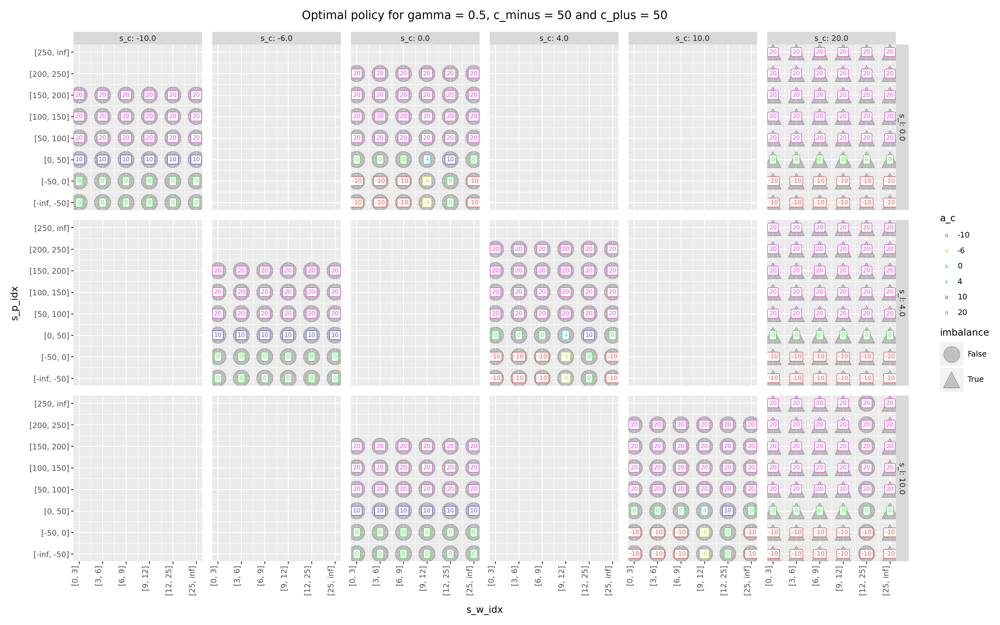


Is commitment increasing with prices? Yes, increasing prices makes us commit the
same or more to the grid.

Do we have imbalances in the states we visit, given the optimal policy? Yes
places where our commitment is too high compared to our wind capacity.

Why are commitments (actions) the same no matter the value of s_w if s_c is
negative? Here we fully charge the battery and hence can discarge it next
period no matter the wind speed. For high prices, we are even ready to bet on
good wind speed and commit to 20 MWh.


5:


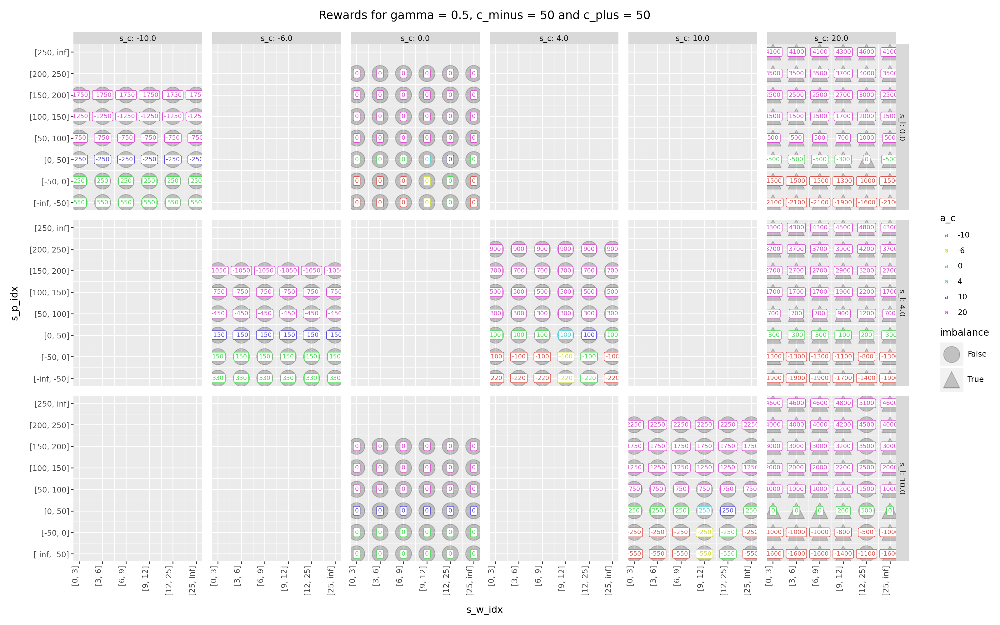


The rewards are as expected.


In [ ]:
#@title Solution

## Validation – “Did we build the right model?”
print("1:")
display(df_result >> mask(X.s_p < 0, X.a_c > 0))
display(Markdown("""
Do we choose to commit to the grid in the next period when prices (midpoints)
are negative? No, we don't do that, which seems reasonable.
"""))

print("2:")
display(df_result >> mask(X.s_p > 0, X.a_c <= 0))
display(Markdown("""
Do we choose not to commit to the grid in the next period when prices
(midpoints) are positive? Yes, this is possible for an price interval close to
negative prices. Here, there is a high probability that prices may be negative
in the next period. In this case, we commit zero to the grid.
"""))

print("3:")
display(df_result >> distinct(X.a_c) >> arrange(X.a_c))
display(Markdown("""
Seems to use all possible values of $a_c$.
"""))
display(df_result >> mask(X.steady_pr > 0) >> distinct(X.a_c) >> arrange(X.a_c))
display(Markdown("""
We only use a few actions with a steady state probability larger than zero.
"""))

print("4:")
dat = (
    df_result
        # >> mask((X.s_l == 0) | (X.s_l == 5) | (X.s_l == 10)) >> mask((X.s_c == -10) | (X.s_c == -2) | (X.s_c == 0) | (X.s_c == 2))   # mask(~X.imbalance)
        >> mask(X.steady_pr > 0)
)
dat['a_c'] = pd.Categorical(dat['a_c'])  # Convert 'a_c' to a categorical variable for discrete scaling
pt = (
    ggplot(dat, aes("s_w_idx", "s_p_idx", label = "a_c", color="a_c"))
    + geom_point(aes(shape = 'imbalance'), size = 10, color = "black", alpha = 0.2)
    + geom_label(size = 7)
    + facet_grid(rows = "s_l", cols = "s_c", labeller="label_both")
    # + theme(legend_position='none')
    + labs(title = f"Optimal policy for gamma = {gamma}, c_minus = {settings['c_minus']} and c_plus = {settings['c_plus']}")
    + theme(figure_size=(16,10), axis_text_x=element_text(rotation=90, hjust=1))
    + scale_color_discrete()
    + scale_x_continuous(breaks=dat['s_w_idx'].unique(), labels=dat['s_w_str'].unique())
    + scale_y_continuous(breaks=dat['s_p_idx'].unique(), labels=dat['s_p_str'].unique())
)
pt.show()
display(Markdown("""
Is commitment increasing with prices? Yes, increasing prices makes us commit the
same or more to the grid.\n
Do we have imbalances in the states we visit, given the optimal policy? Yes
places where our commitment is too high compared to our wind capacity.\n
Why are commitments (actions) the same no matter the value of s_w if s_c is
negative? Here we fully charge the battery and hence can discarge it next
period no matter the wind speed. For high prices, we are even ready to bet on
good wind speed and commit to 20 MWh.
"""))

# pt = (
#     ggplot(dat, aes("a_w", "s_p_idx", label = "a_c", color="a_c"))
#     + geom_point(aes(shape = 'imbalance'), size = 10, color = "black", alpha = 0.2)
#     + geom_label(size = 7)
#     + facet_wrap("~ s_l + s_c", labeller="label_both")
#     # + theme(legend_position='none')
#     + labs(title = f"Optimal policy for gamma = {gamma}, c_minus = {settings['c_minus']} and c_plus = {settings['c_plus']}")
#     + theme(figure_size=(16,10))
#     + scale_color_discrete()
#     + scale_y_continuous(breaks=dat['s_p_idx'].unique(), labels=dat['s_p_str'].unique())
# )
# pt.show()

print("5:")
dat['reward'] = dat['reward'].round(0).astype(int)
pt = (
    ggplot(dat, aes("s_w_idx", "s_p_idx", label = "reward", color="a_c"))
    + geom_point(aes(shape = 'imbalance'), size = 10, color = "black", alpha = 0.2)
    + geom_label(size = 7)
    + facet_grid(rows = "s_l", cols = "s_c", labeller="label_both")
    # + theme(legend_position='none')
    + labs(title = f"Rewards for gamma = {gamma}, c_minus = {settings['c_minus']} and c_plus = {settings['c_plus']}")
    + theme(figure_size=(16,10), axis_text_x=element_text(rotation=90, hjust=1))
    + scale_color_discrete()
    + scale_x_continuous(breaks=dat['s_w_idx'].unique(), labels=dat['s_w_str'].unique())
    + scale_y_continuous(breaks=dat['s_p_idx'].unique(), labels=dat['s_p_str'].unique())
)
pt.show()
display(Markdown("""
The rewards are as expected.
"""))

Let us put it all together

### Q11

Join all the calculations into a function `build_and_solve_mdp`, that takes arguments: `settings, s_l_set, s_c_set, s_w_inv, s_p_inv, a_b_set, a_w_set, a_c_set, gamma`. The function build and solve the MDP. Next, the results are plotted.  


In [ ]:
#@title Solution

def build_and_solve_mdp(settings, s_l_set, s_c_set, s_w_inv, s_p_inv, a_b_set, a_w_set, a_c_set, gamma):
    ## Calc trans pr matrices for s_w and s_p
    # Save all combinations in a matrix pr_w_mat[s_w, s_w_next]
    pr_w_mat = np.zeros((len(s_w_inv['midpoints']), len(s_w_inv['midpoints'])))
    for r in range(pr_w_mat.shape[0]):
        for c in range(pr_w_mat.shape[1]):
            pr_w_mat[r, c] = get_trans_pr_w(
                s_w_inv['midpoints'][r],
                s_w_inv['midpoints'][c],
                s_w_inv
            )
    if any(abs(pr_w_mat.sum(axis = 1) - 1) > 0.000001):
        raise ValueError("Error don't sum to one!")
    # normalize small diffs
    pr_w_mat = pr_w_mat / pr_w_mat.sum(axis = 1, keepdims = True)

    # Save all combinations in a matrix pr_p_mat[s_p, s_p_next]
    pr_p_mat = np.zeros((len(s_p_inv['midpoints']), len(s_p_inv['midpoints'])))
    for r in range(pr_p_mat.shape[0]):
        for c in range(pr_p_mat.shape[1]):
            pr_p_mat[r, c] = get_trans_pr_p(
                s_p_inv['midpoints'][r],
                s_p_inv['midpoints'][c],
                s_p_inv
            )
    if any(abs(pr_p_mat.sum(axis = 1) - 1) > 0.000001):
        raise ValueError("Error don't sum to one!")
    # normalize small diffs
    pr_p_mat = pr_p_mat / pr_p_mat.sum(axis = 1, keepdims = True)

    ## Build the MDP
    mdp = build_mdp(settings, s_l_set, s_c_set, s_w_inv, s_p_inv, a_b_set, a_w_set, a_c_set, pr_w_mat, pr_p_mat)
    mdp.check(delta=0.0001)  # check if diff below 0.0001 (assume ok)
    mdp.normalize()  # normalize pr so sum to one

    ## Optimize
    mdp.policy_iteration(gamma)
    policy = mdp.get_policy(add_state_values = True)

    ## Get results/policy dataframe
    df_result = policy
    df_result = df_result.join(df_result['state'].apply(str_to_dict).apply(pd.Series))
    df_result = df_result.join(df_result['action'].apply(str_to_dict).apply(pd.Series))
    df_result = (
        df_result
            >> mutate(e = X.a_b + X.a_w)
            >> mutate(imbalance = (X.e != X.s_c),
                    E = [energy(s_w) for s_w in df_result['s_w']],
                    reward = [mdp.get_reward(s, a) for s, a in zip(df_result['state'], df_result['action'])]
            )
    )
    # Add interval index and labels
    df_result = df_result >> mutate(s_w_idx = [np.argmax(df_result['s_w'].unique() == v) for v in df_result['s_w']],
                                    s_w_str = [get_interval(s_w, s_w_inv, as_string=True) for s_w in df_result['s_w']])
    df_result = df_result >> mutate(s_p_idx = [np.argmax(df_result['s_p'].unique() == v) for v in df_result['s_p']],
                                    s_p_str = [get_interval(s_p, s_p_inv, as_string=True) for s_p in df_result['s_p']])
    # Get steady state pr and join
    pr = mdp.get_steady_state_pr().drop(columns = 'pr')
    pr.set_index(['state', 'action'], inplace=True)
    df_result.set_index(['state', 'action'], inplace=True)
    df_result = df_result.join(pr)

    ## Plot results
    dat = (
        df_result
            # >> mask((X.s_l == 0) | (X.s_l == 5) | (X.s_l == 10)) >> mask((X.s_c == -10) | (X.s_c == -2) | (X.s_c == 0) | (X.s_c == 2))   # mask(~X.imbalance)
            >> mask(X.steady_pr > 0)
    )
    dat['a_c'] = pd.Categorical(dat['a_c'])  # Convert 'a_c' to a categorical variable for discrete scaling
    pt = (
        ggplot(dat, aes("s_w_idx", "s_p_idx", label = "a_c", color="a_c"))
        + geom_point(aes(shape = 'imbalance'), size = 10, color = "black", alpha = 0.2)
        + geom_label(size = 7)
        + facet_wrap("~ s_l + s_c", labeller="label_both")
        # + facet_grid(rows = "s_l", cols = "s_c", labeller="label_both")
        # + theme(legend_position='none')
        + labs(title = f"Optimal policy for gamma = {gamma}, c_minus = {settings['c_minus']} and c_plus = {settings['c_plus']}")
        + theme(figure_size=(15,10), axis_text_x=element_text(rotation=90, hjust=1))
        + scale_color_discrete()
        + scale_x_continuous(breaks=dat['s_w_idx'].unique(), labels=dat['s_w_str'].unique())
        + scale_y_continuous(breaks=dat['s_p_idx'].unique(), labels=dat['s_p_str'].unique())
    )
    pt.show()

    dat['reward'] = dat['reward'].round(0).astype(int)
    pt = (
        ggplot(dat, aes("s_w_idx", "s_p_idx", label = "reward", color="a_c"))
        + geom_point(aes(shape = 'imbalance'), size = 10, color = "black", alpha = 0.2)
        + geom_label(size = 7)
        + facet_wrap("~ s_l + s_c", labeller="label_both")
        # + facet_grid(rows = "s_l", cols = "s_c", labeller="label_both")
        # + theme(legend_position='none')
        + labs(title = f"Rewards for c_minus = {settings['c_minus']} and c_plus = {settings['c_plus']}")
        + theme(figure_size=(15,10), axis_text_x=element_text(rotation=90, hjust=1))
        + scale_color_discrete()
        + scale_x_continuous(breaks=dat['s_w_idx'].unique(), labels=dat['s_w_str'].unique())
        + scale_y_continuous(breaks=dat['s_p_idx'].unique(), labels=dat['s_p_str'].unique())
    )
    pt.show()

    dat['v'] = dat['v'].round(0).astype(int)
    pt = (
        ggplot(dat, aes("s_w_idx", "s_p_idx", label = "v", color="a_c"))
        + geom_point(aes(shape = 'imbalance'), size = 10, color = "black", alpha = 0.2)
        + geom_label(size = 7)
        + facet_wrap("~ s_l + s_c", labeller="label_both")
        # + facet_grid(rows = "s_l", cols = "s_c", labeller="label_both")
        # + theme(legend_position='none')
        + labs(title = f"Total discounted rewards for gamma = {gamma}, c_minus = {settings['c_minus']} and c_plus = {settings['c_plus']}")
        + theme(figure_size=(15,10), axis_text_x=element_text(rotation=90, hjust=1))
        + scale_color_discrete()
        + scale_x_continuous(breaks=dat['s_w_idx'].unique(), labels=dat['s_w_str'].unique())
        + scale_y_continuous(breaks=dat['s_p_idx'].unique(), labels=dat['s_p_str'].unique())
    )
    pt.show()

    return mdp, df_result

Test it using the same settings as before:

MDP info: {'states': 2880, 'actions': 46080}
All checks passed!
Policy iteration finished in 3 iterations.


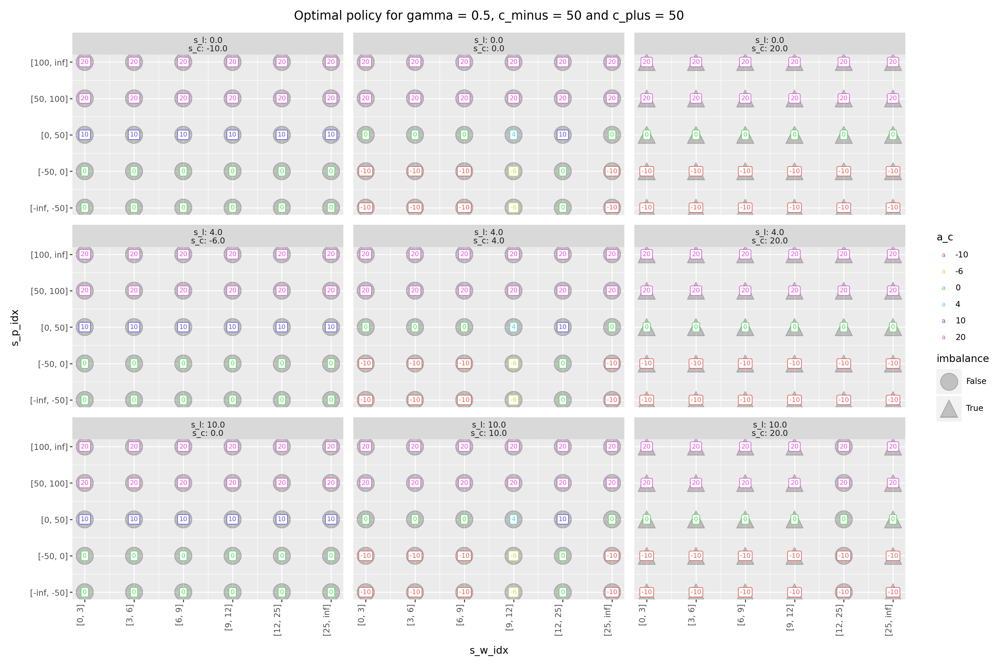

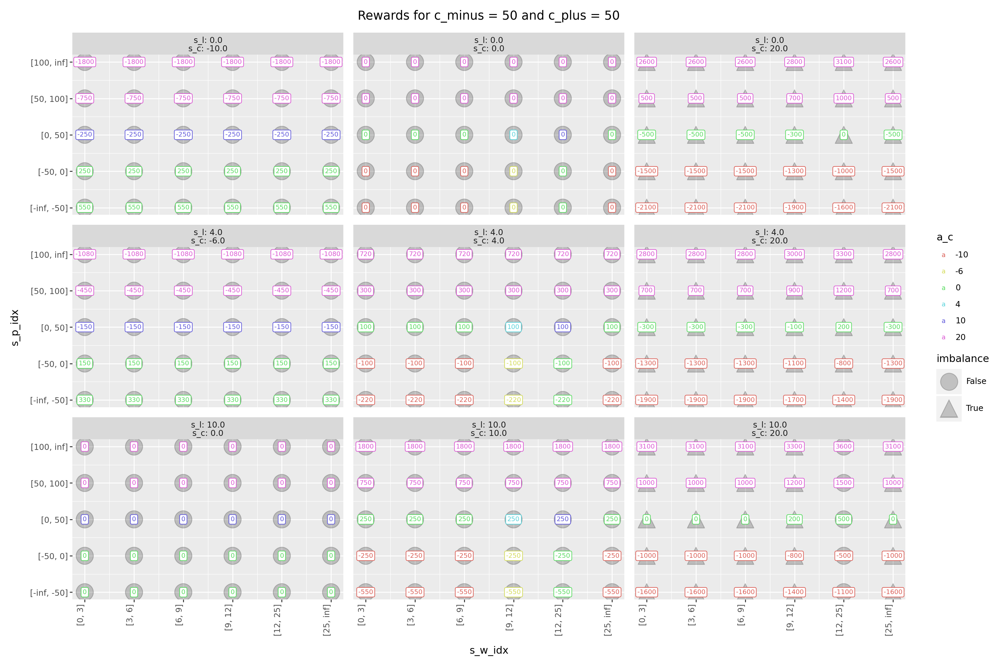

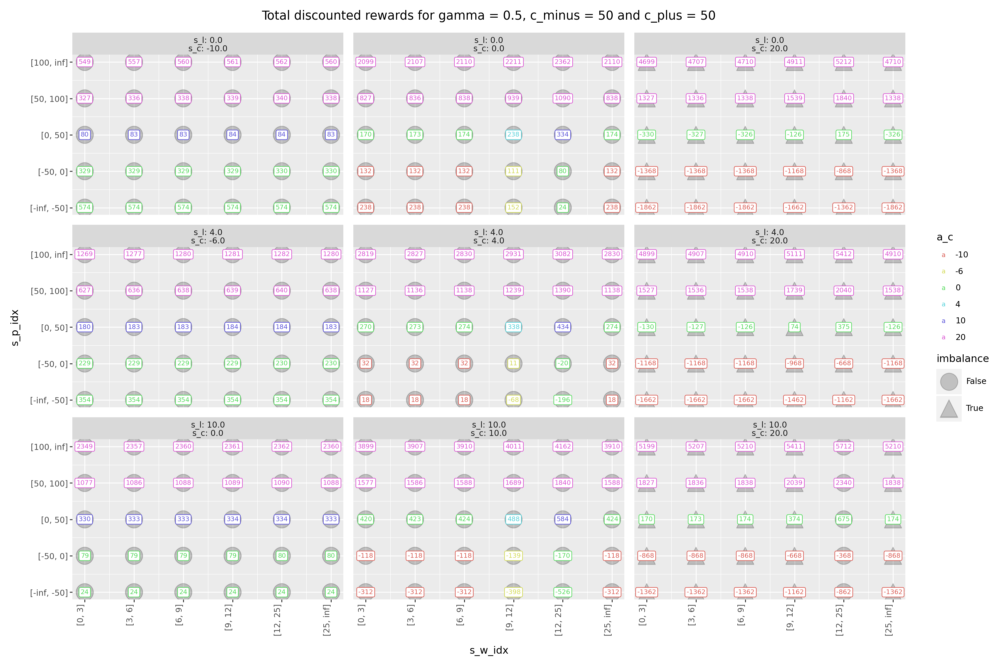

In [ ]:
settings = {
    ## Problem parameters
    'b_max': 10,  # battery capacity (MWh)
    'p_max': 10,  # max power output wind (MW)
    'c_max': 10 + 10,  # max commitment (MWh) # b_max + p_max
    'w_cut_in': 3,  # cut in wind speed (m/s)
    'w_rated': 12,  # rated wind speed (m/s)
    'w_cut_out': 25,  # cut out wind speed (m/s)
    'c_plus': 50,  # EUR/MWh
    'c_minus': 50, # EUR/MWh
}

b_max = settings['b_max']
p_max = settings['p_max']
c_max = settings['c_max']
w_cut_in = settings['w_cut_in']
w_rated = settings['w_rated']
w_cut_out = settings['w_cut_out']
step_mwh = 2
length_ms = 3
length_p = 50
min_p = -50
max_p = 250

## States variables
s_l_set = generate_discrete_set(0, b_max, step_mwh)
s_c_set = generate_discrete_set(-b_max, c_max, step_mwh)

# s_w
s_w_inv = generate_intervals(w_cut_in, w_rated, length_ms)
add_interval(0, w_cut_in, s_w_inv)
add_interval(w_rated, w_cut_out, s_w_inv)
add_interval(w_cut_out, np.inf, s_w_inv)

# s_p
s_p_inv = generate_intervals(min_p, max_p - 150, length_p, add_inf = True, add_neg_inf = True)

## Action variables
a_b_set = generate_discrete_set(-b_max, b_max, step_mwh)
a_w_set = generate_discrete_set(0, p_max, step_mwh)
a_c_set = generate_discrete_set(-b_max, c_max, step_mwh)

mdp, df_result = build_and_solve_mdp(settings, s_l_set, s_c_set, s_w_inv, s_p_inv, a_b_set, a_w_set, a_c_set, 0.5)

Note that it seems that the same action is taken for prices above/below zero. Hence, we may focus on small intervals here only. Moreover, not all possible commitments are used in states where the steady state probability is non-zero. This is due to the intervals chosen for wind speed not corresponding to all possible commitment values.

Let us try to define different intervals for the price and wind:

In [ ]:
# Make s_p_inv smaller
print("Current prices:")
pprint(s_p_inv)
s_p_inv = generate_intervals(-20, 5, 5, add_inf = True, add_neg_inf = True)
print("New prices:")
pprint(s_p_inv)

# Make new s_w_inv
print("Current wind:")
print("Commitment values:", a_w_set)  # commitment values
print("Commitment values used:", dat['a_w'].unique())  # a_c values used
e_prod = [energy(w) for w in s_w_inv['midpoints']] # possible energy production given wind intervals
print("Possible energy production given wind intervals:", e_prod)
print("What we can sell:", [get_left_or_right(a_w_set, e) for e in e_prod])  # what we can sell
# pprint(s_w_inv)  # current wind speeds used
# That is, our current wind speed intervals are not aligned with a_w
print("New wind:")
val = [round(energy_inverse(e), 1) for e in a_w_set]  # wind speeds corresponding to a_w_set
print("Wind speeds corresponding to a_w_set:", val)
# Modify s_w_inv
s_w_inv = generate_intervals(0, w_cut_in, w_cut_in)
for i, v in enumerate(val):
    if i > 0:
        add_interval(val[i-1], v, s_w_inv)
# pprint(s_w_inv)
add_interval(w_rated, w_cut_out, s_w_inv)
add_interval(w_cut_out, np.inf, s_w_inv)
print("New intervals:")
pprint(s_w_inv)

Current prices:
{'intervals_dict': {-51: {'ab': [-inf, -50], 'length': inf},
                    -25.0: {'ab': [-50, 0], 'length': 50},
                    25.0: {'ab': [0, 50], 'length': 50},
                    75.0: {'ab': [50, 100], 'length': 50},
                    101: {'ab': [100, inf], 'length': inf}},
 'lower_inf': True,
 'midpoints': [-51, -25.0, 25.0, 75.0, 101],
 'upper_inf': True}
New prices:
{'intervals_dict': {-21: {'ab': [-inf, -20], 'length': inf},
                    -17.5: {'ab': [-20, -15], 'length': 5},
                    -12.5: {'ab': [-15, -10], 'length': 5},
                    -7.5: {'ab': [-10, -5], 'length': 5},
                    -2.5: {'ab': [-5, 0], 'length': 5},
                    2.5: {'ab': [0, 5], 'length': 5},
                    6: {'ab': [5, inf], 'length': inf}},
 'lower_inf': True,
 'midpoints': [-21, -17.5, -12.5, -7.5, -2.5, 2.5, 6],
 'upper_inf': True}
Current wind:
Commitment values: [ 0  2  4  6  8 10]
Commitment values used: [ 0  4 10]
P

### Q12

Solve the new model and comment on the results.

MDP info: {'states': 5376, 'actions': 86016}
All checks passed!
Policy iteration finished in 4 iterations.


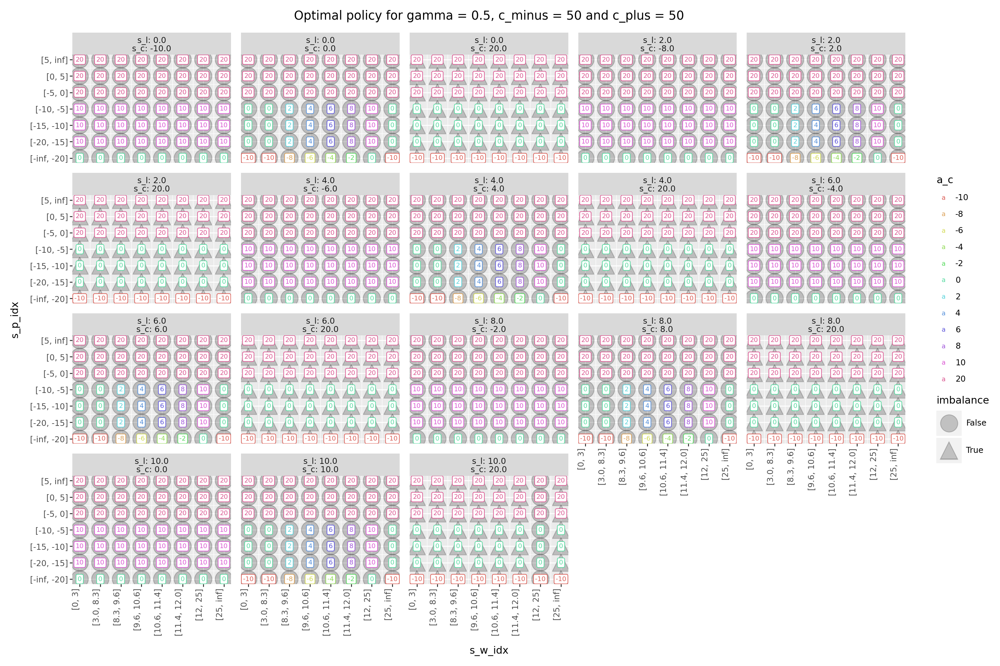

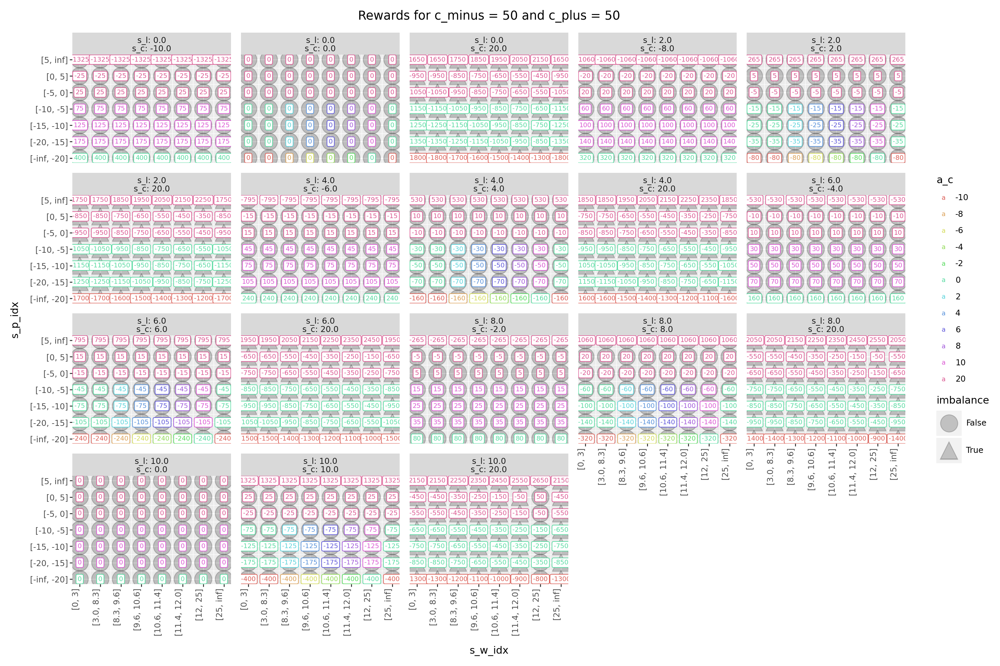

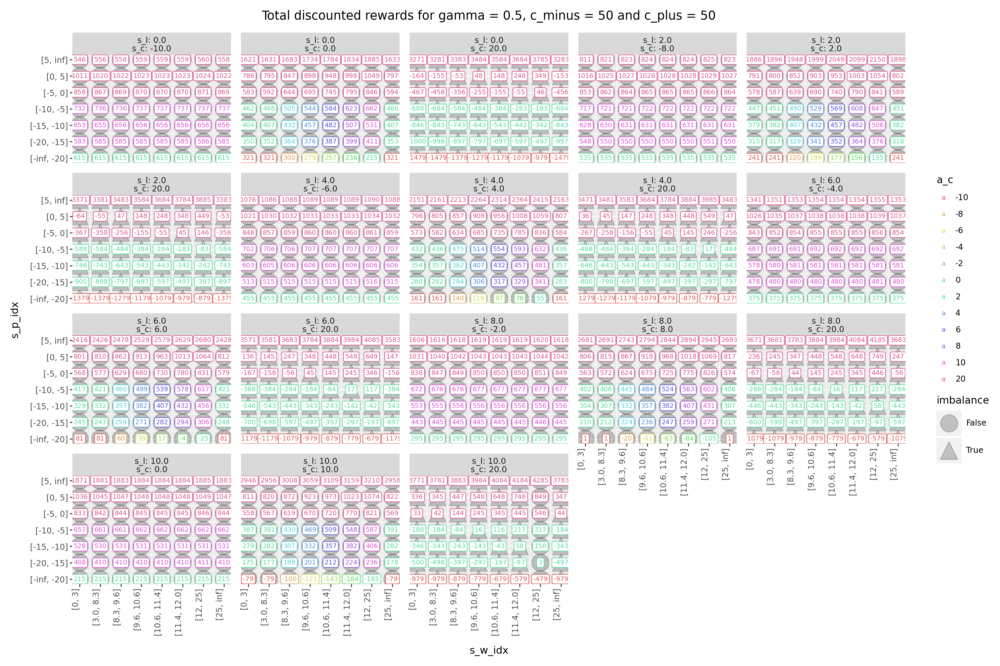

Current wind:
Wind commitment values: [ 0  2  4  6  8 10]
Wind commitment values used: [ 0  2  4  6  8 10]
Possible energy production given wind intervals: [0, 0.25527606310013734, 2.889504458161864, 4.909615912208504, 7.023319615912207, 9.03296296296296, 10, 0]
What we can sell given intervals: [0, np.int64(0), np.int64(2), np.int64(4), np.int64(6), np.int64(8), 10, 0]


In [ ]:
#@title Solution

mdp, df_result = build_and_solve_mdp(settings, s_l_set, s_c_set, s_w_inv, s_p_inv, a_b_set, a_w_set, a_c_set, 0.5)

dat = df_result >> mask(X.steady_pr > 0)
print("Current wind:")
print("Wind commitment values:", a_w_set)  # commitment values
print("Wind commitment values used:", dat['a_w'].unique())  # a_c values used
e_prod = [energy(w) for w in s_w_inv['midpoints']] # possible energy production given wind intervals
print("Possible energy production given wind intervals:", e_prod)
print("What we can sell given intervals:", [get_left_or_right(a_w_set, e) for e in e_prod])  # what we can sell


New prices:
{'intervals_dict': {-41: {'ab': [-inf, -40], 'length': inf},
                    -37.5: {'ab': [-40, -35], 'length': 5},
                    -32.5: {'ab': [-35, -30], 'length': 5},
                    -27.5: {'ab': [-30, -25], 'length': 5},
                    -22.5: {'ab': [-25, -20], 'length': 5},
                    -17.5: {'ab': [-20, -15], 'length': 5},
                    -12.5: {'ab': [-15, -10], 'length': 5},
                    -7.5: {'ab': [-10, -5], 'length': 5},
                    -2.5: {'ab': [-5, 0], 'length': 5},
                    2.5: {'ab': [0, 5], 'length': 5},
                    6: {'ab': [5, inf], 'length': inf}},
 'lower_inf': True,
 'midpoints': [-41,
               -37.5,
               -32.5,
               -27.5,
               -22.5,
               -17.5,
               -12.5,
               -7.5,
               -2.5,
               2.5,
               6],
 'upper_inf': True}
MDP info: {'states': 8448, 'actions': 135168}
All checks passed!
Poli

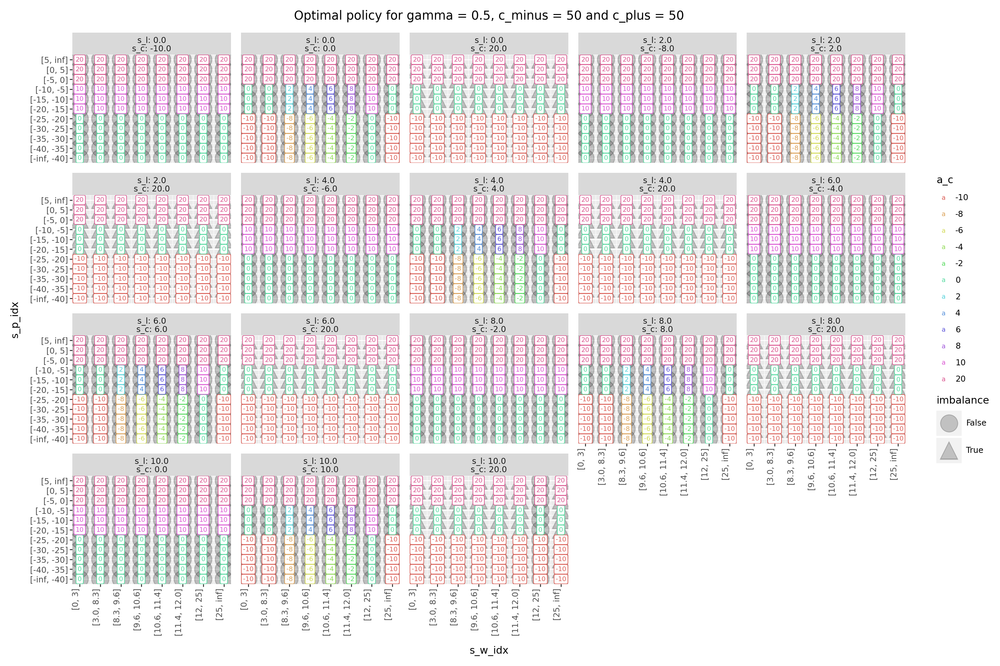

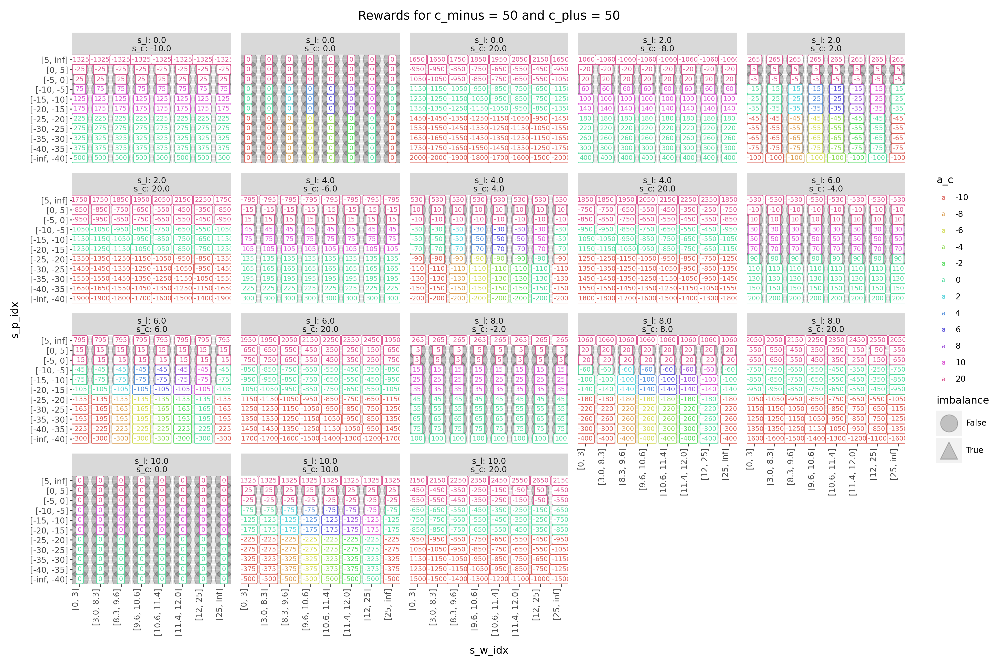

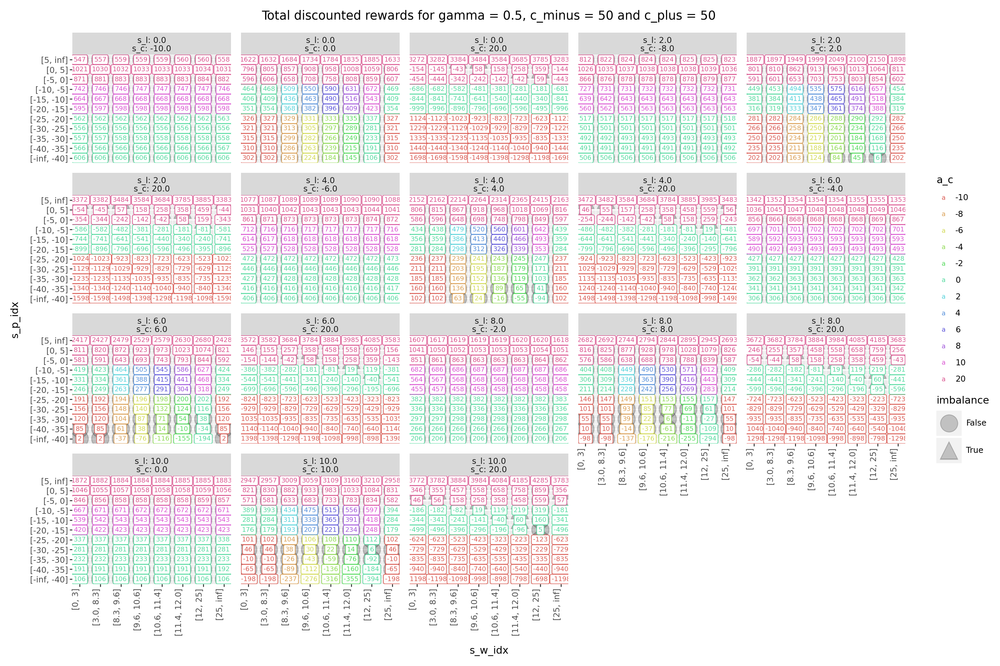

In [ ]:
s_p_inv = generate_intervals(-40, 5, 5, add_inf = True, add_neg_inf = True)
print("New prices:")
pprint(s_p_inv)
mdp, df_result = build_and_solve_mdp(settings, s_l_set, s_c_set, s_w_inv, s_p_inv, a_b_set, a_w_set, a_c_set, 0.5)

## Appendix

Some stuff not need to understand the project

### Model for price transitions




We fit prices using a Random Forest model which is an ensemble of many Decision Trees.

A Random Forest Regressor with $M$ trees makes a prediction at time $t+1$ by averaging the predictions from each individual decision tree.
Let:

* $x_t$ be the input features at time $t$ (e.g. price, hour, weekday, month)
* $f_m(x_t)$ be the prediction from tree $m$, where $m = 1, 2, ..., M$

Then the final prediction is:

$$
\hat{y}_{t+1} = \frac{1}{M} \sum_{m=1}^{M} f_m(x_t)
$$

Each tree partitions the input space using **binary splits** on features:

$$
f_m(x_t) =
\begin{cases}
a_1 & \text{if } x_t \in R_1 \\
a_2 & \text{if } x_t \in R_2 \\
\vdots \\
a_L & \text{if } x_t \in R_L \\
\end{cases},
$$

where

* $R_i$ are the regions (leaf nodes) defined by the tree
* $a_i$ is the average target value of training samples in region $R_i$

So, each tree outputs a constant value based on the region the input falls into.

Each tree is trained on:

* A bootstrap sample (random subset) of training data
* A random subset of features at each split

This reduces overfitting and increases generalization by making trees diverse.

In [ ]:
# AR(1) price Model Fitting and Saving

from google.colab import drive
drive.mount('/content/drive')

import pandas as pd
from statsmodels.tsa.ar_model import AutoReg
import joblib
import gzip

# === Step 1: Load Data ===
url = 'https://drive.google.com/uc?id=1VEgvgipbMJFMeOVsinbGQBFf97GuKuc_'
df = pd.read_csv(url, sep=',')
df["price"] = df["price_eur"]
df["time"] = pd.to_datetime(df["hour_utc"])
df = df.sort_values("time").reset_index(drop=True)
df.set_index('time', inplace=True)

# === Step 2: Prepare Series ===
price_series = df['price'].dropna()

# === Step 3: Fit AR(1) Model ===
model_price = AutoReg(price_series, lags=1, old_names=False)
model_price = model_price.fit()

# === Step 4: Print Summary ===
print(model_price.summary())

# === Step 5: Save Model to File ===
with gzip.open("/content/drive/MyDrive/Colab Notebooks/price_ar1.pkl.gz", "wb") as f:
    joblib.dump(model_price, f)

ValueError: mount failed

In [ ]:
# OLD

# from google.colab import drive
# drive.mount('/content/drive')

# from sklearn.ensemble import RandomForestRegressor
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import mean_squared_error, r2_score
# import joblib
# import gzip

# # Load and preprocess the price dataset file
# # Google Drive direct download URL (using the 'uc?id=' format)

# url = 'https://drive.google.com/uc?id=1VEgvgipbMJFMeOVsinbGQBFf97GuKuc_'
# df = pd.read_csv(url, sep=',')
# summary = df['price_eur'].describe(percentiles=[0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])
# print(summary)

# # Convert price columns
# df["price"] = df["price_eur"]
# df["hour_utc"] = pd.to_datetime(df["hour_utc"])
# df = df.sort_values("hour_utc").reset_index(drop=True)

# # Create target variable
# df["price_t+1"] = df["price"].shift(-1)
# df.dropna(inplace=True)

# # Add seasonality features
# df["hour"] = df["hour_utc"].dt.hour
# df["weekday"] = df["hour_utc"].dt.weekday
# df["month"] = df["hour_utc"].dt.month

# # Define features and target
# X = df[["price", "hour", "weekday", "month"]]
# y = df["price_t+1"]
# X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=False, test_size=0.2)

# # Train model
# model_price = RandomForestRegressor(n_estimators=500, random_state=42)
# model_price.fit(X_train, y_train)

# # Evaluate
# y_pred = model_price.predict(X_test)
# print("MSE:", mean_squared_error(y_test, y_pred))
# print("R² Score:", r2_score(y_test, y_pred))


# # Save model using gzip compression
# with gzip.open("/content/drive/MyDrive/Colab Notebooks/prices_rforest.pkl.gz", "wb") as f:
#     joblib.dump(model_price, f)

### Model for wind transitions

We use a simple AR(1) model here with wind log transformed (since wind speed is only positive)

In [ ]:
#### Getting wind data from metrostat

# !pip install meteostat
# from meteostat import Point, Daily, Hourly, Stations
# from datetime import datetime
# # Find station near Copenhagen
# stations = Stations()
# stations = stations.nearby(56.2188061,11.1659287)
# # stations = stations.hourly()  # Only stations with hourly data
# station = stations.fetch(20)
# print(station)

# # Get hourly data
# start = datetime(2023, 1, 1)
# end = datetime(2025, 1, 7)
# data = Hourly('06060', start, end).fetch()  # karup
# data = data >> mutate(wind = X.wspd) >> select(X.wind)
# # display(data)
# # wind_summary = data['wind'].describe(percentiles=[0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])
# # wind_summary

# # Save data as csv
# data.to_csv("/content/drive/MyDrive/Colab Notebooks/wind_data.csv")

In [ ]:
# === AR(1) Log-Transformed Wind Speed Model Fitting and Saving ===

import pandas as pd
import numpy as np
from statsmodels.tsa.ar_model import AutoReg
import joblib
import gzip

# === Step 1: Load Data ===
url = 'https://drive.google.com/uc?id=1jByLu1DSOmajp-Pfz5n4neAv3nr_Q3Ar'
df_wind = pd.read_csv(url)
df_wind['time'] = pd.to_datetime(df_wind['time'])
df_wind.set_index('time', inplace=True)

# === Step 2: Prepare Series (Log-transform to enforce positivity) ===
wind_series = df_wind['wind'].dropna()
wind_series = wind_series + 0.00000001 # add a small number so no zero wind
if (wind_series <= 0).any():
    raise ValueError("Wind speed contains non-positive values, cannot apply log-transform.")
log_wind_series = np.log(wind_series)

# === Step 3: Fit AR(1) Model on Log-Wind ===
model_wind = AutoReg(log_wind_series, lags=1, old_names=False)
model_wind = model_wind.fit()

# === Step 4: Print Summary ===
print(model_wind.summary())

# === Step 5: Save Model to File ===
output_path = "/content/drive/MyDrive/Colab Notebooks/wind_log_ar1.pkl.gz"
with gzip.open(output_path, "wb") as f:
    joblib.dump(model_wind, f)


# # AR(1) Wind Speed Model Fitting and Saving (no log transf)

# import pandas as pd
# from statsmodels.tsa.ar_model import AutoReg
# import joblib
# import gzip

# # === Step 1: Load Data ===
# url = 'https://drive.google.com/uc?id=1jByLu1DSOmajp-Pfz5n4neAv3nr_Q3Ar'
# df_wind = pd.read_csv(url)
# df_wind['time'] = pd.to_datetime(df_wind['time'])
# df_wind.set_index('time', inplace=True)

# # === Step 2: Prepare Series ===
# wind_series = df_wind['wind'].dropna()

# # === Step 3: Fit AR(1) Model ===
# model_wind = AutoReg(wind_series, lags=1, old_names=False)
# model_wind = model_wind.fit()

# # === Step 4: Print Summary ===
# print(model_wind.summary())

# # === Step 5: Save Model to File ===
# with gzip.open("/content/drive/MyDrive/Colab Notebooks/wind_ar1.pkl.gz", "wb") as f:
#     joblib.dump(model_wind, f)

In [ ]:
# #### Random Forest model (not used)

# import pandas as pd
# from sklearn.ensemble import RandomForestRegressor
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import mean_squared_error, r2_score
# import joblib
# import gzip

# # Load and preprocess the wind dataset file
# # Google Drive direct download URL (using the 'uc?id=' format)
# url = 'https://drive.google.com/uc?id=1jByLu1DSOmajp-Pfz5n4neAv3nr_Q3Ar'
# df = pd.read_csv(url)

# # Convert price columns
# df["time"] = pd.to_datetime(df["time"])
# df = df.sort_values("time").reset_index(drop=True)

# # Create target variable
# df["wind_t+1"] = df["wind"].shift(-1)
# df.dropna(inplace=True)

# # Add seasonality features
# df["hour"] = df["time"].dt.hour
# df["month"] = df["time"].dt.month

# # Define features and target
# X = df[["wind", "hour", "month"]]
# y = df["wind_t+1"]
# X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=False, test_size=0.2)

# # Train model
# model_wind = RandomForestRegressor(n_estimators=500, random_state=42)
# model_wind.fit(X_train, y_train)

# # Evaluate
# y_pred = model_wind.predict(X_test)
# print("MSE:", mean_squared_error(y_test, y_pred))
# print("R² Score:", r2_score(y_test, y_pred))

# # Save model using gzip compression
# with gzip.open("/content/drive/MyDrive/Colab Notebooks/wind_rforest.pkl.gz", "wb") as f:
#     joblib.dump(model_wind, f)

In [ ]:
# #### GradientBoostingRegressor (not used)



# # --- Load your data ---
# df = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/wind_data.csv")
# df['time'] = pd.to_datetime(df['time'])

# # --- Feature engineering ---
# df['hour'] = df['time'].dt.hour
# df['day_of_year'] = df['time'].dt.dayofyear
# df['wind_next'] = df['wind'].shift(-1)
# df = df.dropna()

# # --- Define features and target ---
# features = ['wind', 'hour', 'day_of_year']
# X = df[features]
# y = df['wind_next']

# # --- Train-test split (80/20) ---
# split_index = int(len(df) * 0.8)
# X_train, X_test = X.iloc[:split_index], X.iloc[split_index:]
# y_train, y_test = y.iloc[:split_index], y.iloc[split_index:]

# # --- Train Gradient Boosting quantile regressors ---
# quantile_levels = [i / 10 for i in range(1, 10)]  # 0.1 to 0.9
# quantile_models = {}

# for q in quantile_levels:
#     model_q = GradientBoostingRegressor(
#         loss="quantile",
#         alpha=q,
#         n_estimators=100,
#         random_state=42
#     )
#     model_q.fit(X_train, y_train)
#     quantile_models[q] = model_q

# # --- Probability estimation function ---
# def estimate_wind_probability(current_wind: float, hour: int, day_of_year: int,
#                                interval: Tuple[float, float]) -> float:
#     """
#     Estimate probability that wind at t+1 falls within [lower, upper],
#     given wind at t and seasonal context.

#     Parameters:
#     - current_wind: wind speed at time t
#     - hour: 0–23
#     - day_of_year: 1–365
#     - interval: (lower_bound, upper_bound)

#     Returns:
#     - Estimated probability (0 to 1)
#     """
#     x_input = pd.DataFrame([[current_wind, hour, day_of_year]], columns=['wind', 'hour', 'day_of_year'])
#     q_preds = {q: model.predict(x_input)[0] for q, model in quantile_models.items()}
#     sorted_q = sorted(q_preds.items(), key=lambda x: x[1])

#     lower, upper = interval
#     probs = 0.0

#     for i in range(len(sorted_q) - 1):
#         q_low, v_low = sorted_q[i]
#         q_high, v_high = sorted_q[i + 1]
#         overlap = max(0, min(v_high, upper) - max(v_low, lower))
#         interval_width = v_high - v_low
#         if interval_width > 0 and overlap > 0:
#             probs += (q_high - q_low) * (overlap / interval_width)

#     return round(probs, 3)

# # --- Example usage ---
# example_prob = estimate_wind_probability(current_wind=3.1, hour=10, day_of_year=150, interval=(2.5, 4.5))
# print(f"Estimated probability: {example_prob}")


# # Save model using gzip compression
# with gzip.open("/content/drive/MyDrive/Colab Notebooks/wind_gbr.pkl.gz", "wb") as f:
#     joblib.dump(quantile_models, f)

# import joblib
# import gzip
# import gdown

# # Load the model from the downloaded file
# with gzip.open('/content/drive/MyDrive/Colab Notebooks/wind_gbr.pkl.gz', "rb") as f:
#     model = joblib.load(f)

# import matplotlib.pyplot as plt

# # Define input (current conditions)
# current_wind = 3.1
# hour = 10
# day_of_year = 150
# X_input = pd.DataFrame([[current_wind, hour, day_of_year]], columns=['wind', 'hour', 'day_of_year'])

# # Predict quantiles
# quantiles = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
# quantile_values = [quantile_models[q].predict(X_input)[0] for q in quantiles]

# # Sort values for plotting
# sorted_vals = sorted(zip(quantiles, quantile_values), key=lambda x: x[1])
# probs, values = zip(*sorted_vals)

# # Plot
# plt.figure(figsize=(8, 4))
# plt.plot(values, probs, marker='o', drawstyle='steps-post', label='Quantile CDF')
# plt.xlabel("Predicted Wind Speed at t+1 (m/s)")
# plt.ylabel("Cumulative Probability")
# plt.title("Empirical CDF from Quantile Regression Model")
# plt.grid(True)
# plt.legend()
# plt.tight_layout()
# plt.show()


### Stochastic model for energy production

The current model assumes that energy can be calculated exactly given speed, but even for an hour, the wind speed is not constant and is not known exactly. Assume the expected wind speed for an hour is $\mu$. To sample the actual wind speeds,  we assume that the wind speed is constant for each minute and normally distributed with mean $\mu$ and standard deviation $\sigma$. Then we can calculate the power produced in one hour as the sum of the power generated for each minute:

In [ ]:
def estimate_energy(w, delta = 0.1, samples = 60):
    """
    Estimate the total energy produced by a wind turbine over an hour, given the expected wind speed.

    Parameters:
    - w (float): The expected mean wind speed (in m/s) for the hour.
    - delta (float): The standard deviation factor.
    - samples (int): The number of samples to generate (default minutes).

    Returns:
    - float: The total energy produced over the hour (in MWh).
    """
    # Standard deviation for the normal distribution of wind speeds
    std_dev = w * delta

    # Generate simulated wind speeds for each minute (normally distributed around w)
    wind_speeds = np.random.normal(loc=w, scale=std_dev, size=samples)

    # Calculate the power for each minute based on the simulated wind speeds
    power_outputs = [estimate_power(ws) for ws in wind_speeds]

    # Energy produced (Power * Time).
    energy_per_minute = np.array(power_outputs) * (1 / samples)  # in MWh (megawatt-hours)

    # Total energy produced over the hour
    total_energy = np.sum(energy_per_minute)

    return total_energy  # Total energy produced in MWh

# Example usage:
w = 10  # Expected wind speed in m/s
print("Power/energy given fixed w:", estimate_power(w))
print("Sample of actual energy:", estimate_energy(w))

# Calculate the power for each of the 1000 samples using the estimate_power function
wind_speeds = np.full(1000, w)
energy = [estimate_energy(ws) for ws in wind_speeds]
print("Mean energy", np.mean(energy))

# Create a DataFrame for plotnine
df_energy = pd.DataFrame({
    'energy': energy
})

# Generate the plot using plotnine
plot = (ggplot(df_energy, aes(x='energy'))
        + geom_density()
        + labs(title='Distribution of Energy Produced (1000 Samples)',
               x='Energy Produced (MWh)',
               y='Frequency')
)
plot.show()


def max_energy_level(w, probability = 0.1 , samples = 10000):
    """
    Find the maximum energy level that can be choosen so x% chance for going
        over (actual energy produced below with 1-x procent chance).

    Parameters:
    - w (float): The expected mean wind speed (in m/s) for the hour.
    - probability (float): The probability (e.g., 0.1).
    - samples (int): The number of samples to generate.

    Returns:
    - float: The energy threshold corresponding to the given probability.
    """

    wind_speeds = np.full(samples, w)
    energy_samples = [estimate_energy(ws) for ws in wind_speeds]


    # Sort the energy samples to calculate the cumulative probability
    sorted_energy = np.sort(energy_samples)

    # Find the index that corresponds to the given probability
    index = int(probability * len(sorted_energy))

    # Return the energy threshold that corresponds to the given probability
    return sorted_energy[index]

print("Power/energy given fixed w:", estimate_power(w))
print("Max energy level:", max_energy_level(w))


def probability_below(w, energy_threshold, samples = 10000):
    """
    Calculate the probability that the energy output over one hour is below a given threshold.

    Parameters:
    - w (float): The expected mean wind speed (in m/s) for the hour.
    - energy_threshold (float): The energy threshold (in MWh) to calculate the probability below it.
    - samples (int): The number of samples to generate.

    Returns:
    - float: The probability that the energy output is below the given energy threshold.
    """

    wind_speeds = np.full(samples, w)
    energy_samples = np.array([estimate_energy(ws) for ws in wind_speeds])

    # Calculate the CDF of the energy samples at the given threshold
    cdf_value = np.sum(energy_samples <= energy_threshold) / len(energy_samples)
    return cdf_value

print("Power/energy given fixed w:", estimate_power(w))
print("Max energy level:", max_energy_level(w))
print("Probability of energy below threshold:", probability_below(w, 5))

In [ ]:
import ast

dict_string = "{'name': 'Alice', 'age': 30, 'city': 'New York'}"

try:
    my_dict = ast.literal_eval(dict_string)
    print(type(my_dict))
    print(my_dict)
except (ValueError, SyntaxError) as e:
    print(f"Error converting string to dictionary: {e}")

# Example with double quotes for keys and string values, which is also valid for ast.literal_eval
json_like_string = '{"product": "Laptop", "price": 1200.50, "in_stock": True}'

try:
    my_other_dict = ast.literal_eval(json_like_string)
    print(type(my_other_dict))
    print(my_other_dict)
except (ValueError, SyntaxError) as e:
    print(f"Error converting string to dictionary: {e}")

# If the string is strictly JSON, you can use the json module
import json

json_string = '{"item": "Book", "quantity": 5}'

try:
    json_dict = json.loads(json_string)
    print(type(json_dict))
    print(json_dict)
except json.JSONDecodeError as e:
    print(f"Error decoding JSON string: {e}")

In [ ]:
import numpy as np
from scipy.sparse import csr_matrix
import sys

# Create a large dense matrix with many zeros
dense_matrix = np.zeros((1000, 1000))
dense_matrix[0, 0] = 1
dense_matrix[500, 500] = 2
dense_matrix[999, 999] = 3

# Create a sparse matrix from the dense matrix
sparse_matrix = csr_matrix(dense_matrix)

# Compare memory usage
print(f"Memory usage of dense matrix: {sys.getsizeof(dense_matrix)} bytes")
print(f"Memory usage of sparse matrix: {sys.getsizeof(sparse_matrix)} bytes")

# You can also see the internal representation of the sparse matrix
print("\nSparse matrix internal data:")
print(sparse_matrix)

In [ ]:
import ast

dict_string = "{'name': 'Alice', 'age': 30, 'city': 'New York'}"

try:
    my_dict = ast.literal_eval(dict_string)
    print(type(my_dict))
    print(my_dict)
except (ValueError, SyntaxError) as e:
    print(f"Error converting string to dictionary: {e}")

# Example with double quotes for keys and string values, which is also valid for ast.literal_eval
json_like_string = '{"product": "Laptop", "price": 1200.50, "in_stock": True}'

try:
    my_other_dict = ast.literal_eval(json_like_string)
    print(type(my_other_dict))
    print(my_other_dict)
except (ValueError, SyntaxError) as e:
    print(f"Error converting string to dictionary: {e}")

# If the string is strictly JSON, you can use the json module
import json

json_string = '{"item": "Book", "quantity": 5}'

try:
    json_dict = json.loads(json_string)
    print(type(json_dict))
    print(json_dict)
except json.JSONDecodeError as e:
    print(f"Error decoding JSON string: {e}")

#### State and action space with efficency (more advanced)

- $b^c_e$ Efficiency parameter of charging the battery, e.g. if $b^c_e = 0.95$ then only 95% of the power is stored on the battery.
- $b^d_e$ Efficiency parameter of discharging the battery, e.g. if $b^c_e = 0.95$ then only 95% of the power taken can be used.
- $g_e$ Efficiency parameter of selling to or purchasing from the grid.

We can model the sequential decision problem as MDP. First, let us define the state space for a given period $t$. Let

- $s^l_t$ be the level of energy storaged on the battery at period $t$ (MWh).
- $s^c_t$ be the commitment level for period $t$ (MWh). Note if negative we buy energy from the grid.
- $s^w_t$ is the expected wind speed (m/s),
- $s^p_t$ is the electricity spot prices in period $t$ (EUR). Note may be negative.

<!-- Then the state space of the MDP is $S = L \times C \times W \times P$. -->
Note that

- $s^l_t$ and $s^c_t$ are endogenous variables. That is, the transition over time depends on the actions of the producer.
- $s^w_t$ and $s^p_t$ are exogenous variables, i.e. they are governed by dynamics that do not depend on the endogenous variables.

Next, consider the set of possible actions. Let

- $a^c_t$ be the chosen commitment level for period $t+1$ (MWh).
- $a^b_t$ is chosen level of energy discharged from the battery in period $t$ to the grid (MWh). Note if negative we choose to charge the battery.
- $a^w_t$ is the chosen amount of generated wind energy from the wind power plant (MWh).

<!-- Then $A=C \times B \times W$ is the action space. -->

<!-- Assume that every variable and action is a real number taking only values on a bounded interval of the real line. -->

### State transitions

The dynamics of the stochastic processes are assumed to be known (the transitions probabilities). First, since $s^c_t$ is the current commitment level then for the next period, we have $$s^c_{t+1}=a^c_t.$$

Next, the level of the battery is $$s^l_{t+1}=s^l_t - a^b_t.$$

Finally, the exogenous variables are goverend by two stochastic functions

$$s^w_{t+1}=W(s^w_t),$$

$$s^p_{t+1}=G(s^p_t).$$

<!-- That is the the level of wind in period $t+1$ only depends on the level of wind in period $t$, and the dynamics behave according to a Markovian transition kernel.  -->

### Predetermined actions

Since the producer has to utilize its available energy sources to meet commitments as close as possible. Then the producer must follow rules:

1. First, fulfil commitment as much as possible from wind.
2. Next, if any excess energy from wind charge the battery.
3. Otherwise, try to filfil the remaining commitment by discharging the battery.

Note due to the efficiency loss parameters not all energy can be transfered. Let $x$ denote the energy we need to transfer. Then the energy needed to transfer $x$

- to/from the grid is $x/g_e$,
- to the battery is $x/b_e^c$,
- from the battery is $x/b_e^d$.

Hence, after observing the state variables $s^l_t,s^c_t,s^w_t$ and $s^p_t$, the actions $a^w_t$ and $a^b_t$ are given immediately from the state. That is, both actions are found given the state and should not be optimized. However, the optimal commitment level $a^c_t$ should be found. Below we give descriptions of $a^w_t$ and $a^b_t$.

**Action $a^w_t$**

Hence, after observing the state variables $s^l_t,s^c_t,s^w_t$ and $s^p_t$, the action $a^w_t$ are given by: If commitment is positive (we send to the grid) and commitment greater than or equal the possible energy from wind, then use everything

$$a^w_t = E(s^w_t) \text{ if } s^c_t/g_e \geq 0, s^c_t/g_e \geq E(s^w_t).$$

If commitment is positive (we send to the grid) and commitment is less than the possible energy from wind. Then charge the battery which can recieve either remaining energy $E(s^w_t)-s^c_t/g_e$, or the energy needed to fully charge the  battery $(b^\max-s^l_t)/b^c_e$. That is,

$$a^w_t = s^c_t/g_e + \min\{(b^\max-s^l_t)/b^c_e, E(s^w_t)-s^c_t/g_e\}, \text{ if } s^c_t/g_e \geq 0, s^c_t/g_e < E(s^w_t).$$

If commitment is negative (we transfer from the grid). Then we charge the battery with the avaliable amount of wind energy (here we assume that we first use wind and next from the grid).

$$a^w_t = \min\{(b^\max-s^l_t)/b^c_e, E(s^w_t)\} \text{ if } s^c_t/g_e < 0$$

**Action $a^b_t$**

Similar for the action $a^b_t$, if commitment is positive (we send to the grid) and commitment greater than or equal the possible energy from wind, then we discarge the battery, either fully or with the remaining energy needed $(s^c_t/g_e-E(s^w_t))/b^d_e$

$$a^b_t = \min\{s^l_t, (s^c_t/g_e-E(s^w_t))/b^d_e \} \text{ if } s^c_t/g_e \geq 0, s^c_t/g_e \geq E(s^w_t).$$

If commitment is positive (we send to the grid) and commitment is less than the possible energy from wind. Then charge the battery which can recieve either remaining energy $E(s^w_t)-s^c_t/g_e$, or the energy needed to fully charge the  battery $(b^\max-s^l_t)/b^c_e$. That is,

$$a^b_t = - \min\{(b^\max-s^l_t)/b^c_e, E(s^w_t)-s^c_t/g_e\}, \text{ if } s^c_t/g_e \geq 0, s^c_t/g_e < E(s^w_t).$$

If commitment is negative (we transfer from the grid). Then we charge the battery with the avaliable amount of wind energy and next the commmitment.

$$a^b_t = - \min\{(b^\max-s^l_t)/b^c_e, (E(s^w_t) + g_e s^c_t)/b^c_e \} \text{ if } s^c_t/g_e < 0$$

# Old stuff (not used)

In [ ]:
# OLD stuff

class BuildMDPModel:
  """
  A class to build a Markov Decision Process (MDP) model.

  This class provides a structured way to define the states, actions,
  transition probabilities, and rewards of an MDP, making it easier to
  construct models for use with MDP solving libraries.

  Attributes:
      state_labels (dict): A dictionary mapping state labels to indices.
      action_labels (dict): A dictionary mapping action labels to indices.
      state_index (dict): A dictionary mapping state indices to labels.
      action_index (dict): A dictionary mapping action indices to labels.
      NUM_STATES (int): The total number of states in the MDP.
      NUM_ACTIONS (int): The total number of actions in the MDP.
      p_mat (list): A list of transition probability matrices, one for each action.
      r_mat (ndarray): The reward matrix, with rows for states and columns for actions.
      high_neg_reward (int): A large negative reward used to represent illegal actions.
  """

  def __init__(self, state_labels, action_labels, high_neg_reward = -1000):
    """
    Initializes the BuildMDPModel. All actions are set to illegal in all states from start.

    Args:
        state_labels (list): A list of labels for the states.
        action_labels (list): A list of labels for the actions.
        high_neg_reward (int, optional): A large negative reward for illegal actions.
                                         Defaults to -1000.
    """
    self.state_labels = {str(label): index for index, label in enumerate(state_labels)}
    self.action_labels = {str(label): index for index, label in enumerate(action_labels)}
    self.state_index = {index: str(label) for index, label in enumerate(state_labels)}
    self.action_index = {index: str(label) for index, label in enumerate(action_labels)}
    self.NUM_STATES = len(state_labels)
    self.NUM_ACTIONS = len(action_labels)
    self.p_mat = [csr_matrix((self.NUM_STATES, self.NUM_STATES)) for _ in range(self.NUM_ACTIONS)]
    self.r_mat = csr_matrix((self.NUM_STATES, self.NUM_ACTIONS))
    self.high_neg_reward = high_neg_reward

    # set everthing to a illigal action
    for a in range(self.NUM_ACTIONS):
      for s in range(self.NUM_STATES):
        self.p_mat[a][s, s] = 1.0
        self.r_mat[s, a] = self.high_neg_reward

  def get_si(self, s_labels):
    """
    Gets the numerical indices for a list of state labels.

    Args:
        s_labels (list): A list of state labels.

    Returns:
        list: A list of corresponding state indices.
    """
    values = [self.state_labels[key] for key in s_labels]
    return values

  def get_sv(self, s_index):
    """
    Gets the state labels for a list of numerical state indices.

    Args:
        s_index (list): A list of state indices.

    Returns:
        list: A list of corresponding state labels.
    """
    values = [self.state_index.get(key) for key in s_index]
    return values

  def get_ai(self, a_labels):
    """
    Gets the numerical indices for a list of action labels.

    Args:
        a_labels (list): A list of action labels.

    Returns:
        list: A list of corresponding action indices.
    """
    values = [self.action_labels.get(key) for key in a_labels]
    return values

  def get_av(self, a_index):
    """
    Gets the action labels for a list of numerical action indices.

    Args:
        a_index (list): A list of action indices.

    Returns:
        list: A list of corresponding action labels.
    """
    values = [self.action_index.get(key) for key in a_index]
    return values

  def get_states(self):
    """
    Gets all state labels.

    Returns:
        tuple: A tuple of all state labels.
    """
    return tuple(self.state_labels.keys())

  def get_actions(self):
    """
    Gets all action labels.

    Returns:
        tuple: A tuple of all action labels.
    """
    return tuple(self.action_labels.keys())

  def set_illigal_action(self, s_l, a_l):
    """
    Marks an action as illegal in a specific state.

    Args:
        s_l (str): The label of the state.
        a_l (str): The label of the action.
    """
    s = self.get_si([s_l])[0]
    a = self.get_ai([a_l])[0]
    self.p_mat[a][s, s] = 1.0 # dummy transpr
    self.r_mat[s, a] = self.high_neg_reward # high negative reward for dummy actions

  def reset_trans_pr(self, s_l, a_l):
    """
    Resets the transition probabilities for a specific state-action pair to zero.

    Args:
        s_l (str): The label of the state.
        a_l (str): The label of the action.
    """
    s = self.get_si([s_l])[0]
    a = self.get_ai([a_l])[0]
    self.p_mat[a][s, :] = 0

  def add_trans_pr(self, s_l, a_l, s_next_l, pr):
    """
    Adds a transition probability for a specific state-action-next state transition.

    Args:
        s_l (str): The label of the current state.
        a_l (str): The label of the action taken.
        s_next_l (str): The label of the next state.
        pr (float): The transition probability.
    """
    s = self.get_si([s_l])[0]
    a = self.get_ai([a_l])[0]
    s_next = self.get_si([s_next_l])[0]
    # print(f"s: {s} s_l: {s_l} s_next: {s_next} s_next_l: {s_next_l} a: {a} a_l: {a_l} pr: {pr}")
    self.p_mat[a][s, s_next] = pr

  def add_reward(self, s_l, a_l, reward):
    """
    Sets the reward for a specific state-action pair.

    Args:
        s_l (str): The label of the state.
        a_l (str): The label of the action.
        reward (float): The reward value.
    """
    s = self.get_si([s_l])[0]
    a = self.get_ai([a_l])[0]
    self.r_mat[s, a] = reward

  def set_action(self, s_l, a_l, reward, pr):
    """
    Sets the reward and transition probabilities for a specific state-action pair.

    Args:
        s_l (str): The label of the state.
        a_l (str): The label of the action.
        reward (float): The reward value.
        pr (dict): A dictionary mapping next state labels to their probabilities.
    """
    s = self.get_si([s_l])[0]
    a = self.get_ai([a_l])[0]
    # print(f"s: {s} s_l: {s_l} a: {a} a_l: {a_l} reward: {reward} trans pr: {pr}")
    self.p_mat[a][s,:] = 0  # reset trans pr
    self.r_mat[s, a] = reward
    for s_next_l, pr in pr.items():
    #   print(f"s_next_l: {s_next_l} pr: {pr}")
      if pr > 0:
        self.add_trans_pr(s_l, a_l, s_next_l, pr)
        # print(self.p_mat[a][s,:])


  def check(self):
    """
    Performs checks on the built MDP model.

    Verifies that transition probabilities sum to approximately 1.0 for each
    state-action pair and checks for rewards less than the high_neg_reward.
    """
    # Check if row sums of all matrices in p_mat equal 1
    for a_index, p_matrix in enumerate(self.p_mat):
      for s_index in range(self.NUM_STATES):
        row_sum = np.sum(p_matrix[s_index, :])
        absdiff = np.abs(row_sum - 1)
        if absdiff >= 10*np.spacing(np.float64(1)):
          s_l = next((k for k, v in self.state_labels.items() if v == s_index), None)
          a_l = next((k for k, v in self.action_labels.items() if v == a_index), None)
          print(f"Warning: Transition probabilities for action '{a_l}' (index {a_index}) in state {s_l} (index {s_index}) do not sum to 1.0. Row sum is: {row_sum}")
    # Check if all costs are greater than high_neg_reward
    if self.r_mat.min() < self.high_neg_reward:
      print(f"Warning: Some costs are less than {self.high_neg_reward}!")

  def get_mdp(self):
    """
    Gets the transition probability matrices and reward matrix.

    Returns:
        tuple: A tuple containing:
            p_mat (list): List of transition probability matrices.
            r_mat (ndarray): Reward matrix.
    """
    return self.p_mat, self.r_mat

  def get_action_info(self, s_l, a_l):
    """
    Gets information about a specific state-action pair.

    Args:
        s_l (str): The label of the state.
        a_l (str): The label of the action.

    Returns:
        tuple: A tuple containing:
            s (int): The numerical index of the state.
            a (int): The numerical index of the action.
            r (float): The reward for the state-action pair.
            pr (ndarray): The transition probability distribution for the state-action pair.
    """
    s = self.get_si([s_l])[0]
    a = self.get_ai([a_l])[0]
    return s, a, self.r_mat[s, a], self.p_mat[a][s,:]

  def get_state_info(self, s_l):
    """
    Gets information about a specific state.

    Args:
        s_l (str): The label of the state.

    Returns:
        tuple: A tuple containing:
            s (int): The numerical index of the state.
            r_dict (dict): A dictionary of valid actions and their rewards in the state.
            a_dict (dict): A dictionary of valid actions and their transition
                           probability distributions to next states.
    """
    s = self.get_si([s_l])[0]
    r_dict = dict(zip(self.get_actions(), self.r_mat[s, :]))
    r_dict = {key: value for key, value in r_dict.items() if value != self.high_neg_reward}
    a_dict = {}
    for a_l, a in self.action_labels.items():
      if self.r_mat[s, a] > self.high_neg_reward:
        pr_dict = {}
        for s_next_l, s_next in self.state_labels.items():
          if self.p_mat[a][s, s_next] > 0:
            pr_dict[s_next_l] = self.p_mat[a][s, s_next]
          if pr_dict: a_dict[a_l] = pr_dict
    return s, r_dict, a_dict

### Price G(p)

The model can be loaded using:

In [ ]:
# Google Drive direct download URL (using the 'uc?id=' format)
url = 'https://drive.google.com/uc?id=1cGhte06iiWZnaRLPyj5D8ZzWX7gqPsIR'

# Output filename for the downloaded file
output_filename = 'prices_ar1.pkl.gz'

# Download the file from Google Drive
gdown.download(url, output_filename, quiet=True)

# Load the model from the downloaded file
with gzip.open(output_filename, "rb") as f:
    model_price = joblib.load(f)

print(f"Model loaded successfully from {output_filename}")

We can now predict the price given hour, day and month:

In [ ]:
# Example
price = 100
phi = model_price.params.iloc[1]      # lag coefficient
intercept = model_price.params.iloc[0]    # intercept
price_next = intercept + phi * price
print(f"Latest price: {price:.2f} EUR")
print(f"Predicted (mean) next hour price: {price_next:.2f} EUR")

Note the function is stochastic and we may get a sample using:

In [ ]:
# def get_price_sample(model, input_dict: dict, n_samples = 1):
#     """
#     Draws random sample(s) from a RandomForestRegressor for a given input dictionary.

#     Parameters:
#         model (RandomForestRegressor): Trained random forest model.
#         input_dict (dict): Feature values as a dictionary (e.g., {'price_eur': 40, 'hour': 14, 'dow': 1}).
#         n_samples (int): Number of samples to draw.

#     Returns:
#         np.ndarray: Array of sampled predictions.
#     """
#     # Convert input dict to single-row DataFrame
#     input = pd.DataFrame([input_dict])

#     # Get predictions from each tree
#     with warnings.catch_warnings():
#         warnings.filterwarnings("ignore", category=UserWarning, module='sklearn')
#         tree_preds = [tree.predict(input)[0] for tree in model.estimators_]

#     # Sample from tree predictions
#     return np.random.choice(tree_preds, size=n_samples, replace=True)

# # Input features as a dictionary
# input = {
#     "price": 100, # EUR/MWh
#     "hour": 20,
#     "weekday": 2,  # Wednesday (Mon = 0)
#     "month": 7     # July
# }

# # Get a random sample from the forest
# sample = get_price_sample(model_price, input)
# print("Sampled price:", sample[0])

# # Or get many samples to visualize the distribution
# samples = get_price_sample(model_price, input, n_samples=100000)
# df_samples = pd.DataFrame({'prediction': samples})

# # Create histogram plot using plotnine
# plot = (
#     ggplot(df_samples, aes(x='prediction')) +
#     geom_histogram(bins=10, fill='skyblue', color='black', alpha=0.7) +
#     geom_vline(xintercept=np.percentile(samples, 10), linetype='dashed', color='gray') +
#     geom_vline(xintercept=np.percentile(samples, 50), linetype='dashed', color='blue') +
#     geom_vline(xintercept=np.percentile(samples, 90), linetype='dashed', color='gray') +
#     labs(
#         title='Sample Prediction Distribution',
#         x='Predicted Price (EUR/MWh)',
#         y='Count'
#     ) +
#     theme_minimal()
# )
# plot.show()


 Moreover, the probability that the price falls within a given interval given current price can be found:

In [ ]:
# def get_price_prob_interval(model, input_data: dict, interval: tuple) -> float:
#     """
#     Estimates the probability that the predicted price at t+1 falls within a given interval.

#     Parameters:
#     - model: Trained model
#     - input_data: dict with keys "price", "hour", "weekday", "month"
#     - interval: tuple (lower_bound, upper_bound)

#     Returns:
#     - Probability (float) that prediction is within the interval
#     """
#     # Convert input_data to a DataFrame
#     input_df = pd.DataFrame([input_data])

#     # Get individual predictions from all trees
#     all_tree_preds = []
#     with warnings.catch_warnings():
#         warnings.filterwarnings("ignore", category=UserWarning, module='sklearn')
#         for tree in model.estimators_:
#             all_tree_preds.append(tree.predict(input_df)[0])

#     all_tree_preds = np.array(all_tree_preds)

#     # Calculate probability that prediction falls within the interval
#     lower, upper = interval
#     within_bounds = np.logical_and(all_tree_preds >= lower, all_tree_preds <= upper)
#     probability = np.mean(within_bounds)

#     return probability

# # Example usage:
# example_input = {
#     "price": -100.0,
#     "hour": 14,
#     "weekday": 2,  # Wednesday
#     "month": 7     # July
# }

# example_interval = (-180, -5)
# example_probability = get_price_prob_interval(model_price, example_input, example_interval)
# print("Probability for price in interval for the next hour:", example_probability)

In [ ]:
import numpy as np
from scipy.stats import norm
from scipy.integrate import quad


def get_price_pr_inv(model, a, b, c, d):
    """
    Compute the conditional probability that W_{t+1} ∈ [a, b] given W_t ∈ [c, d]
    for a stationary AR(1) process with intercept.

    AR(1) Model:
        W_{t+1} = alpha + phi * W_t + epsilon_t
        where epsilon_t ~ N(0, sigma^2)

    Stationarity:
        The AR(1) process is considered stationary if the autoregressive coefficient satisfies:
            |phi| < 1

        Under stationarity:
            - The mean of W_t is constant over time: E[W_t] = mu = alpha / (1 - phi)
            - The variance of W_t is constant: Var(W_t) = sigma^2 / (1 - phi^2)
            - The process fluctuates around a stable long-term mean rather than trending or diverging

    Parameters:
        phi (float): AR(1) coefficient (must satisfy |phi| < 1 for stationarity)
        alpha (float): Intercept term in the AR(1) model
        sigma (float): Standard deviation of the noise term epsilon_t
        a (float): Lower bound of target interval for W_{t+1}
        b (float): Upper bound of target interval for W_{t+1}
        c (float): Lower bound of conditioning interval for W_t
        d (float): Upper bound of conditioning interval for W_t

    Returns:
        float: Conditional probability P(a ≤ W_{t+1} ≤ b | c ≤ W_t ≤ d)
    """
    phi = model.params.iloc[1]      # lag coefficient
    alpha = model.params.iloc[0]    # intercept
    sigma = model.resid.std()   # residual standard deviation

    # Long-run mean and stationary variance
    mu = alpha / (1 - phi)
    sigma_w = sigma / np.sqrt(1 - phi**2)

    def marginal_pdf_w(w):
        """PDF of stationary W_t ~ N(mu, sigma_w^2)."""
        return norm.pdf(w, loc=mu, scale=sigma_w)

    def integrand(w):
        """Integrand: conditional probability * marginal density."""
        mean_t1 = alpha + phi * w
        p = norm.cdf(b, loc=mean_t1, scale=sigma) - norm.cdf(a, loc=mean_t1, scale=sigma)
        return p * marginal_pdf_w(w)

    # Marginal probability P(c ≤ W_t ≤ d)
    p_wt_interval = norm.cdf(d, loc=mu, scale=sigma_w) - norm.cdf(c, loc=mu, scale=sigma_w)

    # Numerical integration over W_t in [c, d]
    integral_result, _ = quad(integrand, c, d)

    return integral_result / p_wt_interval

get_price_pr_inv(model_price, 0, 8, 3, 4)

### Wind W(x)

The model is fitted using AR(1) on log(wind speed) (since cannot be negative) and can be loaded using:

In [ ]:
# Google Drive direct download URL (using the 'uc?id=' format)
url = 'https://drive.google.com/uc?id=1TJ1ACzev40QbeUlXBbDicYU3kEyiH1nB'

# Output filename for the downloaded file
output_filename = 'wind_log_ar1.pkl.gz'

# Download the file from Google Drive
gdown.download(url, output_filename, quiet=True)

# Load the model from the downloaded file
with gzip.open(output_filename, "rb") as f:
    model_wind = joblib.load(f)

print(f"Model loaded successfully from {output_filename}")

We can now predict the price given hour, day and month:

In [ ]:
# Example input: current price and time features
# Replace with actual values
wind = 0.000001
log_wind = np.log(wind)
phi = model_wind.params['wind.L1'] # Access params from wind_result
intercept = model_wind.params['const'] # Access params from wind_result
log_wind_next = intercept + phi * log_wind
wind_next = np.exp(log_wind_next)

print(f"Latest wind speed: {wind:.2f} m/s")
print(f"Predicted (mean) next hour wind speed: {wind_next:.2f} m/s")

In [ ]:
# def get_wind_sample(model, wind: float) -> float:
#     """
#     Generate a random sample for the next hour's wind speed
#     using a fitted log-transformed AR(1) model and the current wind speed.

#     The model is trained on log(wind), so this function:
#         - Applies log to the input wind speed
#         - Computes the mean and std dev in log-space
#         - Draws a sample in log-space
#         - Transforms the result back to wind speed units

#     Parameters:
#         wind (float): Current wind speed in m/s (must be > 0)
#         model: A fitted AutoRegResults object (AR(1) on log(wind))

#     Returns:
#         float: A randomly sampled wind speed for the next hour.
#     """
#     if wind <= 0:
#         raise ValueError("Wind speed must be positive for log-transformed model.")

#     # Extract model parameters
#     phi = model.params.iloc[1]      # lag coefficient
#     intercept = model.params.iloc[0]  # intercept
#     resid_std = model.resid.std()   # residual standard deviation

#     # Predict mean in log-space
#     log_wind = np.log(wind)
#     mean_log_next = intercept + phi * log_wind

#     # Sample from log-normal distribution
#     sampled_log = np.random.normal(loc=mean_log_next, scale=resid_std)
#     sampled_wind = np.exp(sampled_log)

#     return sampled_wind

# # Get a random sample from the AR(1) wind model
# wind = 10
# sample = get_wind_sample(model_wind, wind)
# print("Sampled wind:", sample)

 Moreover, the probability that the price falls within a given interval given current price is within an interval can be found:

In [ ]:
# from scipy.stats import lognorm
# import numpy as np


# def get_wind_prob_interval(model, wind: float, interval: tuple) -> float:
#     """
#     Estimate the probability that the predicted wind speed at t+1
#     falls within a specified interval, using a log-transformed AR(1) model.

#     The AR(1) model is trained on log(wind), so predictions are made
#     in log-space and transformed back using a log-normal distribution.

#     Parameters:
#         model: Fitted AutoRegResults object (log-AR(1) model)
#         wind (float): Current wind speed at time t (must be > 0)
#         interval (tuple): (lower_bound, upper_bound) in m/s (must be > 0)

#     Returns:
#         float: Estimated probability that W_{t+1} ∈ [lower_bound, upper_bound]
#     """
#     lower, upper = interval

#     if wind <= 0 or lower <= 0 or upper <= 0:
#         raise ValueError("Wind speed and interval bounds must be strictly positive.")

#     # Extract model parameters
#     phi = model.params.iloc[1]      # lag coefficient
#     intercept = model.params.iloc[0]  # intercept
#     resid_std = model.resid.std()   # residual standard deviation

#     # Compute predicted log-mean for W_{t+1}
#     log_w_t = np.log(wind)
#     mu_log = intercept + phi * log_w_t

#     # Estimate probability using log-normal CDF
#     prob = lognorm.cdf(upper, s=resid_std, scale=np.exp(mu_log)) - \
#            lognorm.cdf(lower, s=resid_std, scale=np.exp(mu_log))

#     return prob

# example_interval = (3, 8)
# example_probability = get_wind_prob_interval(model_wind, 10, example_interval)
# print("Probability for wind in interval for the next hour:", example_probability)

Finally, the that the price falls within a given interval given an current price interval can be found:

In [ ]:
import numpy as np
from scipy.stats import norm, lognorm
from scipy.integrate import quad


def get_wind_pr_inv(model, a, b, c, d):
    """
    Compute the conditional probability:
        P(a ≤ W_{t+1} ≤ b | c ≤ W_t ≤ d)
    under a log-normal AR(1) model with intercept:
        log(W_{t+1}) = alpha + phi * log(W_t) + epsilon_t,
        where epsilon_t ~ N(0, sigma^2)

    This transformation ensures W_t > 0 and W_{t+1} > 0.

    Parameters:
        model: Fitted AutoRegResults object (log-AR(1) model)
        a (float): Lower bound of target interval for W_{t+1} (must be > 0)
        b (float): Upper bound of target interval for W_{t+1} (must be > a)
        c (float): Lower bound of conditioning interval for W_t (must be > 0)
        d (float): Upper bound of conditioning interval for W_t

    Returns:
        float: Conditional probability P(a ≤ W_{t+1} ≤ b | c ≤ W_t ≤ d)
    """
    # if a <= 0 or b <= 0 or c <= 0 or d <= 0:
    #     raise ValueError("All bounds must be strictly positive for log-normal model.")
    eps = 0.0001
    if a == 0: a = eps
    if b == 0: b = eps
    if c == 0: c = eps
    if d == 0: d = eps
    if a > b or c > d:
        raise ValueError("Invalid interval bounds.")

    # Extract model parameters
    phi = model.params.iloc[1]      # lag coefficient
    alpha = model.params.iloc[0]    # intercept
    sigma = model.resid.std()   # residual standard deviation

    # PDF of W_t under stationary distribution (assumed log-normal)
    # Approximate log(W_t) ~ N(mu, sigma_w^2) where mu = alpha / (1 - phi)
    mu_log = alpha / (1 - phi)
    sigma_log = sigma / np.sqrt(1 - phi**2)

    def marginal_pdf_w(w):
        """PDF of W_t under stationary log-normal assumption."""
        return lognorm.pdf(w, s=sigma_log, scale=np.exp(mu_log))

    def conditional_prob(w):
        """P(a ≤ W_{t+1} ≤ b | W_t = w) × f(W_t)"""
        if w <= 0:
            return 0.0
        mu = alpha + phi * np.log(w)
        p = lognorm.cdf(b, s=sigma, scale=np.exp(mu)) - lognorm.cdf(a, s=sigma, scale=np.exp(mu))
        return p * marginal_pdf_w(w)

    # Normalize over W_t ∈ [c, d]
    norm_const, _ = quad(marginal_pdf_w, c, d)
    integral_val, _ = quad(conditional_prob, c, d)

    return integral_val / norm_const

get_wind_pr_inv(model_wind, 0.001, 8, 3, 4)

In [ ]:
np.sqrt(np.log(2) / (0.0001))